In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install pydotplus

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install keras-tuner

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.1/176.1 kB 7.8 MB/s eta 0:00:00


In [ ]:
#Importing the Libraries

import pandas as pd
import numpy as np
import seaborn as sns
from collections import Counter
import matplotlib.pyplot as plt
import plotly
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder,MinMaxScaler,RobustScaler,FunctionTransformer
from sklearn.datasets import load_iris,load_diabetes
from sklearn.model_selection import train_test_split,GridSearchCV
import pandas as pd
import numpy as np
from sklearn.linear_model import LogisticRegression
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
import xgboost as xgb
import matplotlib.pyplot as plt
import seaborn as sns
import pickle 
import keras
from keras.models import Sequential
from keras.layers import Dense,Dropout,BatchNormalization
from keras.optimizers import Adam
import keras_tuner as kt
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler,FunctionTransformer,PowerTransformer
import tensorflow
from sklearn.impute import KNNImputer
import missingno
from tensorflow import keras
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense,Flatten
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
import graphviz
import pydotplus

In [ ]:
from sklearn import set_config
set_config(display='diagram')

In [ ]:
pip install tensorflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
pip install keras

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project_data.csv')

In [ ]:
print(data.shape)

(500000, 47)


### Dropping the Duplicate rows(if it exists from the dataframe)

In [ ]:
data=data.drop_duplicates()

In [ ]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 500000 entries, 0 to 499999
Data columns (total 47 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   ID                     500000 non-null  object 
 1   Severity               500000 non-null  int64  
 2   Start_Time             500000 non-null  object 
 3   End_Time               500000 non-null  object 
 4   Start_Lat              500000 non-null  float64
 5   Start_Lng              500000 non-null  float64
 6   End_Lat                500000 non-null  float64
 7   End_Lng                500000 non-null  float64
 8   Distance(mi)           500000 non-null  float64
 9   Description            500000 non-null  object 
 10  Number                 174323 non-null  float64
 11  Street                 500000 non-null  object 
 12  Side                   500000 non-null  object 
 13  City                   499965 non-null  object 
 14  County                 500000 non-nu

In [ ]:
def conitnuous_columns_univariate(column_name):
    '''
    Univariate Analysis for numerical column
    '''
    print(f'Column {column_name} has following description : ')
    print()
    print(data[column_name].describe())
    print()
    fig,axs=plt.subplots(ncols=2,figsize=(12,4))
    hist=sns.histplot(data=data,x=column_name,kde=True,ax=axs[0])
    axs[0].set_title(f"Histogram for {column_name}")
    sns.boxplot(data=data,x=column_name,ax=axs[1])
    axs[1].set_title(f"Boxplot for {column_name}")
    print()
    print(f'{column_name} has skew={data[column_name].skew()}')
    print()
    plt.show()

Column Start_Lat has following description : 

count    500000.000000
mean         36.226871
std           5.274017
min          24.570087
25%          33.340476
50%          36.140684
75%          40.237245
max          49.000580
Name: Start_Lat, dtype: float64


Start_Lat has skew=-0.14624093235873503



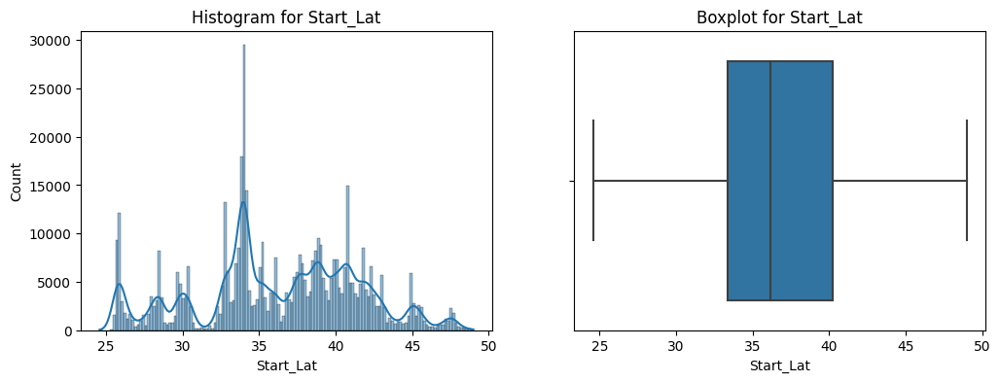

In [ ]:
conitnuous_columns_univariate('Start_Lat')

Column Start_Lng has following description : 

count    500000.000000
mean        -95.291116
std          17.780508
min        -124.548074
25%        -117.494958
50%         -88.006000
75%         -80.324057
max         -67.113167
Name: Start_Lng, dtype: float64


Start_Lng has skew=-0.4126805805754043



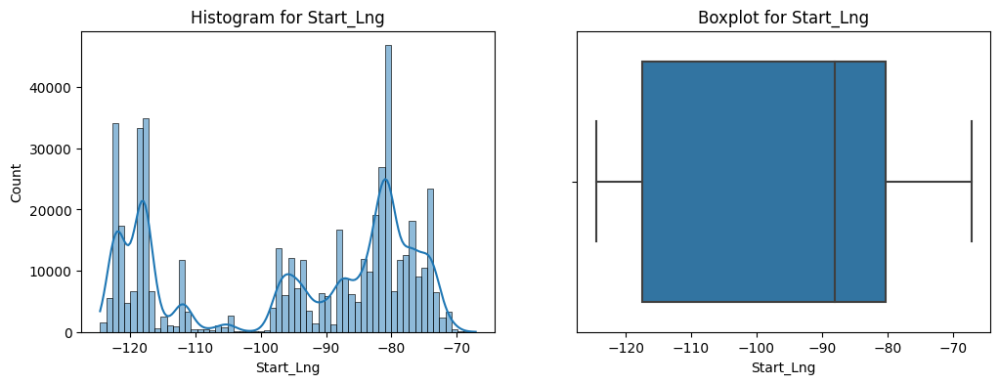

In [ ]:
conitnuous_columns_univariate('Start_Lng')

Column End_Lat has following description : 

count    500000.000000
mean         36.227005
std           5.274199
min          24.570107
25%          33.341552
50%          36.140720
75%          40.237539
max          49.075000
Name: End_Lat, dtype: float64


End_Lat has skew=-0.1462181697019565



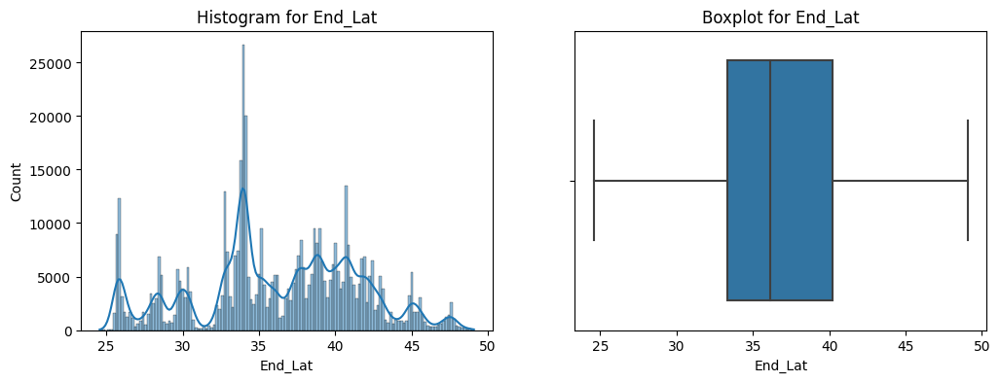

In [ ]:
conitnuous_columns_univariate('End_Lat')

Column End_Lng has following description : 

count    500000.000000
mean        -95.290835
std          17.780372
min        -124.545748
25%        -117.493557
50%         -88.006457
75%         -80.323756
max         -67.109242
Name: End_Lng, dtype: float64


End_Lng has skew=-0.4126863482526113



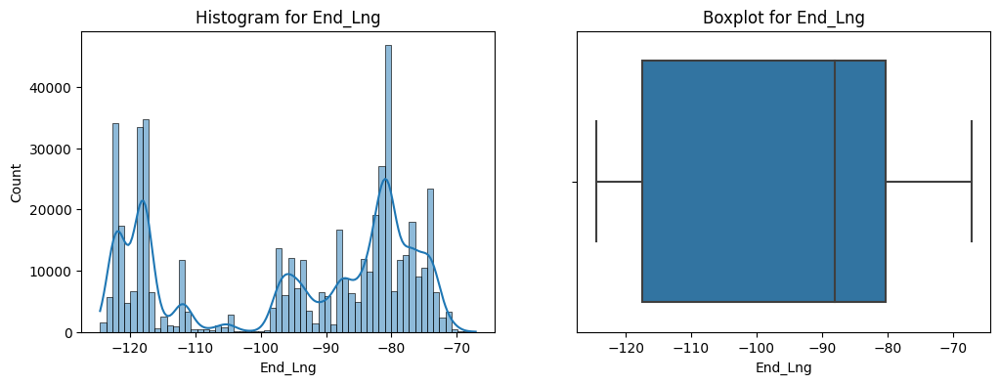

In [ ]:
conitnuous_columns_univariate('End_Lng')

Column Distance(mi) has following description : 

count    500000.000000
mean          0.786740
std           1.596328
min           0.000000
25%           0.114000
50%           0.363000
75%           0.821000
max         151.525000
Name: Distance(mi), dtype: float64


Distance(mi) has skew=15.567616917145584



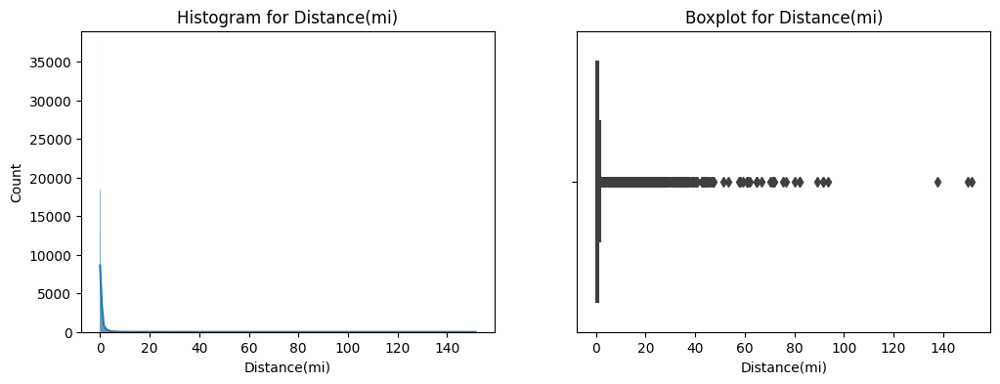

In [ ]:
conitnuous_columns_univariate('Distance(mi)')

Column Number has following description : 

count    174323.000000
mean       7340.673789
std       14481.553909
min           1.000000
25%        1201.000000
50%        3845.000000
75%        9002.000000
max      961051.000000
Name: Number, dtype: float64


Number has skew=19.5050873565759



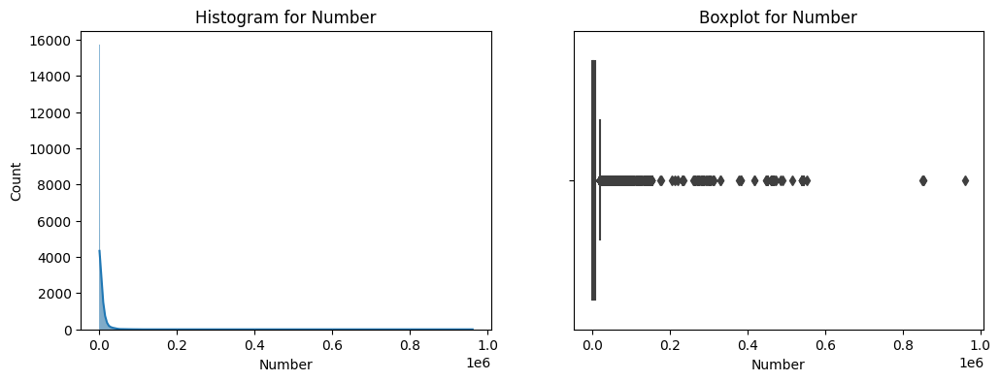

In [ ]:
conitnuous_columns_univariate('Number')

Column Temperature(F) has following description : 

count    489463.000000
mean         65.152592
std          17.700727
min         -22.000000
25%          54.000000
50%          67.000000
75%          78.100000
max         196.000000
Name: Temperature(F), dtype: float64


Temperature(F) has skew=-0.5974626186036305



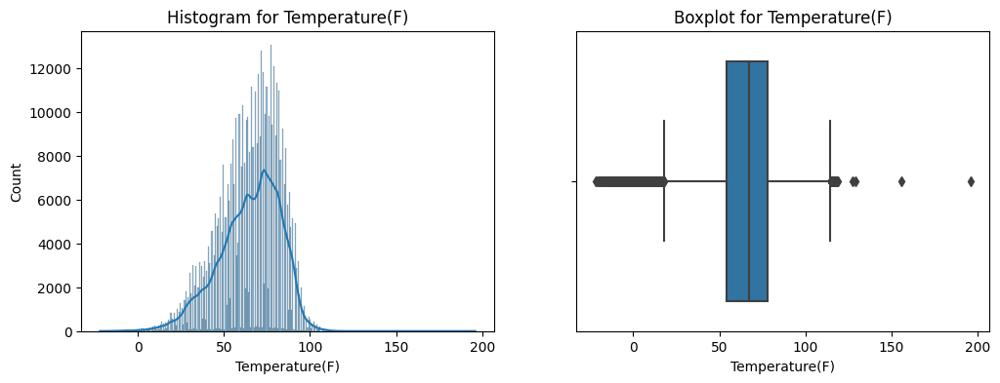

In [ ]:
conitnuous_columns_univariate('Temperature(F)')

Column Wind_Chill(F) has following description : 

count    300816.000000
mean         61.397241
std          21.690477
min         -44.000000
25%          48.000000
50%          66.000000
75%          78.000000
max         196.000000
Name: Wind_Chill(F), dtype: float64


Wind_Chill(F) has skew=-0.7472096081034233



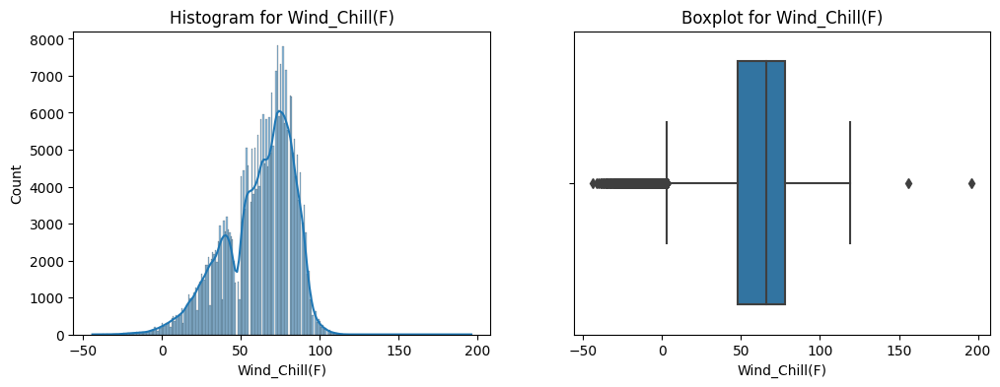

In [ ]:
conitnuous_columns_univariate('Wind_Chill(F)')

Column Humidity(%) has following description : 

count    488953.000000
mean         63.541801
std          22.464184
min           1.000000
25%          48.000000
50%          65.000000
75%          82.000000
max         100.000000
Name: Humidity(%), dtype: float64


Humidity(%) has skew=-0.3434714887300856



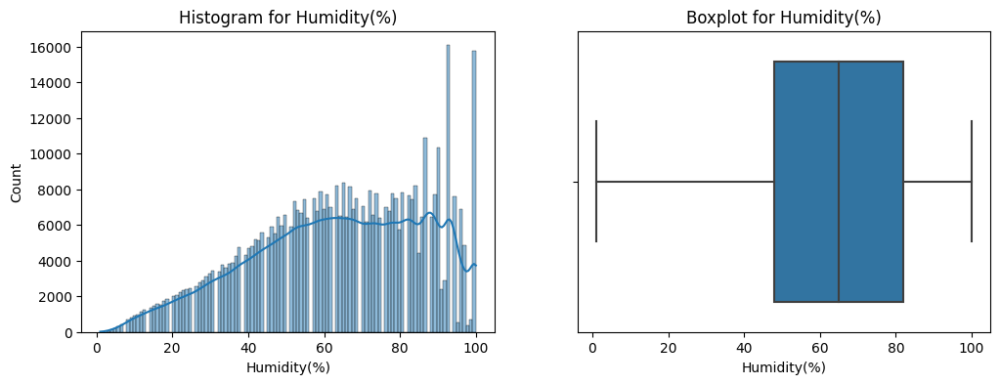

In [ ]:
conitnuous_columns_univariate('Humidity(%)')

Column Pressure(in) has following description : 

count    491174.000000
mean         29.654506
std           0.882856
min           0.020000
25%          29.610000
50%          29.910000
75%          30.050000
max          56.540000
Name: Pressure(in), dtype: float64


Pressure(in) has skew=-4.225031880602016



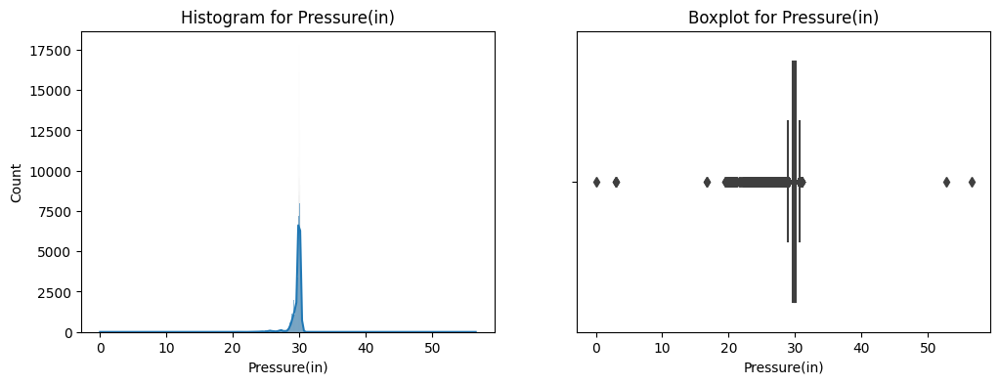

In [ ]:
conitnuous_columns_univariate('Pressure(in)')

Column Visibility(mi) has following description : 

count    488689.000000
mean          9.230113
std           2.715981
min           0.000000
25%          10.000000
50%          10.000000
75%          10.000000
max         111.000000
Name: Visibility(mi), dtype: float64


Visibility(mi) has skew=3.7506177627765527



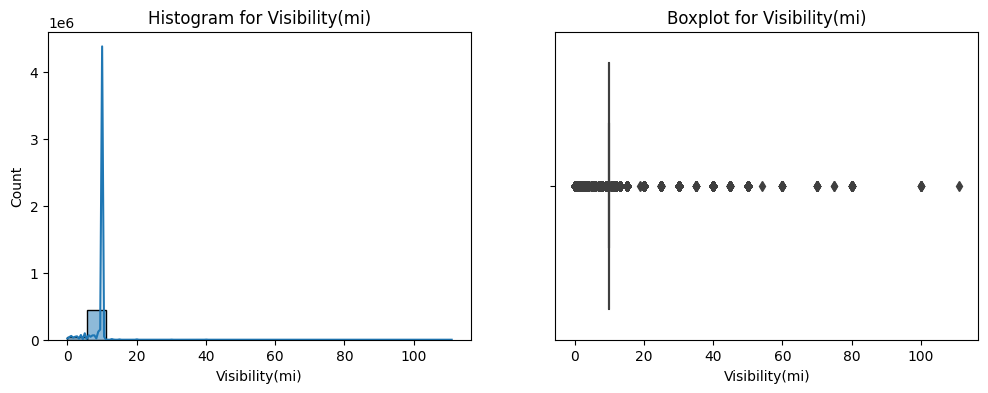

In [ ]:
conitnuous_columns_univariate('Visibility(mi)')

Column Precipitation(in) has following description : 

count    290983.000000
mean          0.011917
std           0.171475
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          24.000000
Name: Precipitation(in), dtype: float64


Precipitation(in) has skew=58.073348480914646



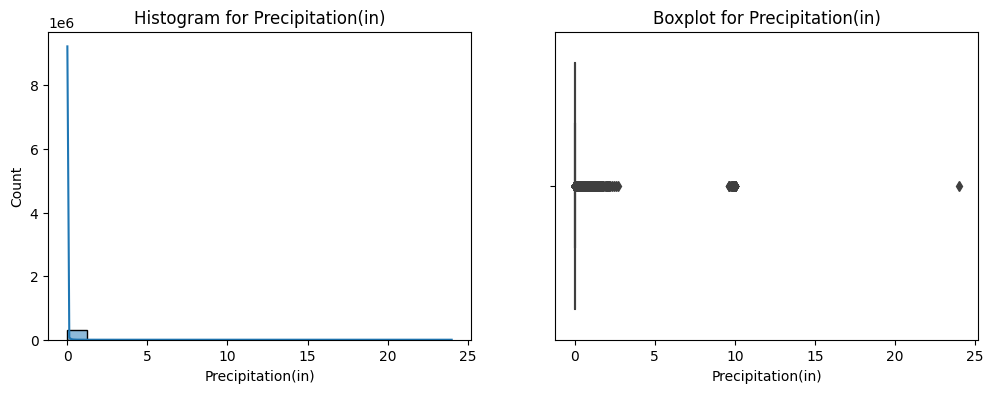

In [ ]:
conitnuous_columns_univariate('Precipitation(in)')

Column Wind_Speed(mph) has following description : 

count    455806.000000
mean          7.986930
std           5.476242
min           0.000000
25%           5.000000
50%           7.000000
75%          10.400000
max         822.800000
Name: Wind_Speed(mph), dtype: float64


Wind_Speed(mph) has skew=16.67005793558227



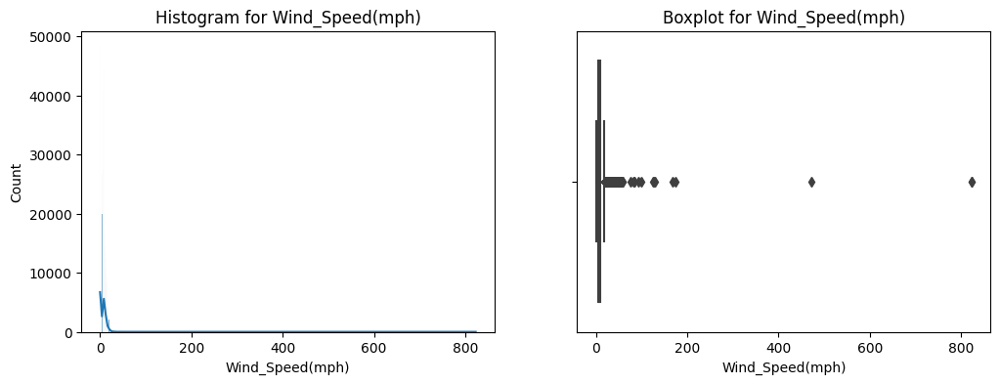

In [ ]:
conitnuous_columns_univariate('Wind_Speed(mph)')

In [ ]:
def categorical_columns_univariate(column_name):
  '''
  Univariate analysis for categorical columns
  '''
    fig,axs=plt.subplots(ncols=2,figsize=(10,6))
    data[column_name].value_counts().plot(kind='bar',ax=axs[0])
    axs[0].set_title(f"Bar plot for {column_name}")
    data[column_name].value_counts().plot(kind='pie',autopct='%0.1f%%',ax=axs[1])
    axs[1].set_title(f"Pie chart for {column_name}")
    plt.tight_layout()
    plt.show()

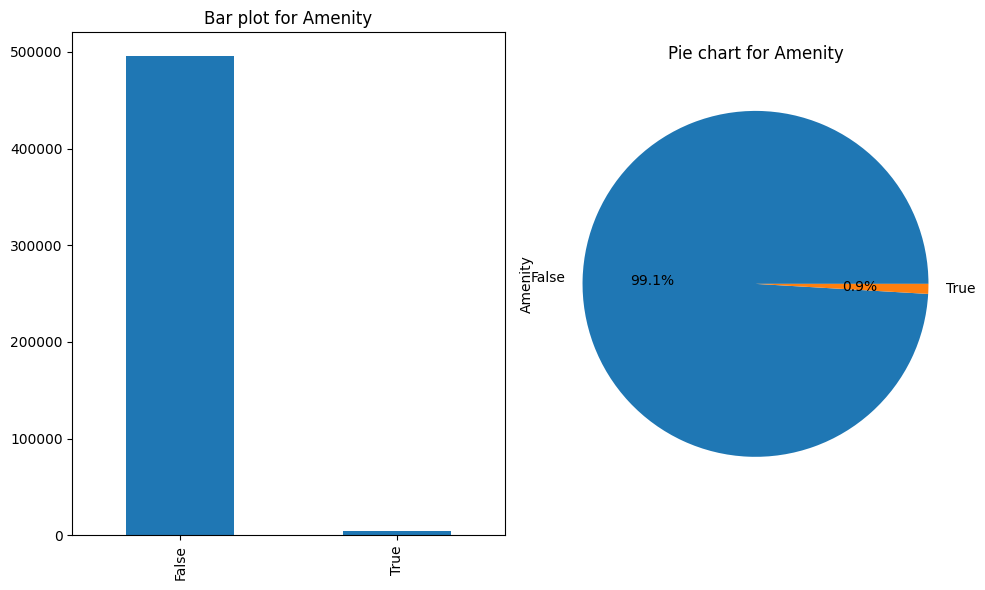

In [ ]:
categorical_columns_univariate('Amenity')

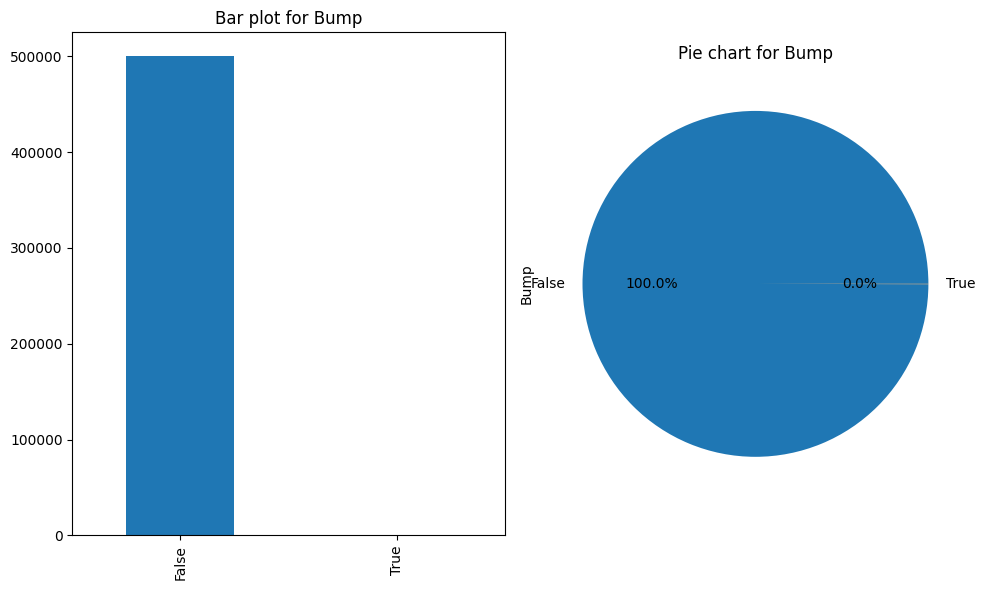

In [ ]:
categorical_columns_univariate('Bump')

In [ ]:
del data['Bump']

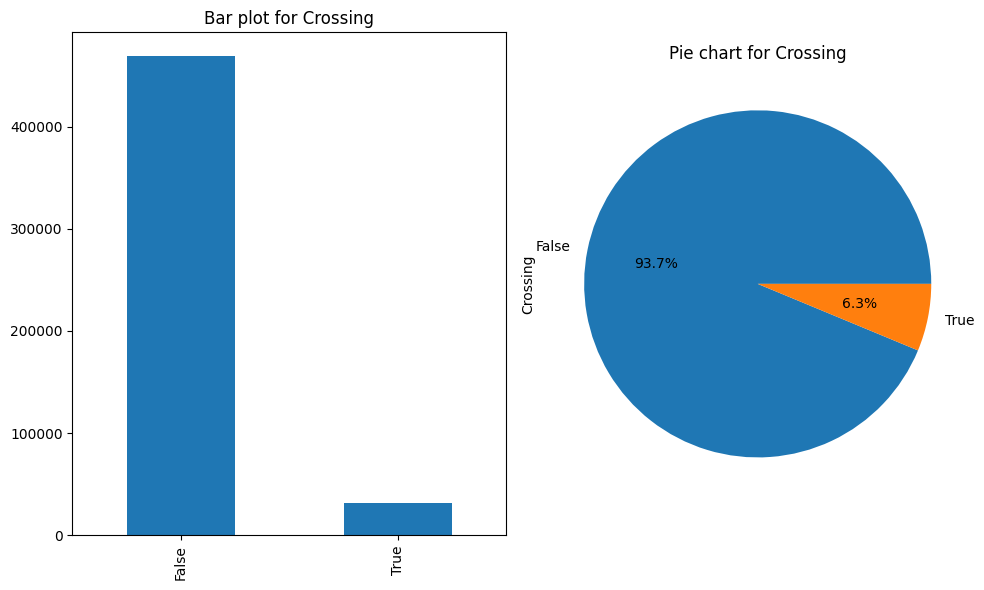

In [ ]:
categorical_columns_univariate('Crossing')

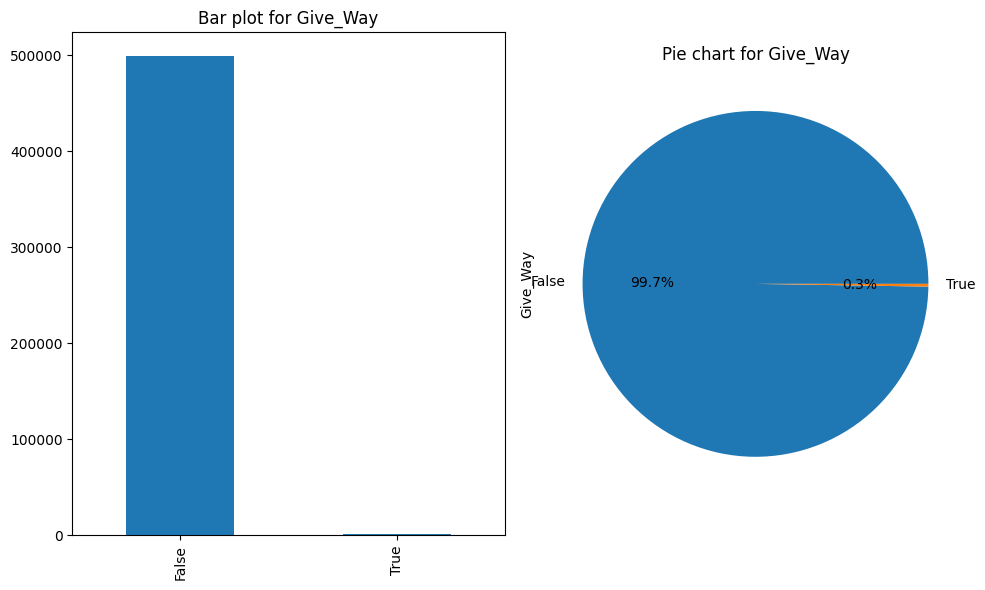

In [ ]:
categorical_columns_univariate('Give_Way')

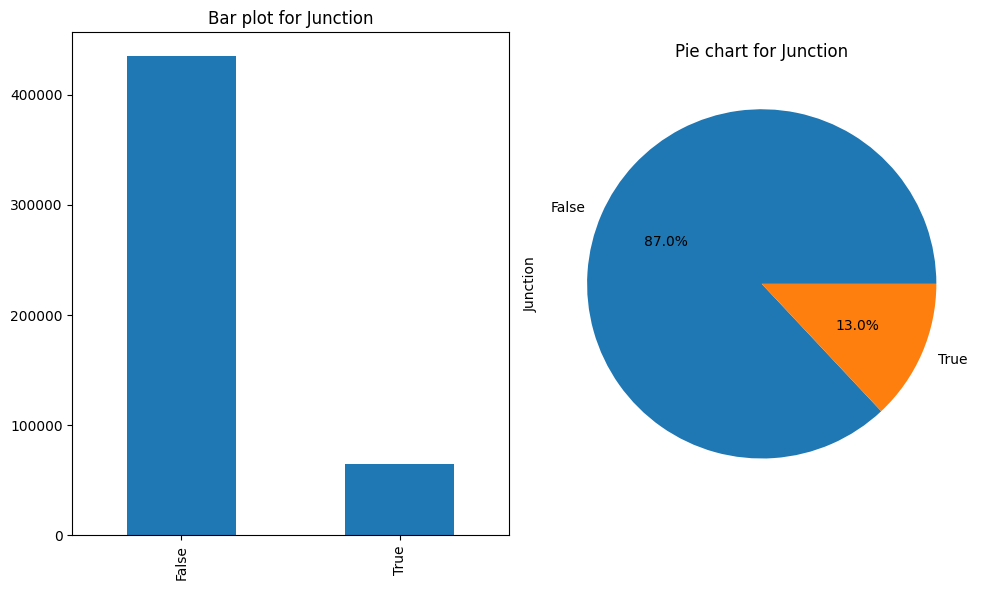

In [ ]:
categorical_columns_univariate('Junction')

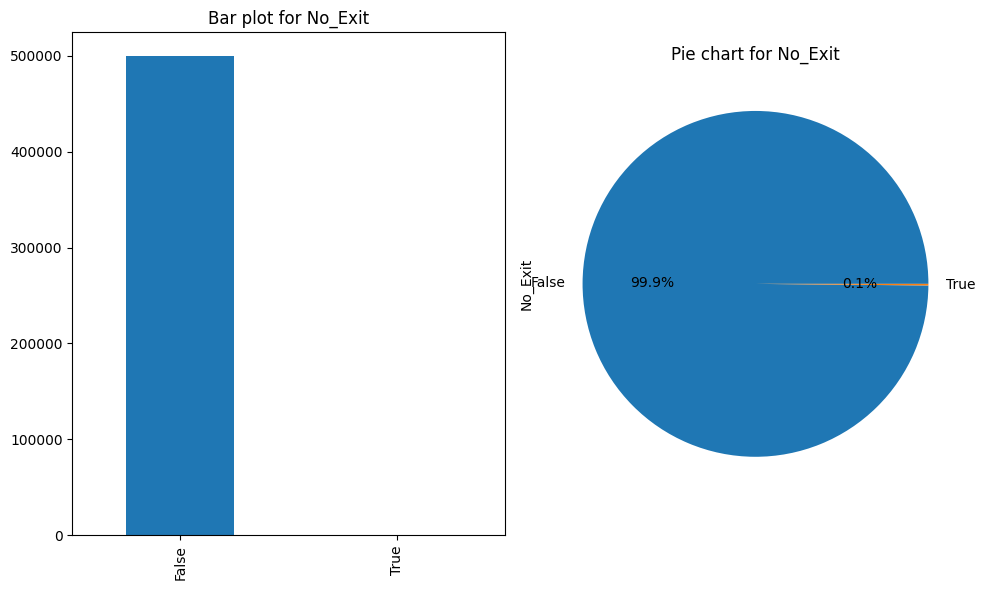

In [ ]:
categorical_columns_univariate('No_Exit')

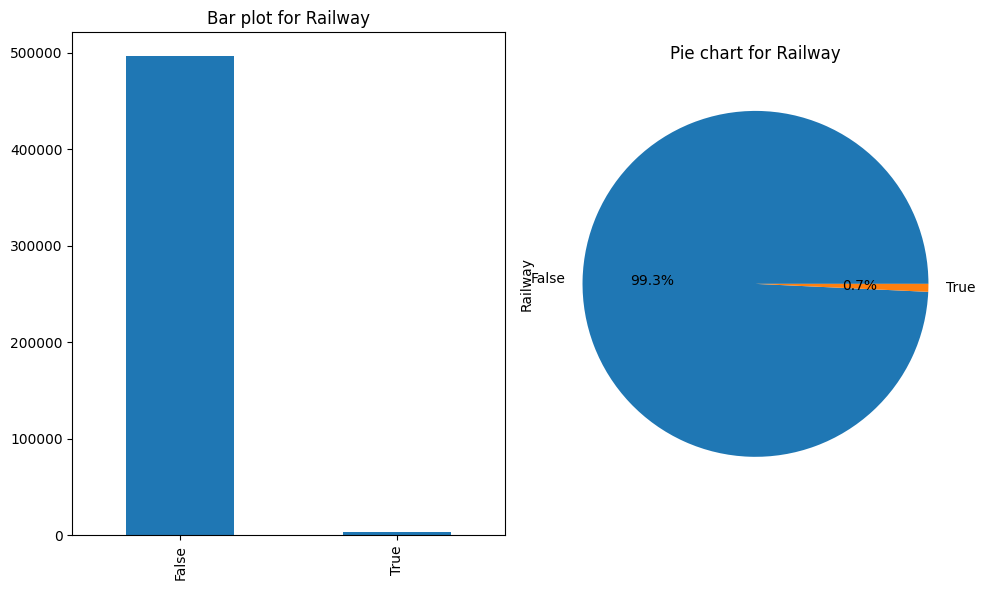

In [ ]:
categorical_columns_univariate('Railway')

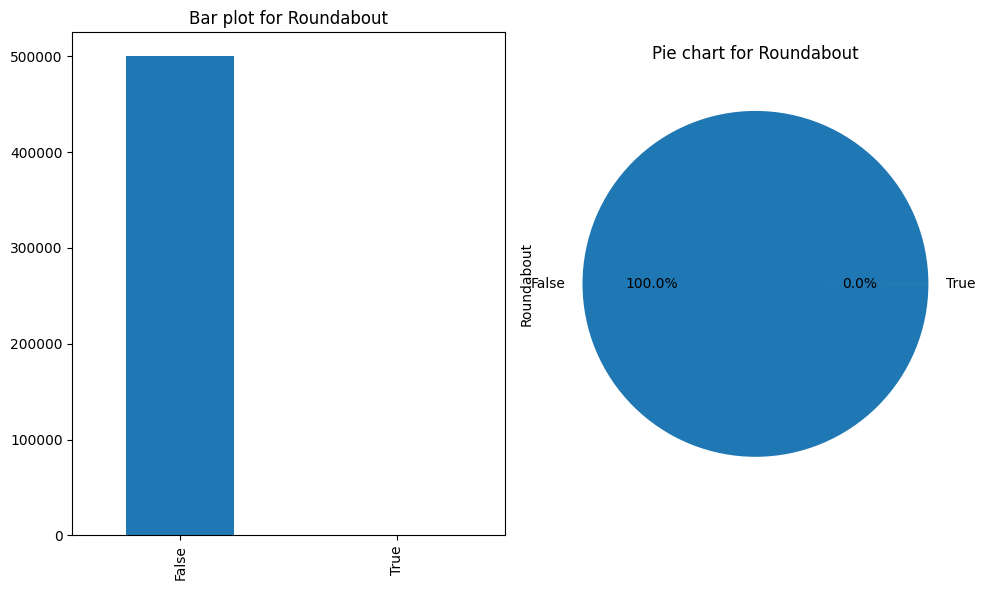

In [ ]:
categorical_columns_univariate('Roundabout')

In [ ]:
del data['Roundabout']

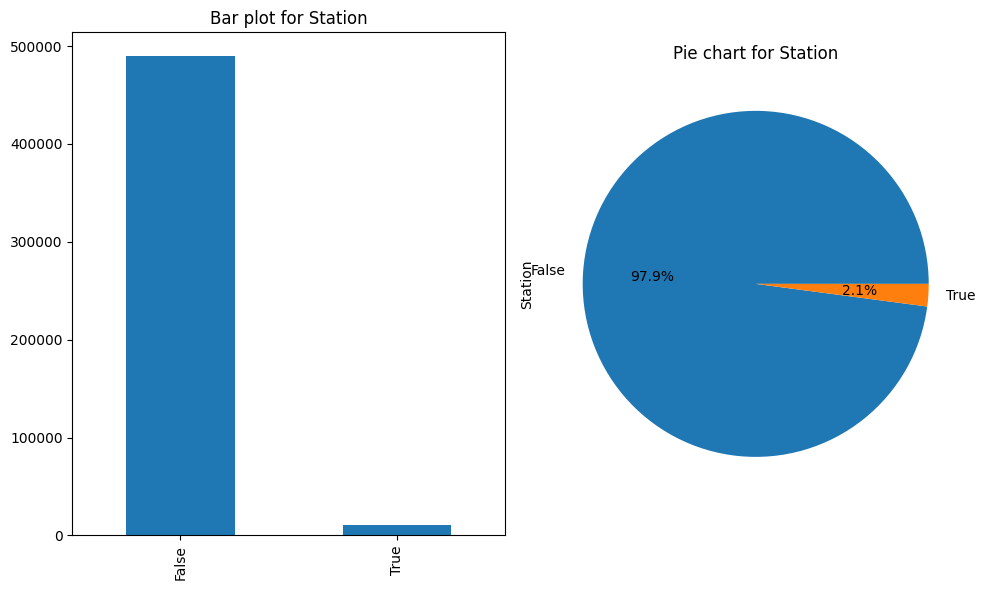

In [ ]:
categorical_columns_univariate('Station')

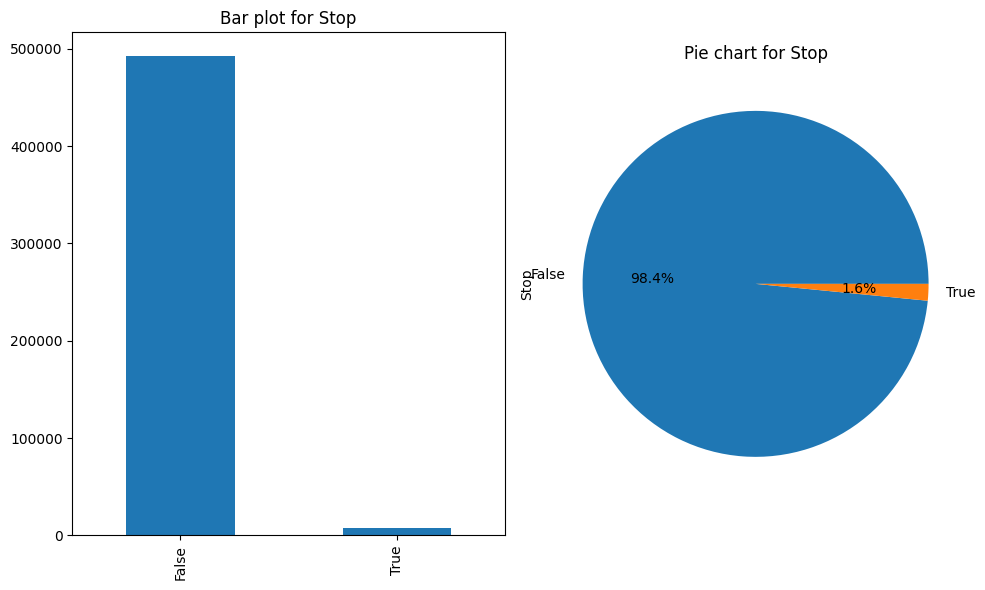

In [ ]:
categorical_columns_univariate('Stop')

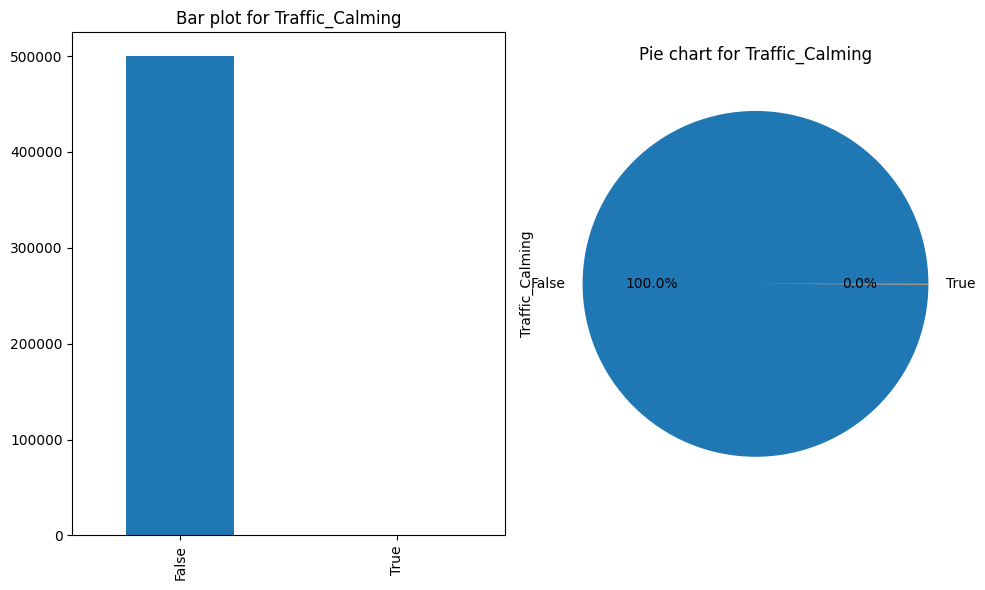

In [ ]:
categorical_columns_univariate('Traffic_Calming')

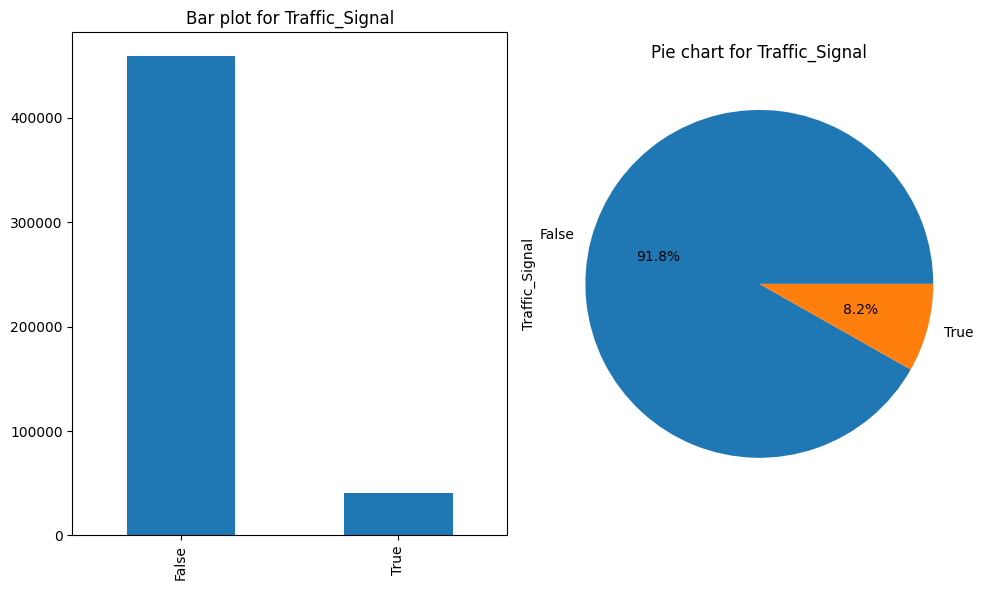

In [ ]:
categorical_columns_univariate('Traffic_Signal')

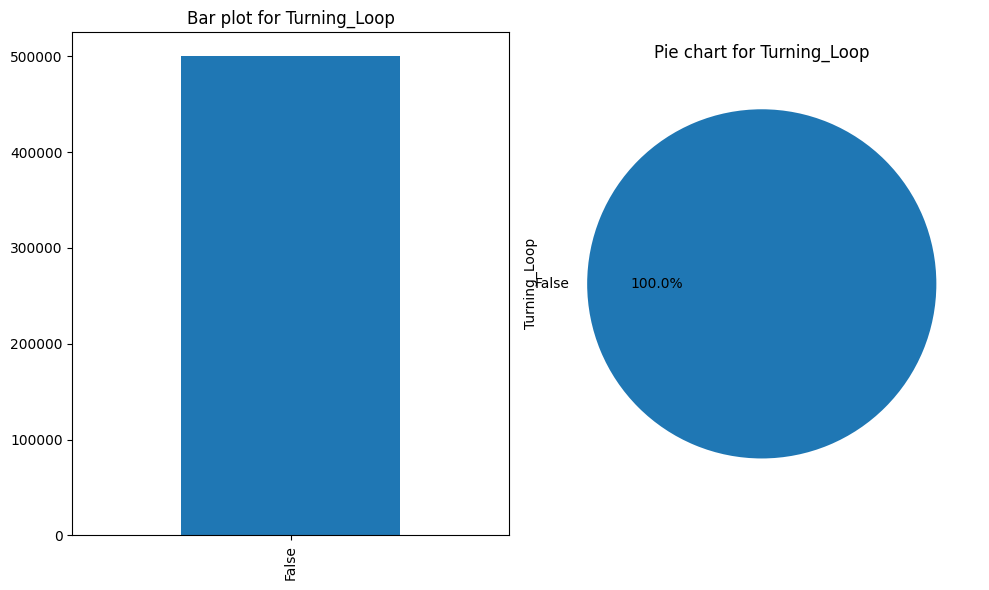

In [ ]:
categorical_columns_univariate('Turning_Loop')

In [ ]:
del data['Turning_Loop']

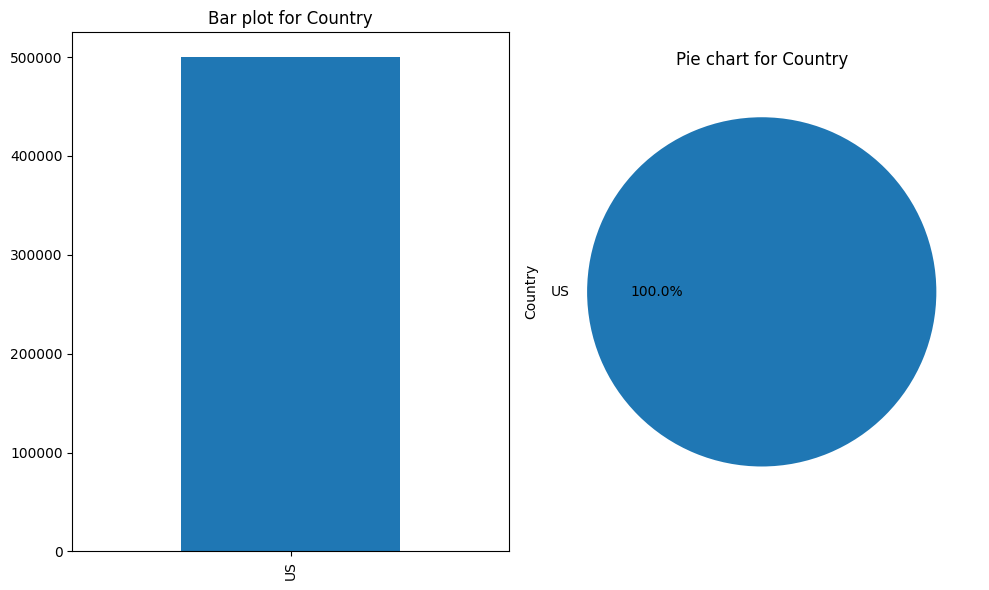

In [ ]:
categorical_columns_univariate('Country')

In [ ]:
del data['Country']

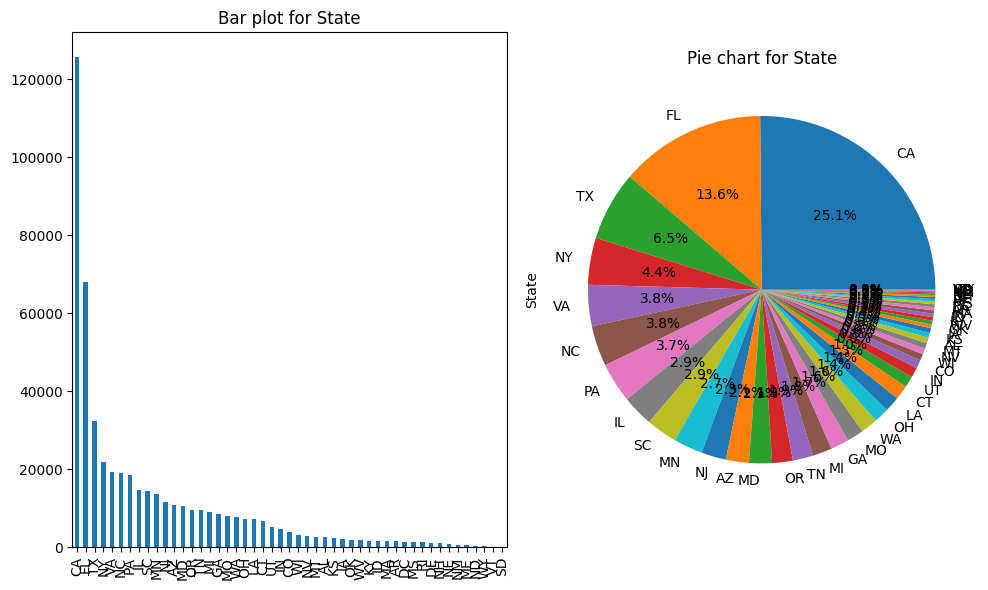

In [ ]:
categorical_columns_univariate('State')

In [ ]:
sampled_data=data.sample(n=1000,random_state=42)

In [ ]:
print(dict(Counter(sampled_data['Street'])))

{'I-105 E': 2, 'Cullen Blvd': 1, ' Pennsylvania Ave': 1, 'S Valley Fwy N': 1, 'I-77 S': 3, ' S Redwood Rd': 1, 'I-45 N': 2, ' W Sand Lake Rd': 1, 'Artesia Fwy W': 2, 'I-35W N': 4, 'Henry Shirley Memorial Hwy S': 1, ' Moffett Rd': 1, ' Piedmont Hwy': 1, ' Aviation Blvd': 1, 'Outerbelt N': 1, ' Wheatley Rd': 1, 'I-40 W': 5, 'Thornton Rd': 1, 'Long Beach Fwy S': 2, 'Michael G Rippe Pkwy': 1, ' Belk Ct': 1, 'GA-12 W': 1, 'GA-402 E': 4, 'New York Trwy W': 1, 'State Highway 1': 1, 'Pomona Fwy W': 2, 'Nimitz Fwy S': 1, ' Boydton Plank Rd': 1, 'I-35E N': 3, ' Painter Ave': 1, 'I-64 E': 3, 'Golden State Fwy S': 4, 'I-395 N': 1, 'I-278 W': 1, ' Broad Street Rd': 1, 'I-470 W': 1, ' S Figueroa St': 1, 'I-45 S': 3, ' Chichester Ave': 1, 'UT-36': 1, 'I-70 E': 3, 'Southern State Pkwy E': 2, 'I-695 E': 3, ' Bluebonnet Blvd': 1, ' SW 8th St': 1, ' S Glendale Ave': 1, 'I-95 S': 15, 'I-287 N': 1, ' Worcester Hwy': 1, 'Santa Ana Fwy S': 2, 'TX-375 Loop N': 1, ' N Micke Grove Rd': 1, 'I-805 N': 1, ' N Cour

In [ ]:
print(dict(Counter(sampled_data['Side'])))

{'R': 854, 'L': 146}


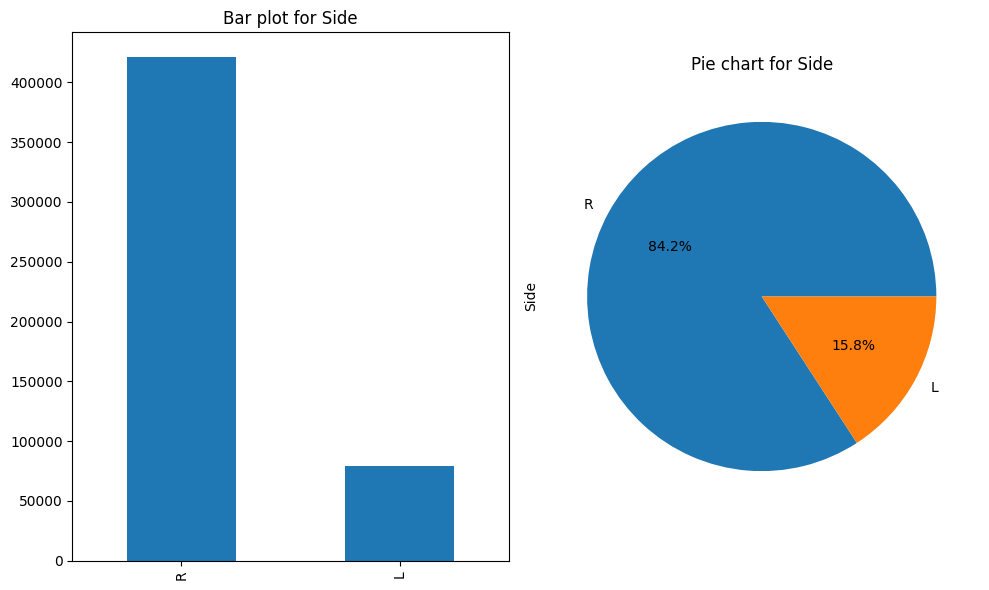

In [ ]:
categorical_columns_univariate('Side')

In [ ]:
print(dict(Counter(sampled_data['City'])))

{'Inglewood': 2, 'Houston': 18, 'Brooklyn': 6, 'Gilroy': 1, 'Bland': 1, 'South Jordan': 2, 'Orlando': 17, 'Cerritos': 1, 'Saint Paul': 6, 'Alexandria': 4, 'Semmes': 1, 'Piedmont': 1, 'Baltimore': 3, 'Columbus': 2, 'North East': 1, 'Memphis': 3, 'Raleigh': 8, 'Los Angeles': 26, 'Fort Myers': 3, 'Blythewood': 2, 'Conyers': 1, 'Decatur': 2, 'Corfu': 1, 'Aptos': 1, 'Hacienda Heights': 2, 'Hayward': 1, 'North Dinwiddie': 1, 'Dallas': 16, 'Whittier': 2, 'Charlottesville': 4, 'Granada Hills': 1, 'Staten Island': 2, 'Oilville': 1, 'Kansas City': 5, 'Webster': 1, 'Upper Chichester': 1, 'Stockton': 3, 'Indianapolis': 3, 'Valley Stream': 1, 'Glen Burnie': 1, 'Baton Rouge': 9, 'Coral Gables': 1, 'Glendale': 3, 'Miami': 31, 'Haskell': 1, 'Pocomoke City': 1, 'Downey': 3, 'El Paso': 1, 'Lodi': 2, 'San Diego': 15, 'Merritt Island': 1, 'Pineville': 1, 'Brewster': 1, 'Fort Lee': 4, 'Bessemer': 1, 'Seattle': 7, 'Oakland': 3, 'Everett': 1, 'Mansfield': 3, 'Pleasantville': 1, 'Bakersfield': 4, 'San Jose': 

In [ ]:
print(dict(Counter(sampled_data['County'])))

{'Los Angeles': 91, 'Harris': 21, 'Kings': 6, 'Santa Clara': 6, 'Bland': 1, 'Salt Lake': 7, 'Orange': 40, 'Ramsey': 5, 'Alexandria': 3, 'Mobile': 1, 'Greenville': 3, 'Anne Arundel': 4, 'Franklin': 2, 'Cecil': 1, 'Shelby': 3, 'Wake': 10, 'Lee': 5, 'Richland': 5, 'Rockdale': 1, 'DeKalb': 6, 'Genesee': 3, 'Santa Cruz': 2, 'Alameda': 19, 'Petersburg City': 1, 'Dallas': 17, 'Albemarle': 4, 'Richmond': 3, 'Goochland': 1, 'Jackson': 6, 'Delaware': 3, 'Tooele': 1, 'Marion': 3, 'Nassau': 5, 'East Baton Rouge': 9, 'Miami-Dade': 44, 'Passaic': 3, 'Worcester': 2, 'El Paso': 1, 'San Joaquin': 5, 'San Diego': 20, 'Brevard': 3, 'Berkeley': 2, 'Putnam': 2, 'Bergen': 5, 'Jefferson': 5, 'King': 10, 'Snohomish': 2, 'Tioga': 3, 'Westchester': 9, 'Kern': 4, 'Forrest': 1, 'Duval': 7, 'Hennepin': 7, 'Travis': 6, 'Palm Beach': 4, 'San Bernardino': 17, 'Fresno': 5, 'Douglas': 3, 'Ingham': 1, 'Tyrrell': 1, 'Mecklenburg': 20, 'Cass': 2, 'Washington': 3, 'Lake': 11, 'Dauphin': 3, 'Tarrant': 9, 'Deschutes': 1, 'Mi

In [ ]:
print(dict(Counter(sampled_data['Zipcode'])))

{'90304': 1, '77047': 1, '11207-2450': 1, '95020': 1, '24315': 1, '84095-9324': 1, '77090': 1, '32819': 2, '90703': 1, '55126': 1, '22302': 1, '36575-5411': 1, '29673-8734': 1, '21240': 1, '43230': 1, '21901-2004': 1, '38134': 1, '27616': 1, '90058': 1, '33967': 1, '29016-7301': 1, '30012': 1, '30034': 2, '14036': 1, '95003': 1, '91745': 1, '94545': 1, '23803-7325': 1, '75229': 1, '90605-2727': 1, '22903': 3, '91344': 1, '22304': 1, '10314': 1, '23129-2202': 1, '64137': 2, '90003-1016': 1, '77598': 1, '19061-3139': 1, '84071': 1, '46202': 1, '11580': 1, '21060': 1, '70810-6458': 1, '33134-2654': 1, '91205-2805': 1, '33136': 1, '07420': 1, '21851-2704': 1, '90240': 1, '79907': 1, '95240-9426': 1, '92111': 1, '32953-4749': 1, '11214': 1, '29468-3007': 1, '10509': 1, '07024': 4, '35022': 1, '98102': 1, '95203': 1, '94610': 1, '95215-9587': 1, '98208': 1, '16933': 1, '10570': 1, '93313': 1, '95134': 1, '39402-1321': 1, '91321': 2, '32204': 1, '55423': 1, '78748-6523': 1, '92626': 1, '32805

In [ ]:
print(dict(Counter(sampled_data['Timezone'])))

{'US/Pacific': 310, 'US/Central': 198, 'US/Eastern': 453, 'US/Mountain': 39}


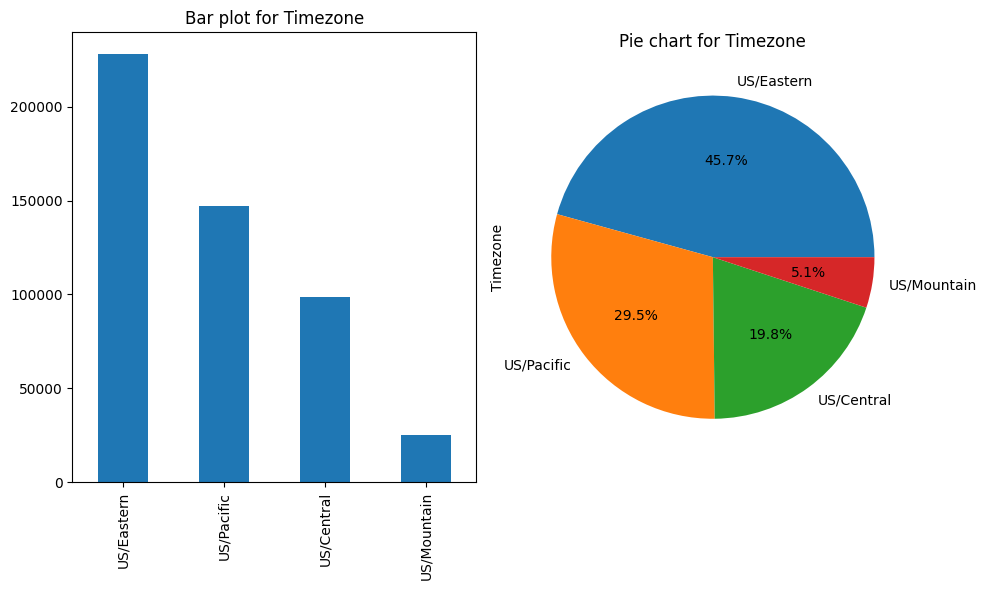

In [ ]:
categorical_columns_univariate('Timezone')

In [ ]:
print(dict(Counter(sampled_data['Airport_Code'])))

{'KHHR': 7, 'KMCJ': 12, 'KJFK': 4, 'KE16': 1, 'KBLF': 1, 'KU42': 6, 'KDWH': 2, 'KMCO': 7, 'KFUL': 9, 'KANE': 2, 'KDCA': 6, 'KMOB': 1, 'KGYH': 1, 'KBWI': 3, 'KCMH': 2, 'KAPG': 1, 'KNQA': 1, 'KRDU': 10, 'KCQT': 22, 'KRSW': 3, 'KFDW': 2, 'K9A1': 1, 'KATL': 8, 'KBUF': 1, 'KWVI': 1, 'KEMT': 12, 'KHWD': 7, nan: 3, 'KDAL': 13, 'KCHO': 4, 'KVNY': 8, 'KLDJ': 6, 'KOFP': 3, 'KLXT': 2, 'KEFD': 2, 'KPHL': 5, 'KT62': 1, 'KEYE': 2, 'KBTR': 9, 'KMIA': 16, 'KCDW': 2, 'KWAL': 1, 'KELP': 1, 'KSCK': 5, 'KMYF': 8, 'KXMR': 1, 'KJRB': 5, 'KMNI': 1, 'KDXR': 2, 'KTEB': 6, 'KEET': 1, 'KBFI': 7, 'KOAK': 6, 'KPAE': 3, 'KELM': 1, 'KHPN': 9, 'KBFL': 4, 'KSJC': 6, 'KHBG': 1, 'K3A6': 3, 'KNIP': 4, 'KMSP': 5, 'KAUS': 1, 'KSNA': 12, 'KORL': 12, 'KNRS': 3, 'KPBI': 4, 'KVCV': 1, 'KLGB': 6, 'KNLC': 1, 'KAXN': 1, 'KOZW': 1, 'KEDE': 1, 'KJQF': 4, 'KCLT': 12, 'KHWO': 3, 'KPMD': 3, 'KBTM': 1, 'KAIO': 1, 'KHGR': 1, 'KFMY': 2, 'KTMB': 11, 'KSBD': 6, 'KPWK': 6, 'KMDT': 1, 'KFWS': 2, 'KBDN': 1, 'KNYC': 5, 'KADS': 3, 'KXSA': 1, 'K

In [ ]:
print(dict(Counter(sampled_data['Weather_Timestamp'])))

{'2016-12-01 17:53:00': 1, '2017-06-14 16:35:00': 1, '2017-02-08 08:51:00': 1, '2016-07-07 15:15:00': 1, '2021-10-13 18:52:00': 1, nan: 12, '2017-07-21 18:53:00': 1, '2021-10-23 18:53:00': 1, '2016-04-21 10:53:00': 1, '2021-06-11 13:45:00': 1, '2021-12-01 17:52:00': 1, '2021-06-20 14:56:00': 1, '2021-08-02 01:15:00': 1, '2017-07-04 03:54:00': 1, '2016-05-02 12:18:00': 1, '2021-08-26 11:58:00': 1, '2016-06-27 15:50:00': 1, '2021-11-11 13:51:00': 1, '2016-07-20 17:47:00': 1, '2021-03-06 07:53:00': 1, '2021-09-14 10:55:00': 1, '2017-05-31 18:45:00': 1, '2017-04-06 01:52:00': 1, '2016-08-30 04:54:00': 1, '2021-04-15 05:53:00': 2, '2016-09-23 17:45:00': 1, '2016-05-22 02:37:00': 1, '2021-12-29 09:37:00': 1, '2021-11-10 15:53:00': 1, '2016-06-24 11:53:00': 1, '2021-12-12 18:51:00': 1, '2021-08-20 06:16:00': 1, '2016-06-22 17:35:00': 1, '2017-04-28 11:54:00': 1, '2021-06-29 07:53:00': 1, '2021-06-25 15:53:00': 1, '2017-02-09 20:50:00': 1, '2021-03-11 03:54:00': 1, '2021-12-18 10:56:00': 1, '2

In [ ]:
print(dict(Counter(sampled_data['Wind_Direction'])))

{'West': 49, 'SSE': 46, 'SW': 44, 'NW': 48, nan: 22, 'SE': 51, 'ENE': 28, 'South': 35, 'S': 50, 'N': 24, 'Calm': 59, 'NNE': 28, 'SSW': 40, 'W': 52, 'WNW': 54, 'VAR': 29, 'East': 22, 'CALM': 77, 'E': 30, 'NNW': 43, 'WSW': 44, 'North': 25, 'NE': 30, 'ESE': 44, 'Variable': 26}


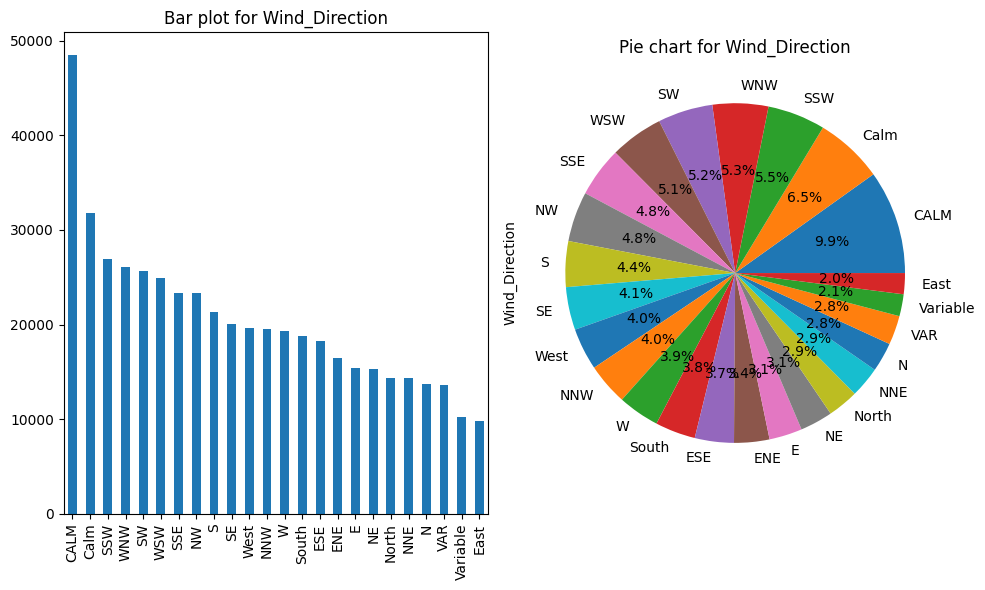

In [ ]:
categorical_columns_univariate('Wind_Direction')

In [ ]:
print(dict(Counter(sampled_data['Weather_Condition'])))

{'Clear': 160, 'Mostly Cloudy': 153, 'Fair': 266, nan: 19, 'Partly Cloudy': 87, 'Cloudy': 87, 'Scattered Clouds': 58, 'Overcast': 70, 'Light Rain': 42, 'Haze': 13, 'Light Snow': 11, 'Rain': 9, 'Thunder in the Vicinity': 3, 'Cloudy / Windy': 4, 'Smoke': 1, 'Thunderstorm': 1, 'Light Drizzle': 1, 'Light Thunderstorms and Rain': 3, 'Partly Cloudy / Windy': 1, 'Heavy Rain': 2, 'Fog': 4, 'Fair / Windy': 1, 'T-Storm': 1, 'Snow': 1, 'Thunder': 1, 'Light Thunderstorms and Snow': 1}


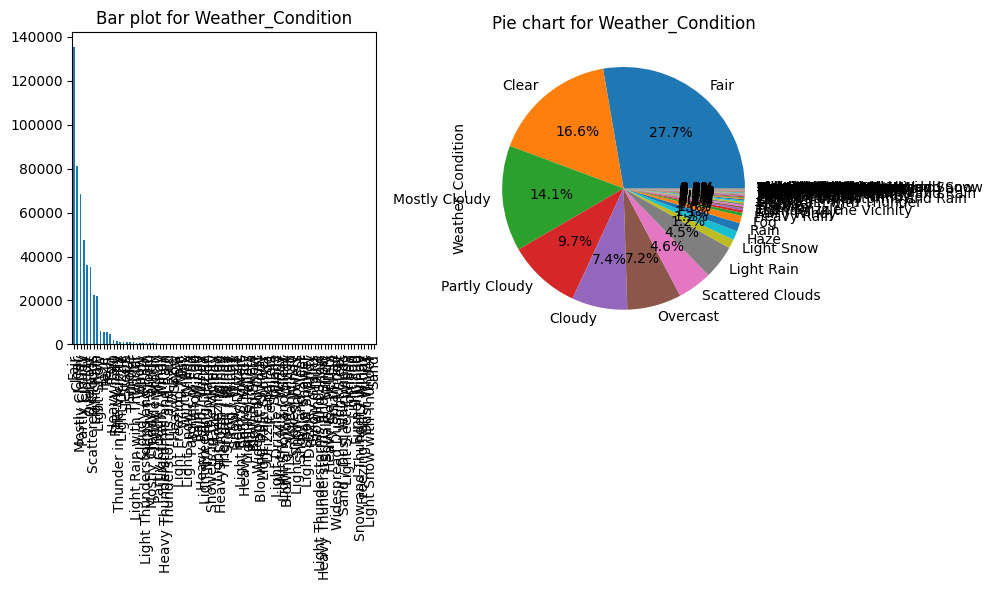

In [ ]:
categorical_columns_univariate('Weather_Condition')

In [ ]:
print(dict(Counter(sampled_data['Sunrise_Sunset'])))

{'Night': 286, 'Day': 713, nan: 1}


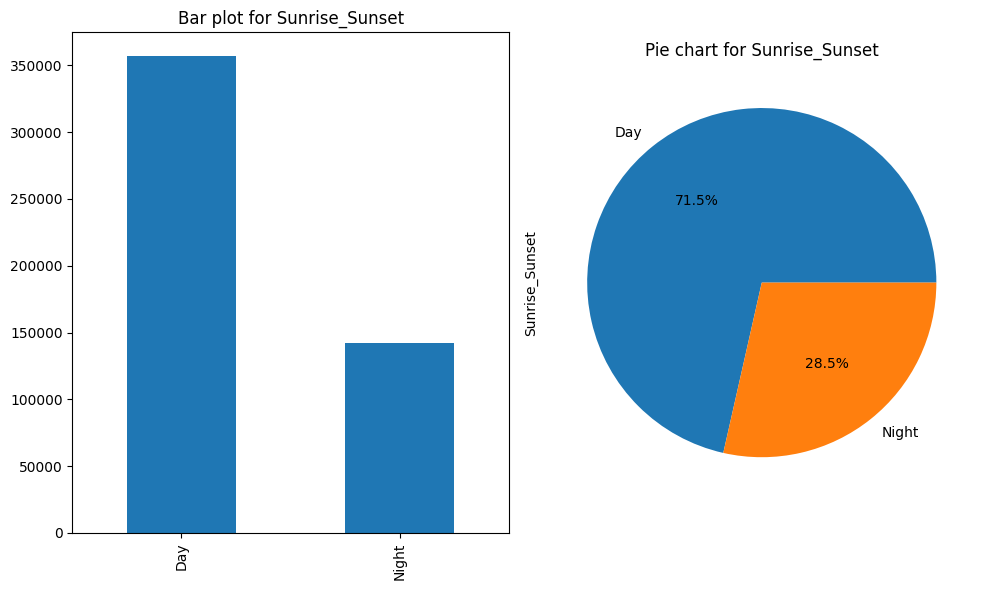

In [ ]:
categorical_columns_univariate('Sunrise_Sunset')

In [ ]:
print(dict(Counter(sampled_data['Civil_Twilight'])))

{'Night': 240, 'Day': 759, nan: 1}


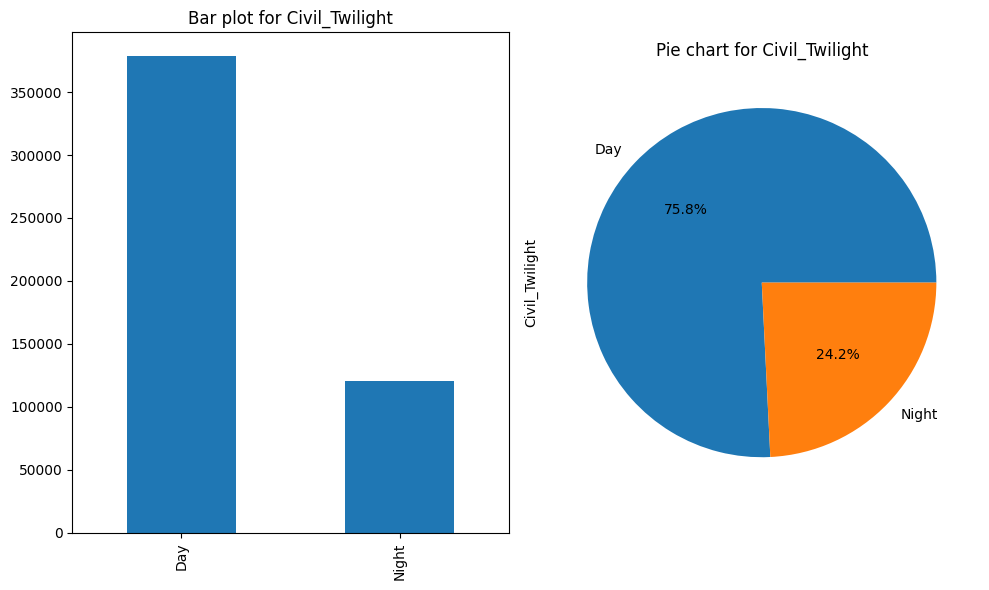

In [ ]:
categorical_columns_univariate('Civil_Twilight')

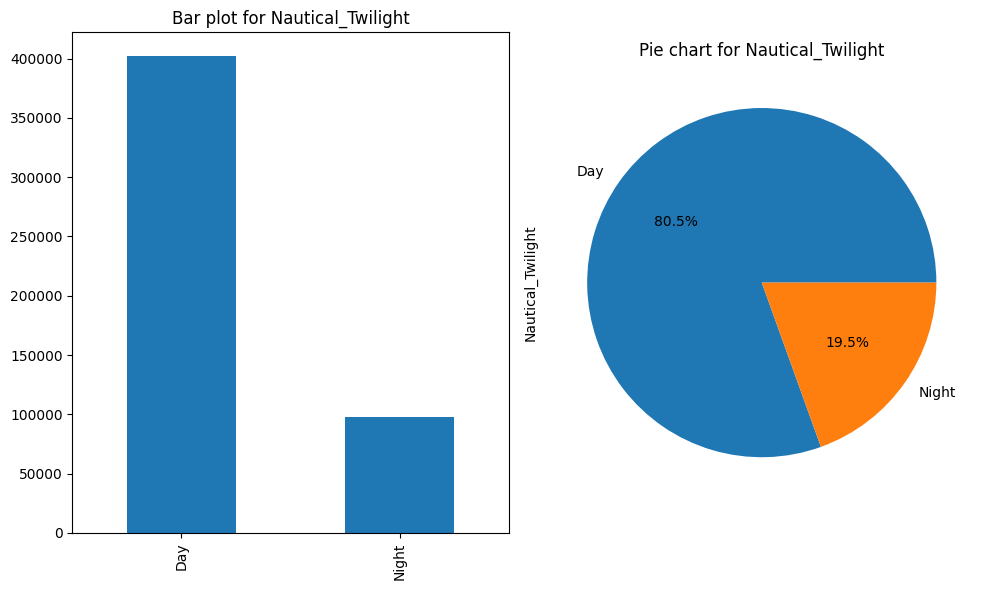

In [ ]:
categorical_columns_univariate('Nautical_Twilight')

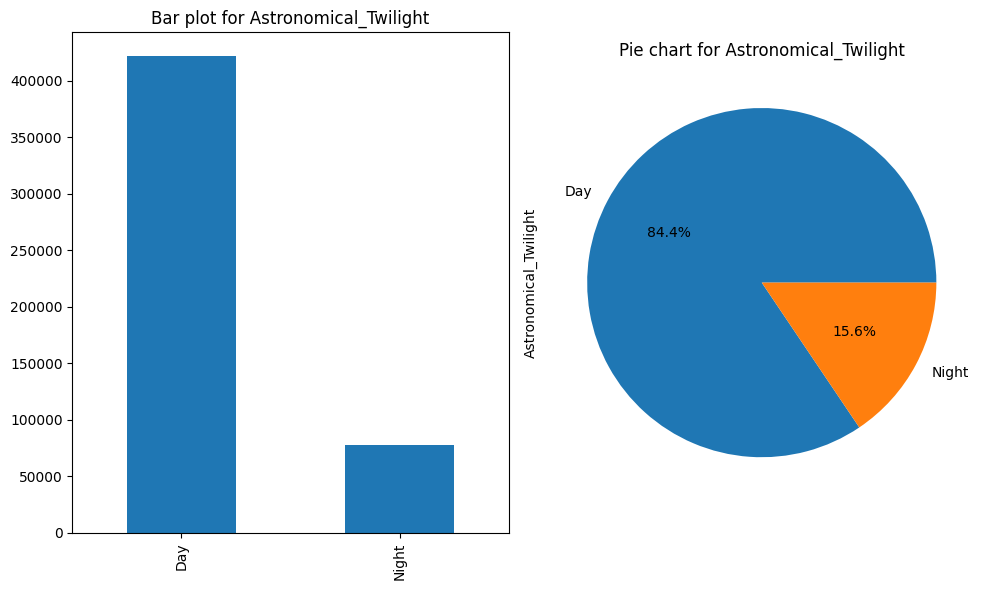

In [ ]:
categorical_columns_univariate('Astronomical_Twilight')

In [ ]:
#Bivariate
def categorical_categorical(column_1='Severity',column_2=None):
    ctab=pd.crosstab(data[column_1],data[column_2],normalize='columns')
    fig,axs=plt.subplots(nrows=1,ncols=2,figsize=(10,5))
    sns.heatmap(ctab,annot=True,cmap='Blues',ax=axs[0])
    axs[0].set_title(f'Heatmap of {column_1} v/s {column_2}')
    ctab.plot(kind='bar', stacked=True, ax=axs[1])
    axs[1].set_xlabel(column_1)
    axs[1].set_ylabel('Count')
    axs[1].set_title(f'Stacked Barplot of {column_1} v/s {column_2}')
    plt.subplots_adjust(wspace=0.3)
    plt.show()

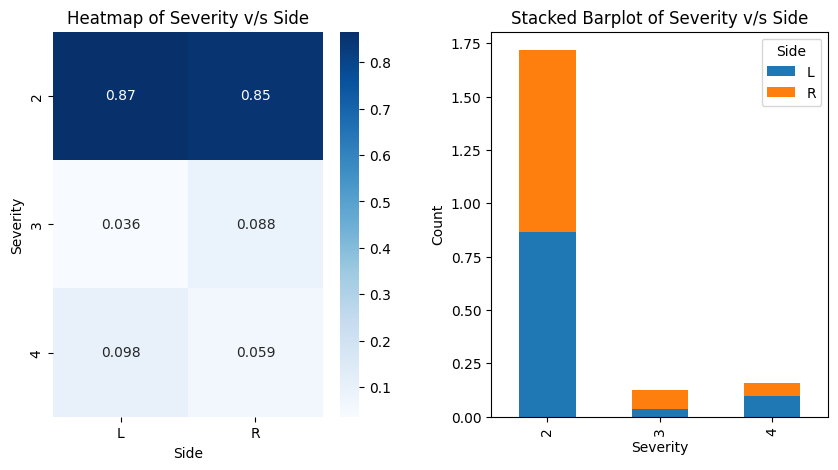

In [ ]:
categorical_categorical(column_2='Side')

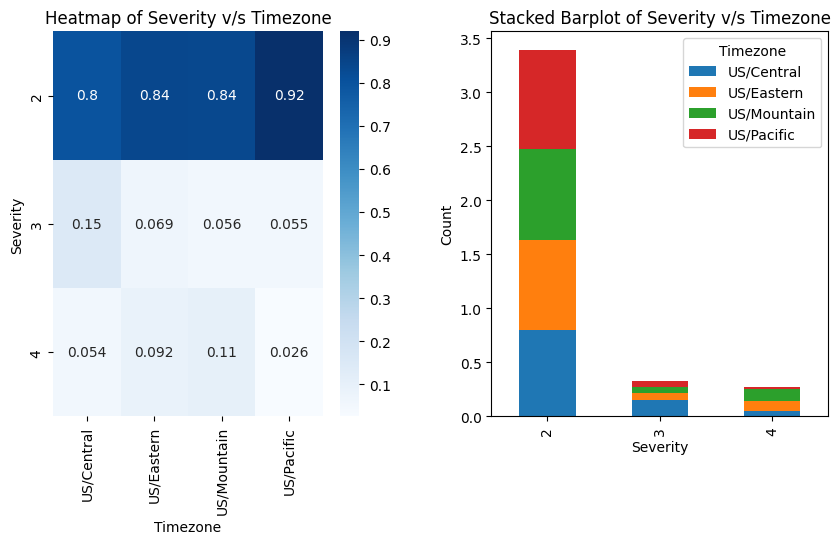

In [ ]:
categorical_categorical(column_2='Timezone')

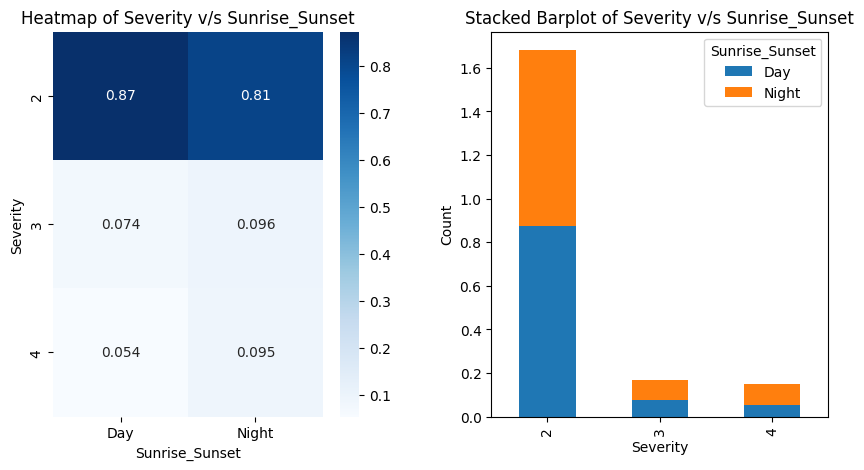

In [ ]:
categorical_categorical(column_2='Sunrise_Sunset')

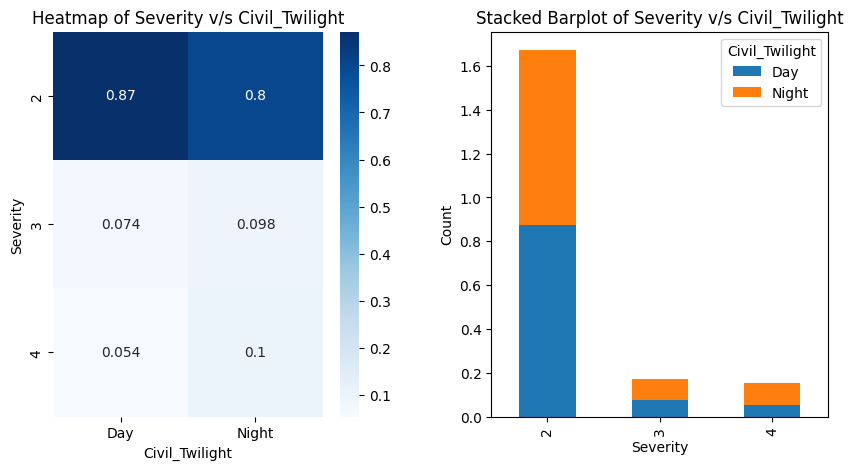

In [ ]:
categorical_categorical(column_2='Civil_Twilight')

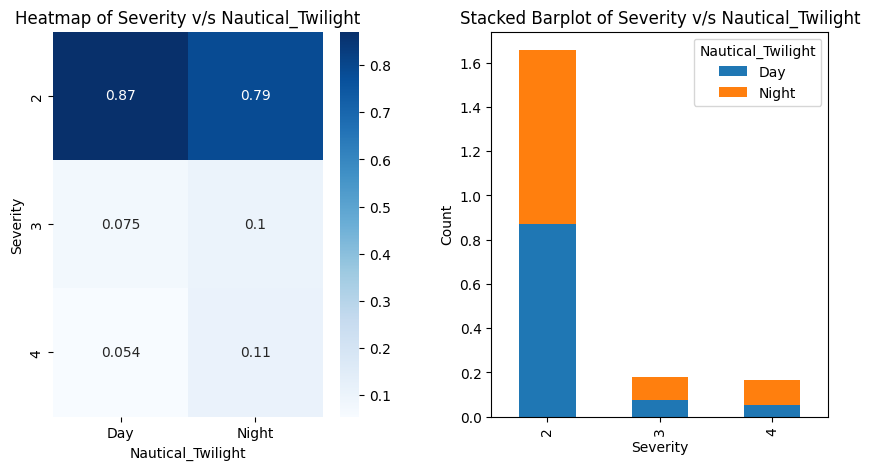

In [ ]:
categorical_categorical(column_2='Nautical_Twilight')

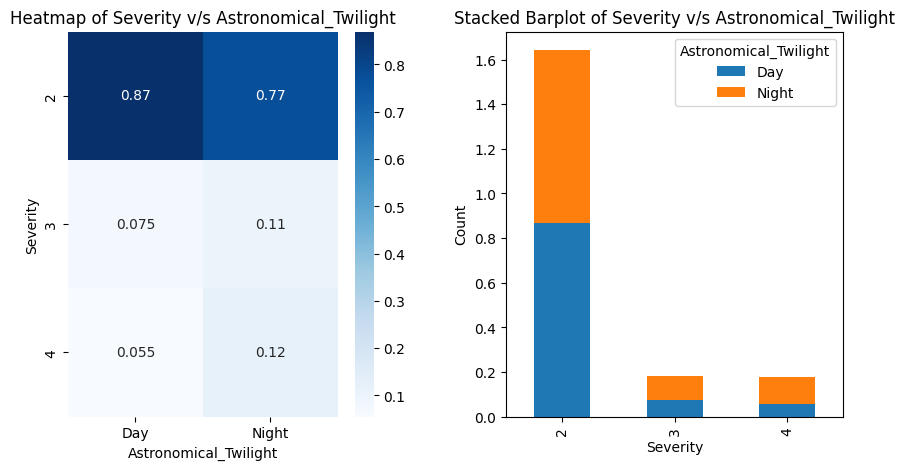

In [ ]:
categorical_categorical(column_2='Astronomical_Twilight')

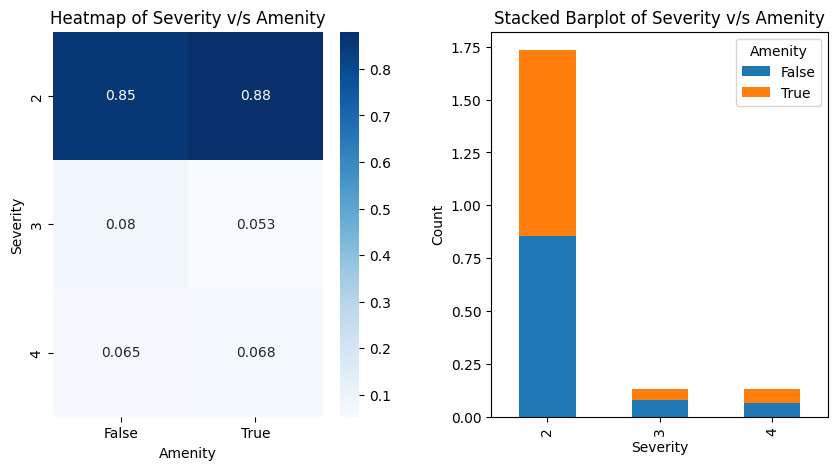

In [ ]:
categorical_categorical(column_2='Amenity')

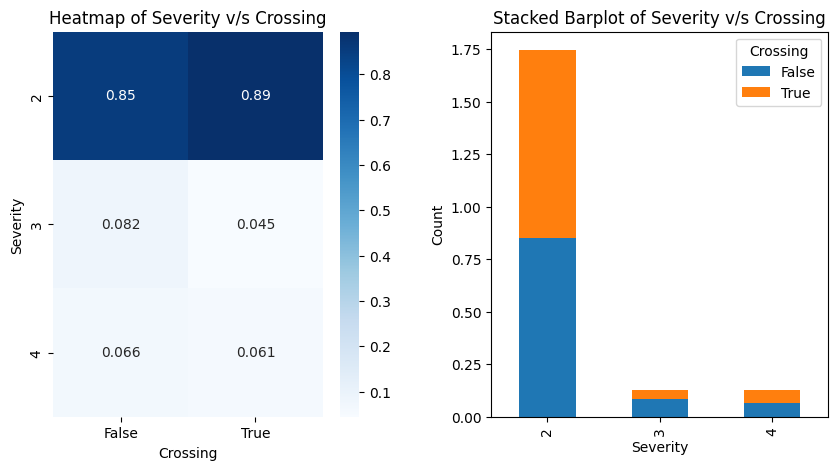

In [ ]:
categorical_categorical(column_2='Crossing')

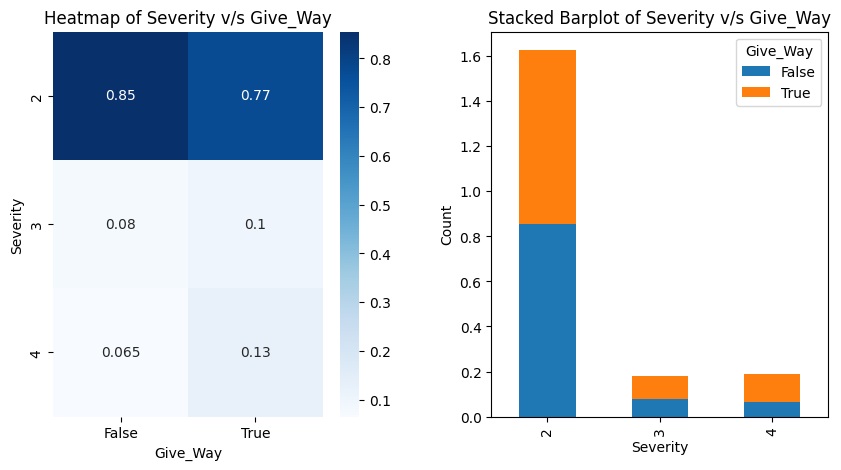

In [ ]:
categorical_categorical(column_2='Give_Way')

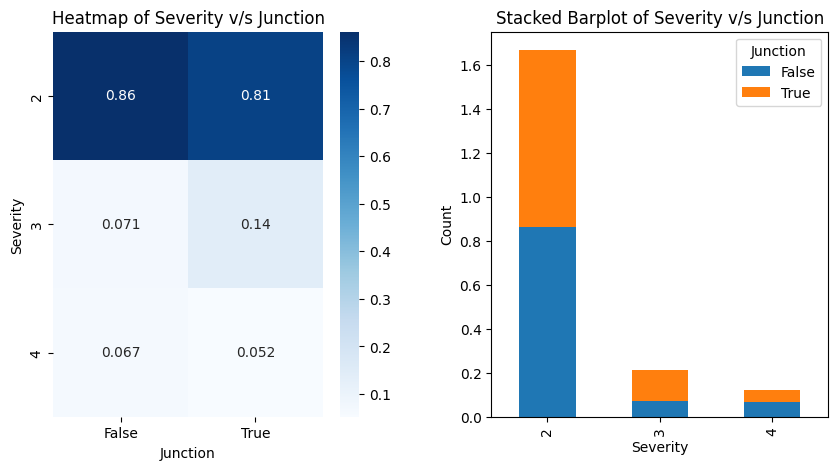

In [ ]:
categorical_categorical(column_2='Junction')

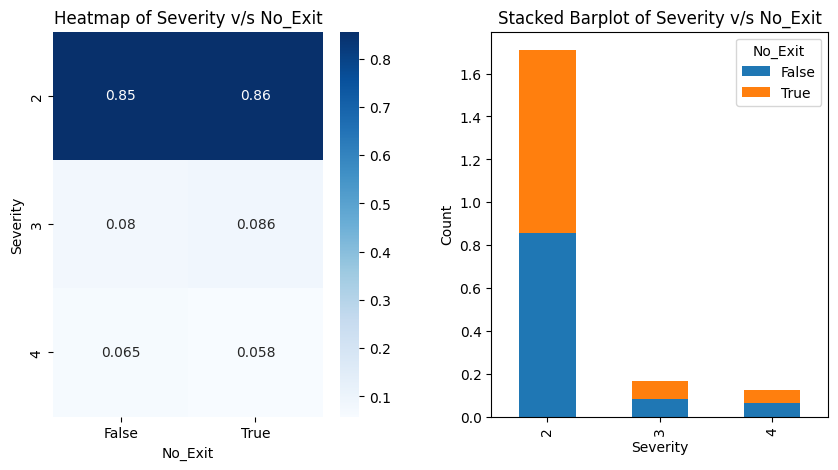

In [ ]:
categorical_categorical(column_2='No_Exit')

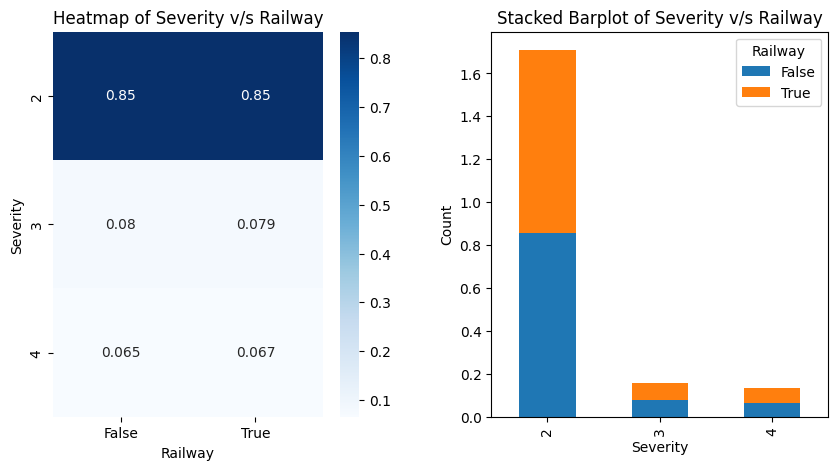

In [ ]:
categorical_categorical(column_2='Railway')

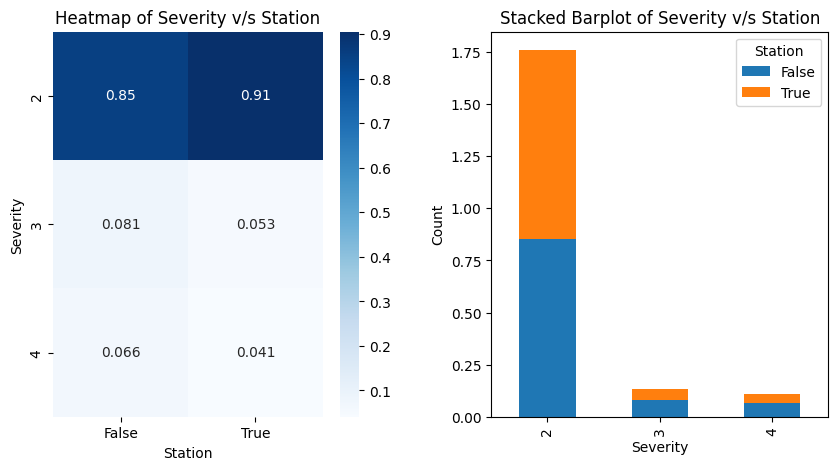

In [ ]:
categorical_categorical(column_2='Station')

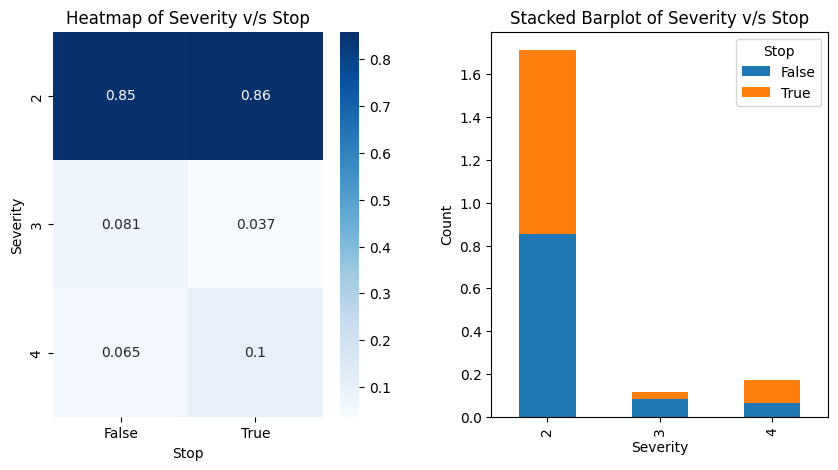

In [ ]:
categorical_categorical(column_2='Stop')

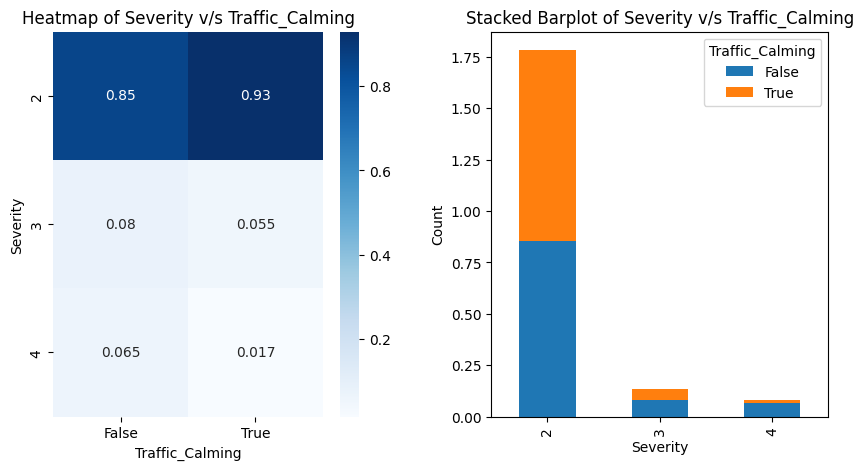

In [ ]:
categorical_categorical(column_2='Traffic_Calming')

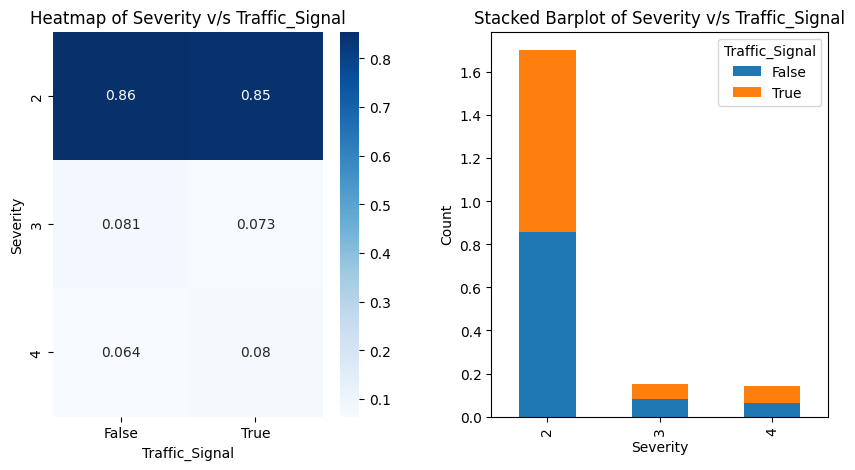

In [ ]:
categorical_categorical(column_2='Traffic_Signal')

In [ ]:
def correlation_heatmap():
    corr=data.corr()
    fig,ax = plt.subplots(figsize=(20,20))
    sns.heatmap(corr,cmap='coolwarm', vmax=1, vmin=-1, center=0,square=True,linewidths=.5,cbar_kws={"shrink": .5},annot=True)
    ax.set_title('Correlation Heatmap')
    plt.show()

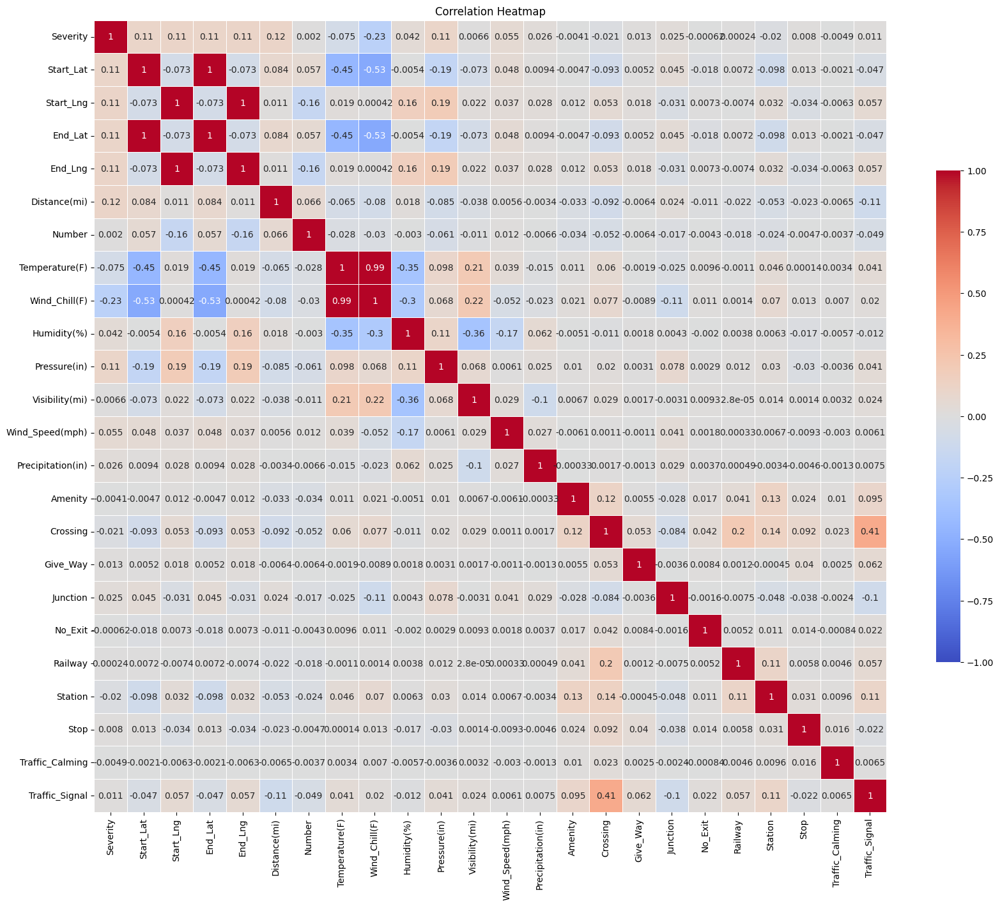

In [ ]:
correlation_heatmap()

In [ ]:
def delete_low_corr_cols(data):
    corr_matrix=data.corr()
    severity_corr=corr_matrix['Severity']
    low_corr_cols=severity_corr[abs(severity_corr)<0.01].index.tolist()
    data=data.drop(columns=low_corr_cols)
    print(low_corr_cols)
    return data

In [ ]:
data=delete_low_corr_cols(data)

<ipython-input-49-6cb71d7778fa>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix=data.corr()


['Number', 'Visibility(mi)', 'Amenity', 'No_Exit', 'Railway', 'Stop', 'Traffic_Calming']


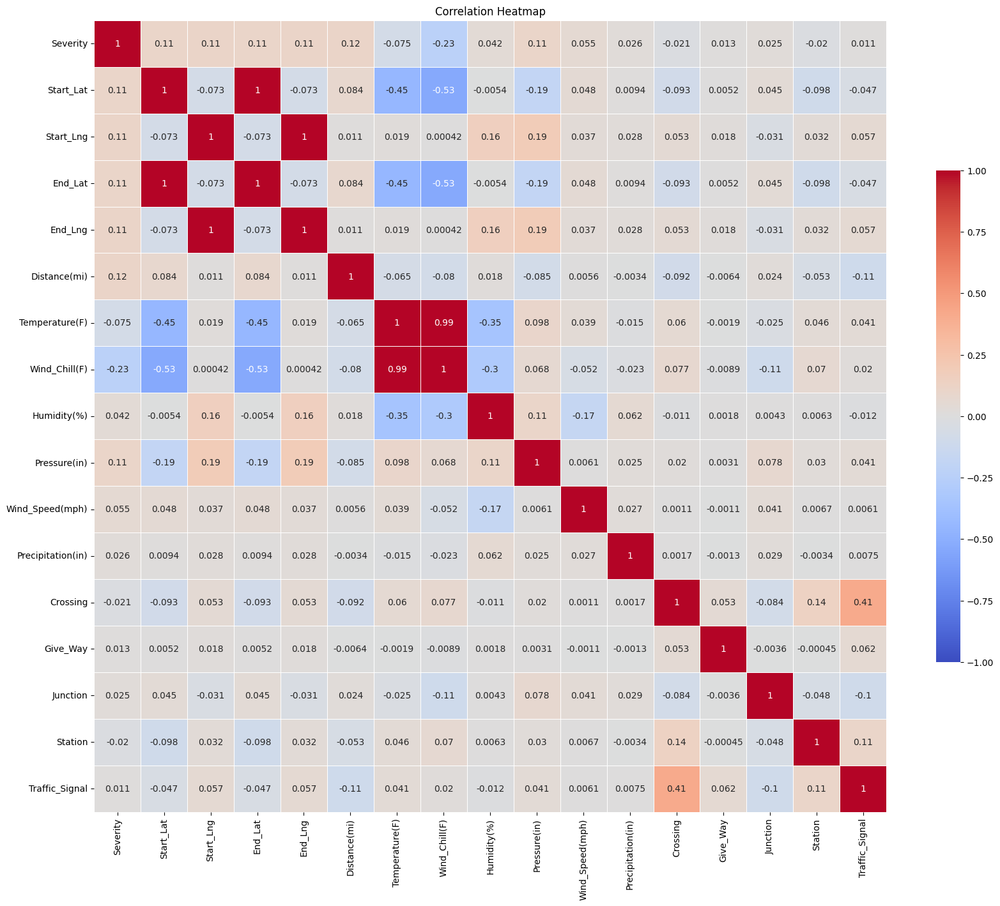

In [ ]:
correlation_heatmap()

In [ ]:
del data['Wind_Chill(F)']
del data['Start_Lat']
del data['Start_Lng']

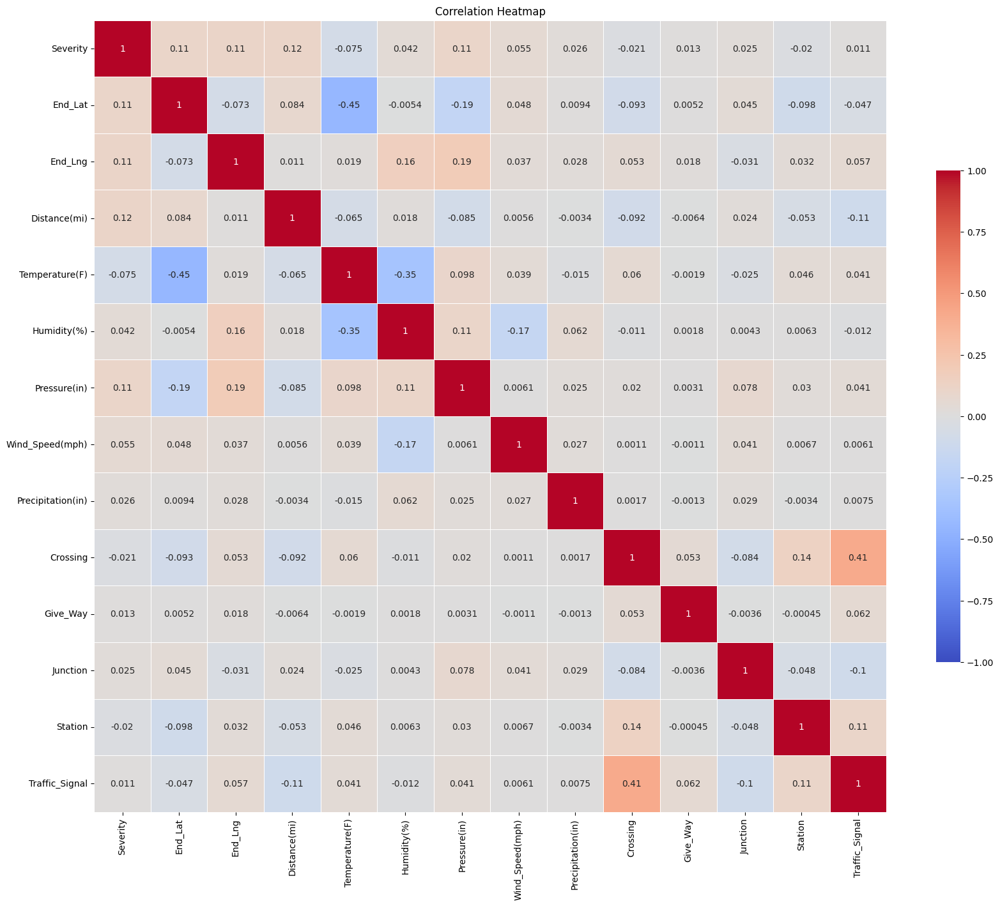

In [ ]:
correlation_heatmap()

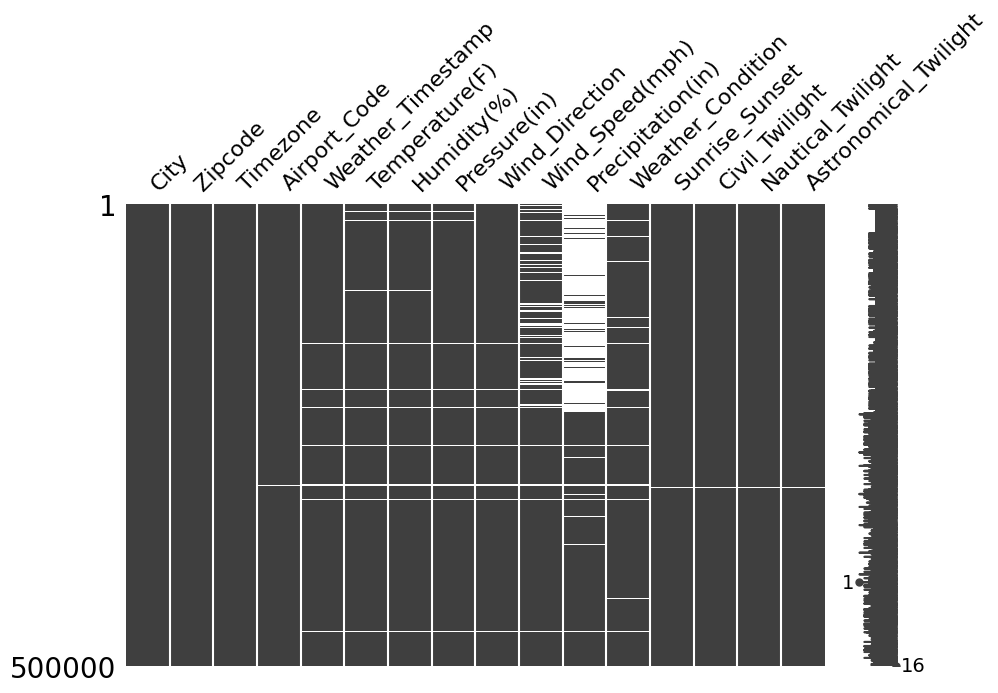

In [ ]:
null_columns=list(data.columns[data.isnull().any()])
missingno.matrix(data[null_columns],figsize=(10, 6));

In [ ]:
state_counts=data["State"].value_counts()
fig=plotly.graph_objects.Figure(data=plotly.graph_objects.Choropleth(locations=state_counts.index,z=state_counts.values.astype(float),locationmode="USA-states",colorscale="turbo"))
fig.update_layout(geo_scope="usa")
fig.show()

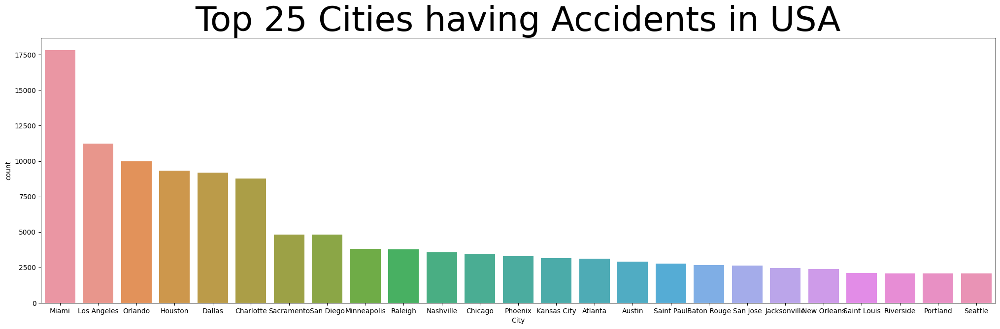

In [ ]:
fig,ax=plt.subplots(figsize=(25,7))
sns.countplot(x="City",data=data,order=data.City.value_counts().iloc[:25].index)
plt.title('Top 25 Cities having Accidents in USA',fontsize=50)
plt.show()

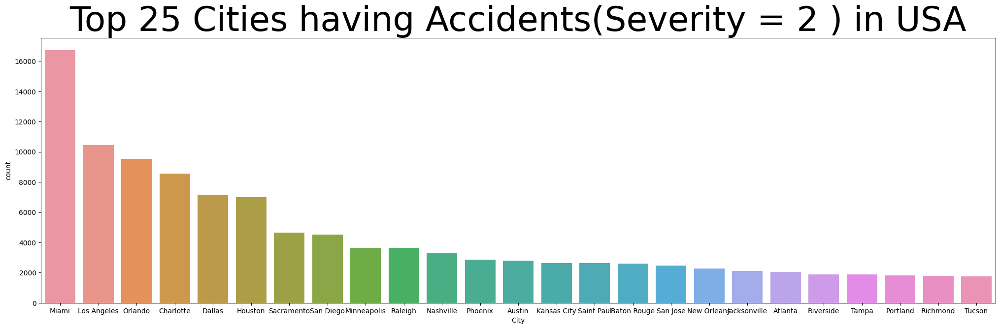

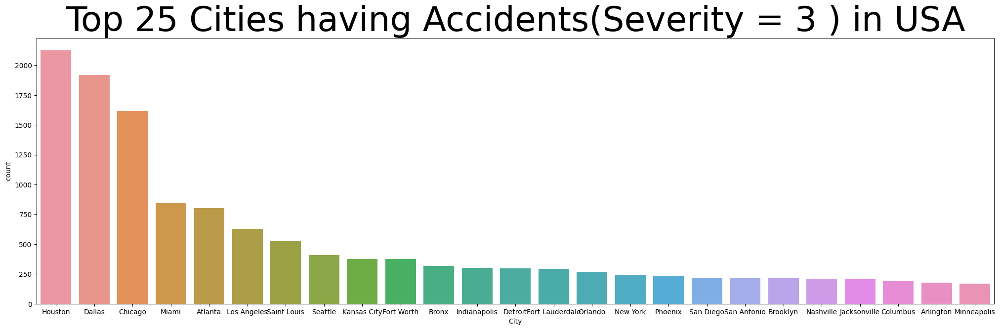

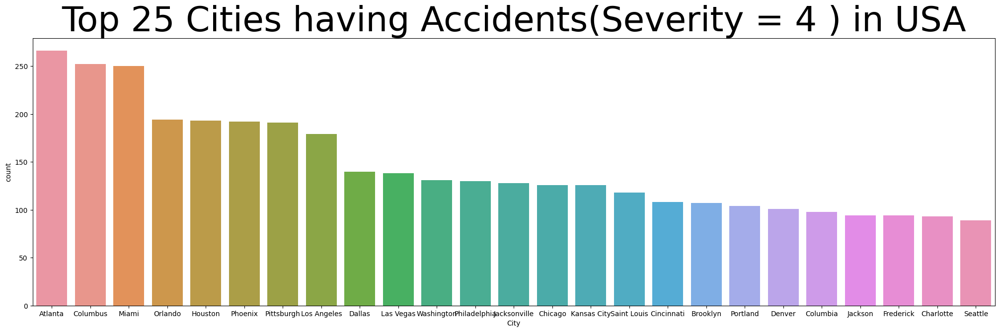

In [ ]:
for severity in set(data['Severity']):
    severity_data=data[data['Severity']==severity]
    fig,ax=plt.subplots(figsize=(25,7))
    sns.countplot(x="City",data=severity_data,order=severity_data.City.value_counts().iloc[:25].index)
    plt.title(f'Top 25 Cities having Accidents(Severity = {severity} ) in USA',fontsize=50)
    plt.show()

In [ ]:
data.End_Time=pd.to_datetime(data.End_Time)
data['Month']=data['End_Time'].dt.month
data['Year']=data['End_Time'].dt.year
data['Hour']=data['End_Time'].dt.hour
data['Weekday']=data['End_Time'].dt.weekday

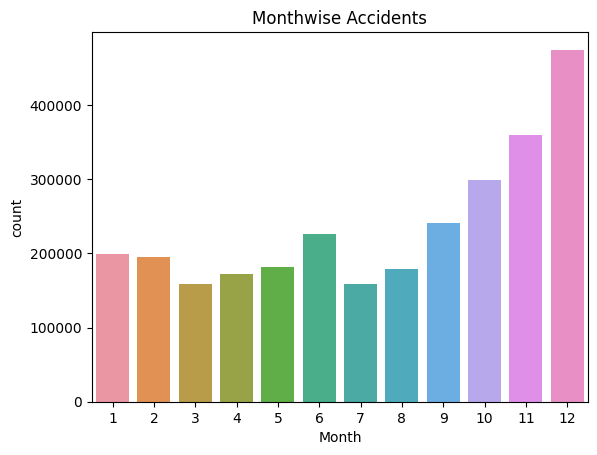

In [ ]:
sns.countplot(x="Month",data=data)
plt.title('Monthwise Accidents')
plt.show()

In [ ]:
print(set(data['Year']))

{2016, 2017, 2018, 2019, 2020, 2021, 2022}


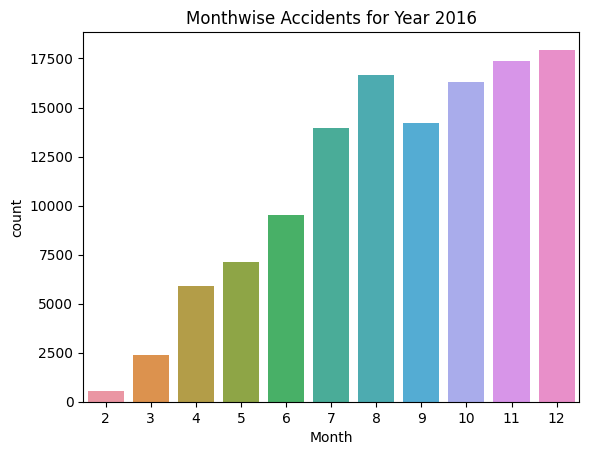

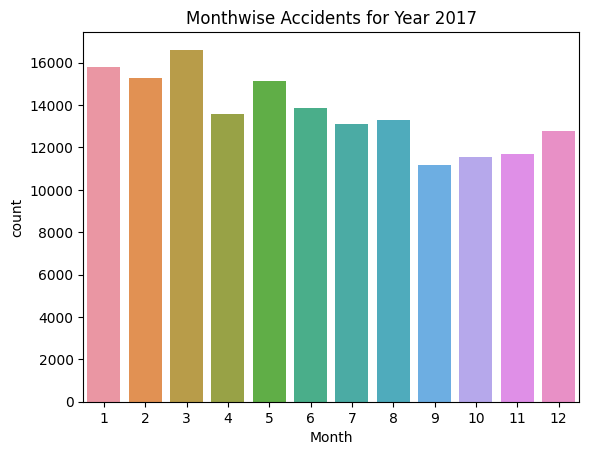

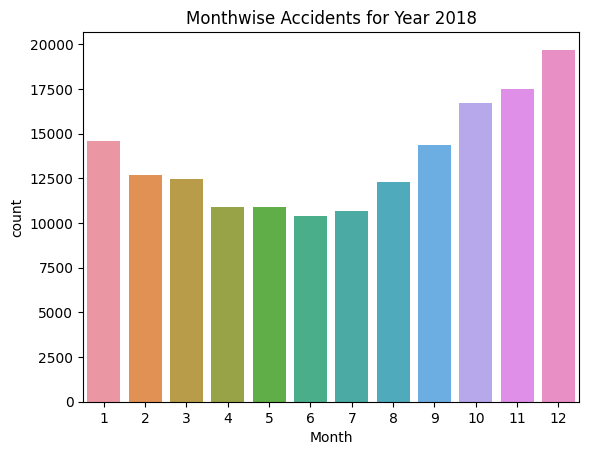

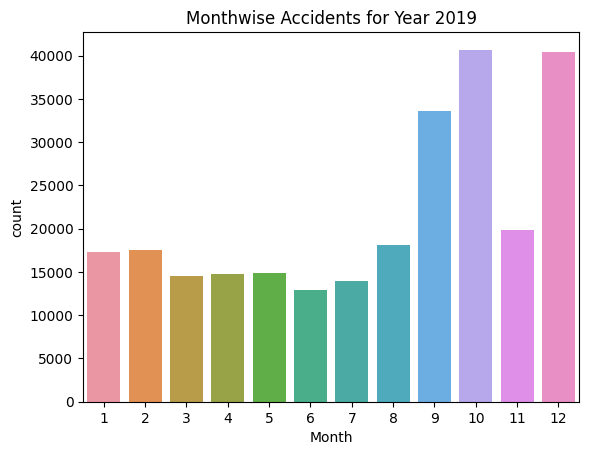

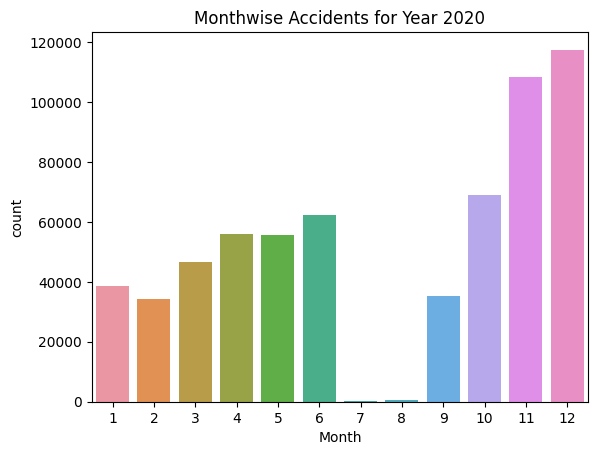

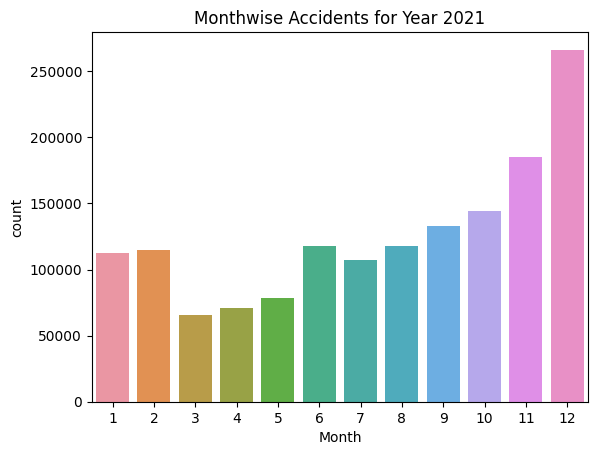

In [ ]:
for year in set(data['Year']):
    if(year!=2022):
        yearwise_data=data[data['Year']==year]
        sns.countplot(x="Month",data=yearwise_data)
        plt.title(f'Monthwise Accidents for Year {year}')
        plt.show()

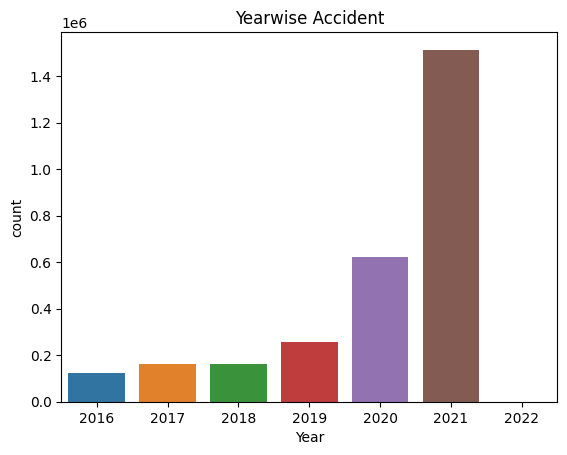

In [ ]:
sns.countplot(x='Year',data=data)
plt.title('Yearwise Accident')
plt.show()

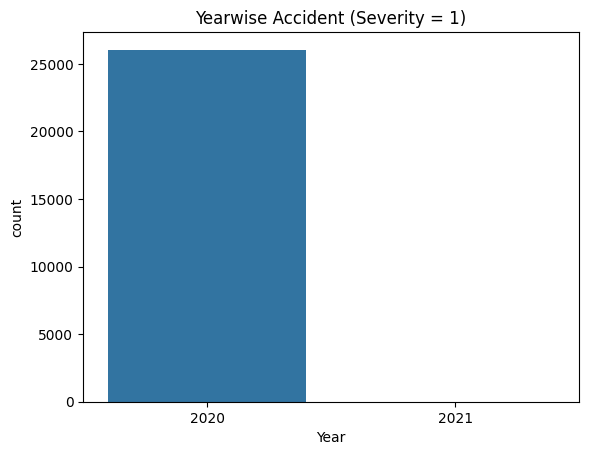

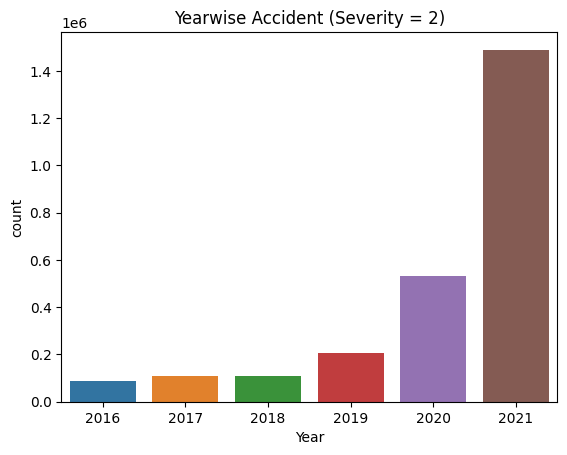

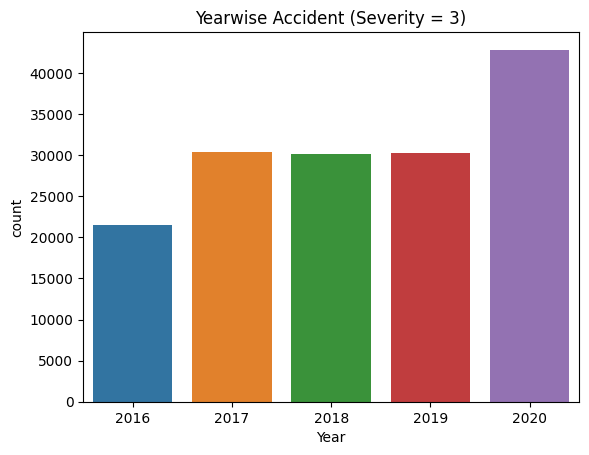

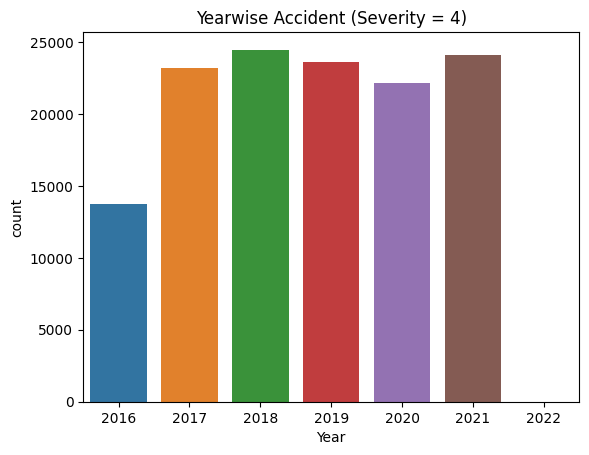

In [ ]:
for severity in set(data['Severity']):
    severity_data=data[data['Severity']==severity]
    sns.countplot(x='Year',data=severity_data)
    plt.title(f'Yearwise Accident (Severity = {severity})')
    plt.show()

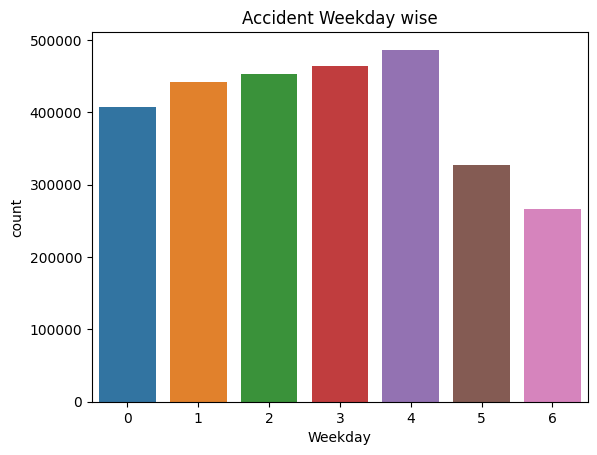

In [ ]:
sns.countplot(x='Weekday',data=data)
plt.title('Accident Weekday wise')
plt.show()

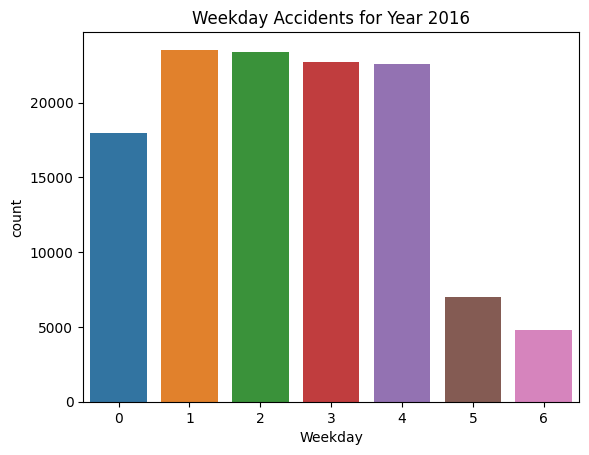

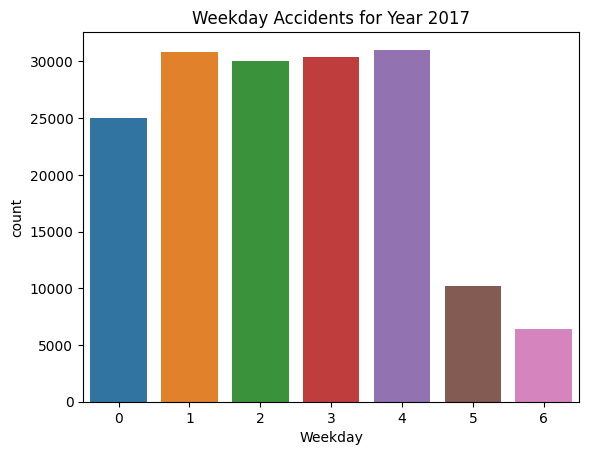

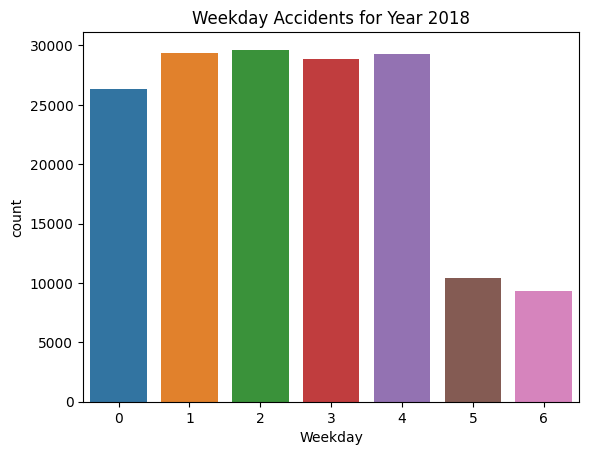

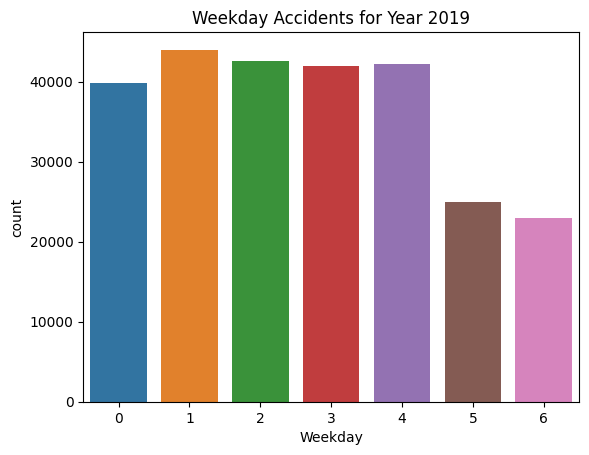

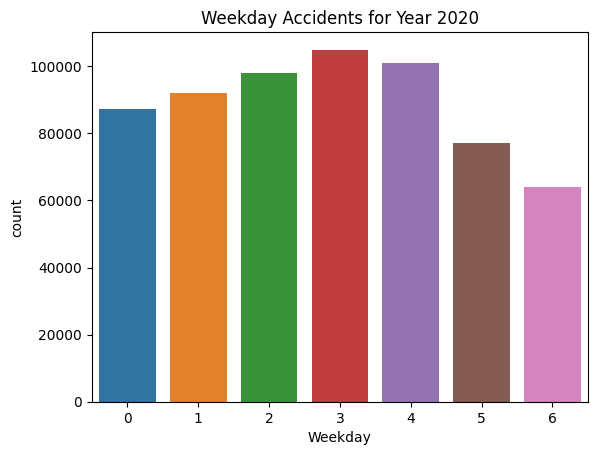

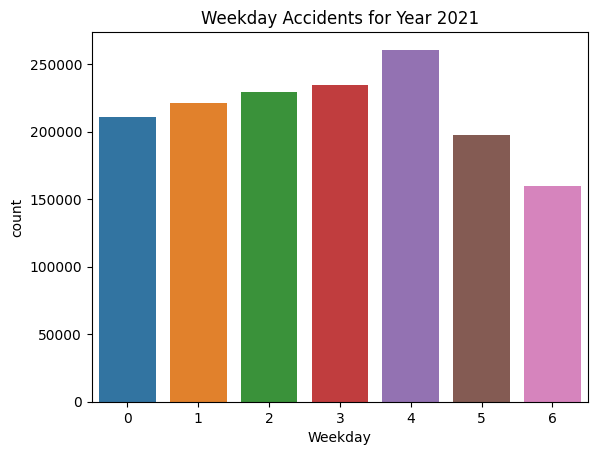

In [ ]:
for year in set(data['Year']):
    if(year!=2022):
        yearwise_data=data[data['Year']==year]
        sns.countplot(x="Weekday",data=yearwise_data)
        plt.title(f'Weekday Accidents for Year {year}')
        plt.show()

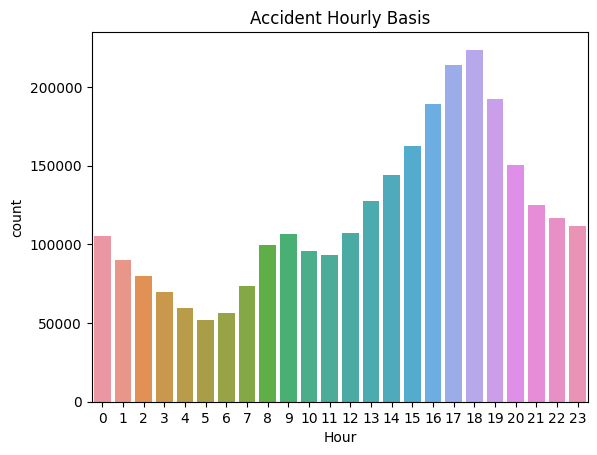

In [ ]:
sns.countplot(x='Hour',data=data)
plt.title('Accident Hourly Basis')
plt.show()

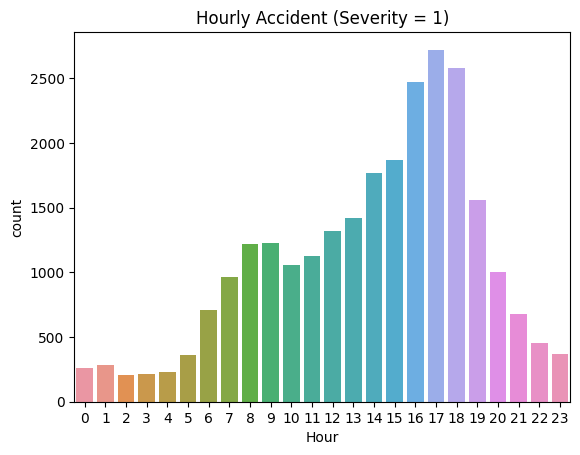

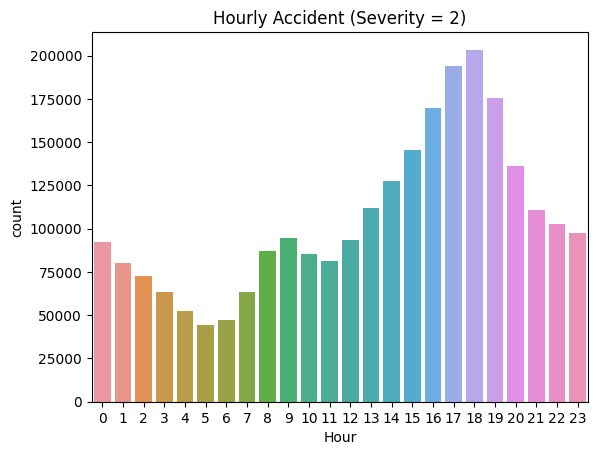

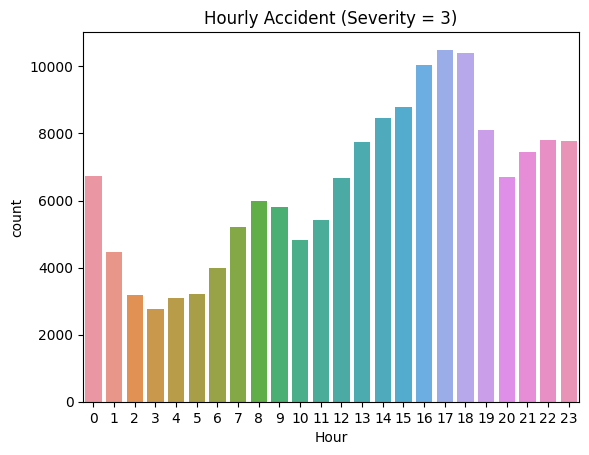

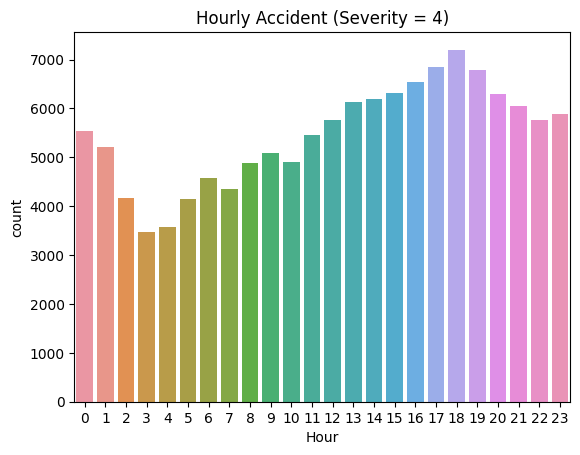

In [ ]:
for severity in set(data['Severity']):
    severity_data=data[data['Severity']==severity]
    sns.countplot(x='Hour',data=severity_data)
    plt.title(f'Hourly Accident (Severity = {severity})')
    plt.show()

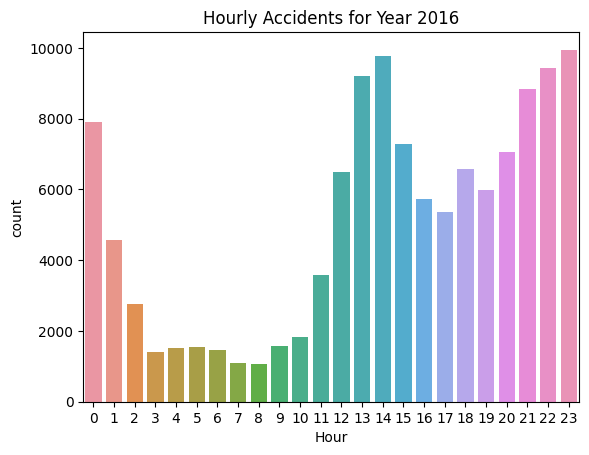

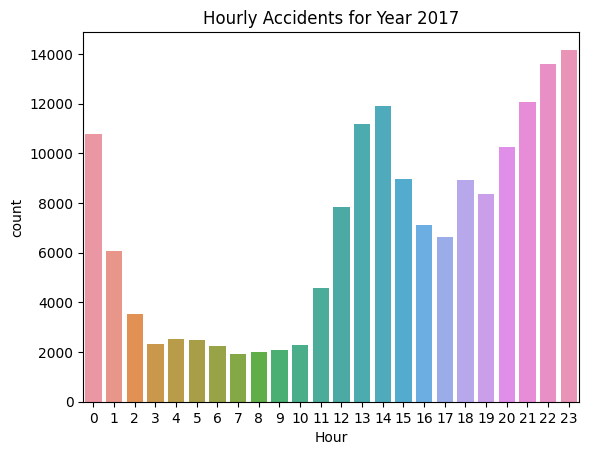

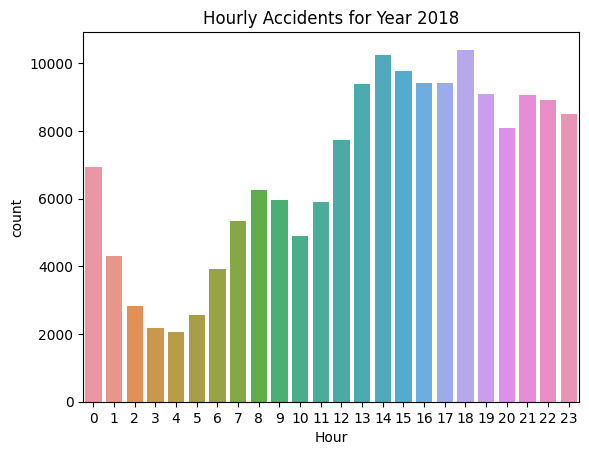

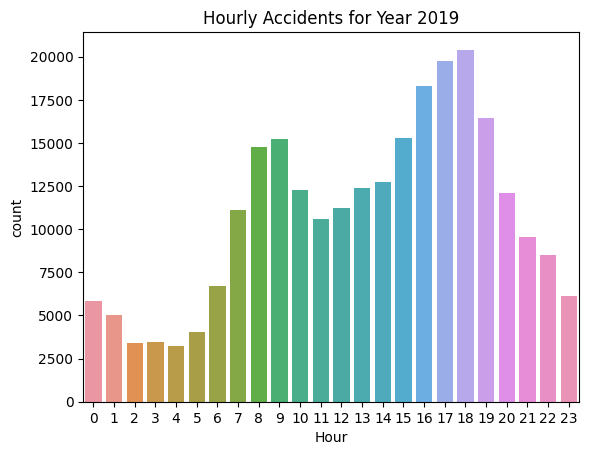

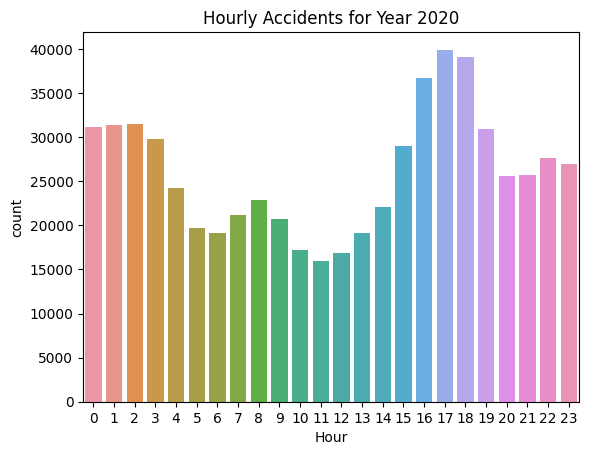

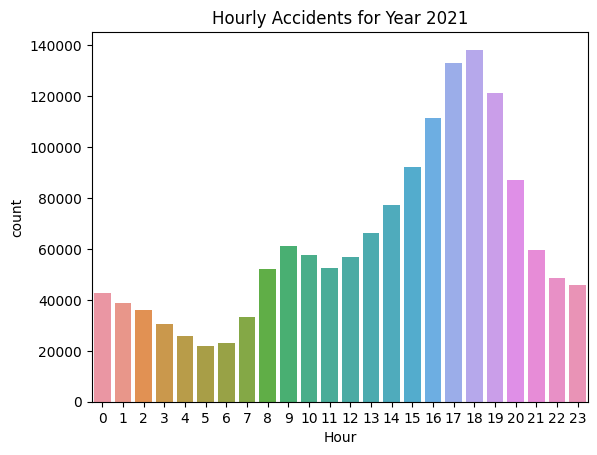

In [ ]:
for year in set(data['Year']):
    if(year!=2022):
        yearwise_data=data[data['Year']==year]
        sns.countplot(x="Hour",data=yearwise_data)
        plt.title(f'Hourly Accidents for Year {year}')
        plt.show()

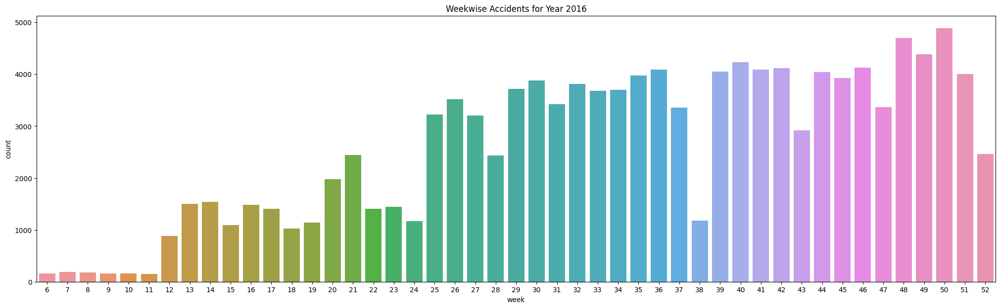

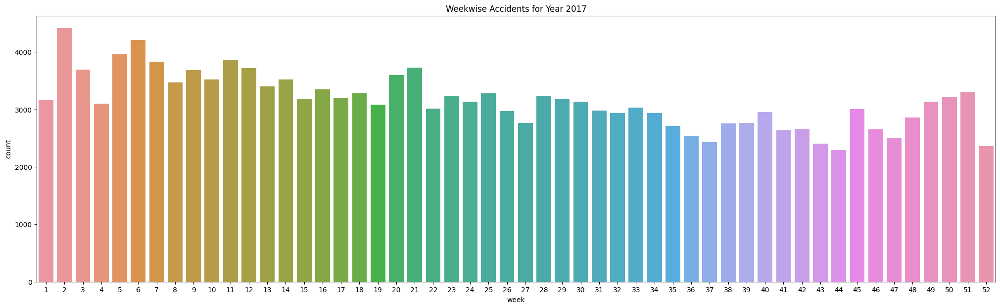

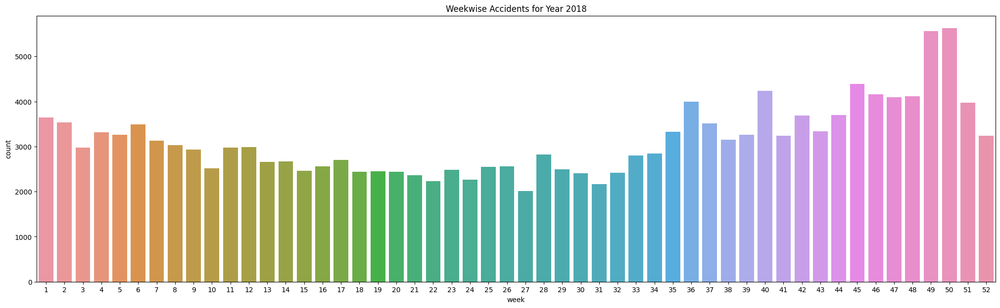

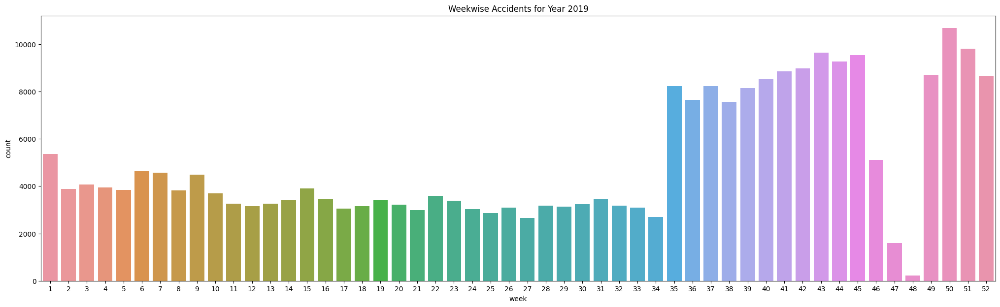

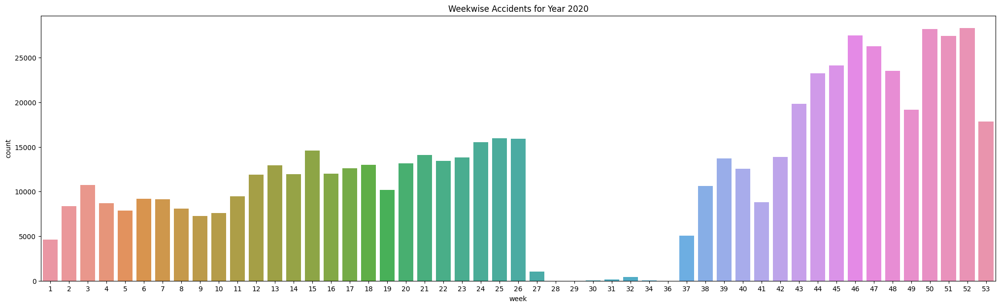

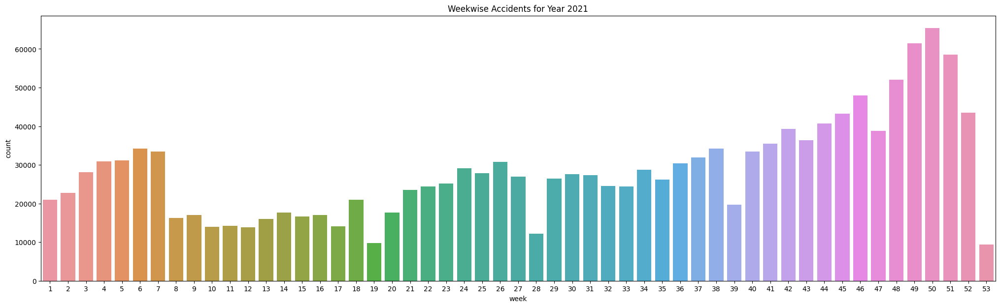

In [ ]:
for year in set(data['Year']):
    if(year!=2022):
        fig,ax=plt.subplots(figsize=(25,7))
        yearwise_data=data[data['Year']==year]
        sns.countplot(x=yearwise_data.End_Time.dt.isocalendar().week,data=yearwise_data)
        plt.title(f'Weekwise Accidents for Year {year}')
        plt.show()

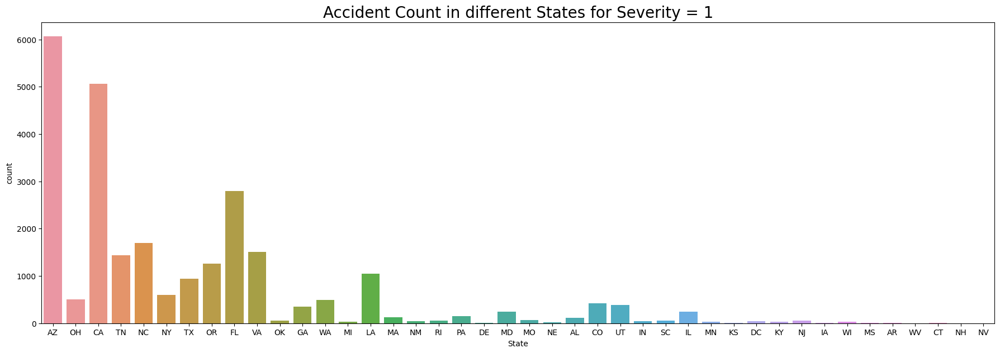

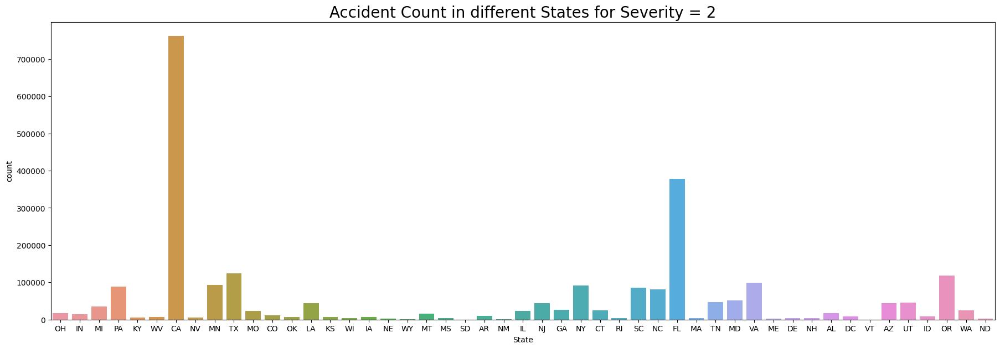

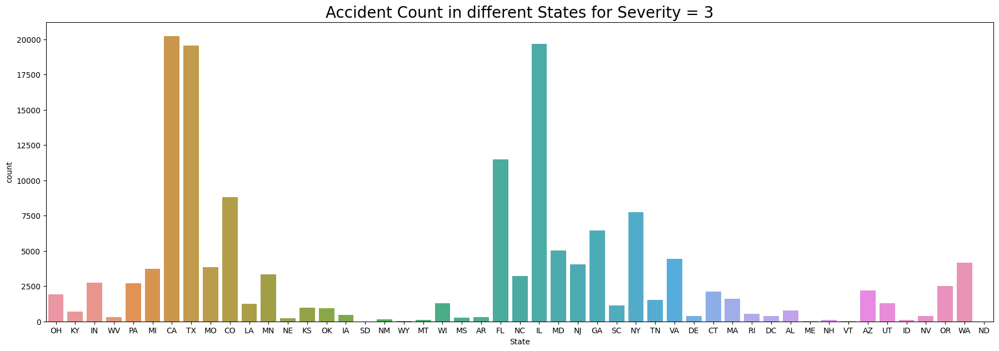

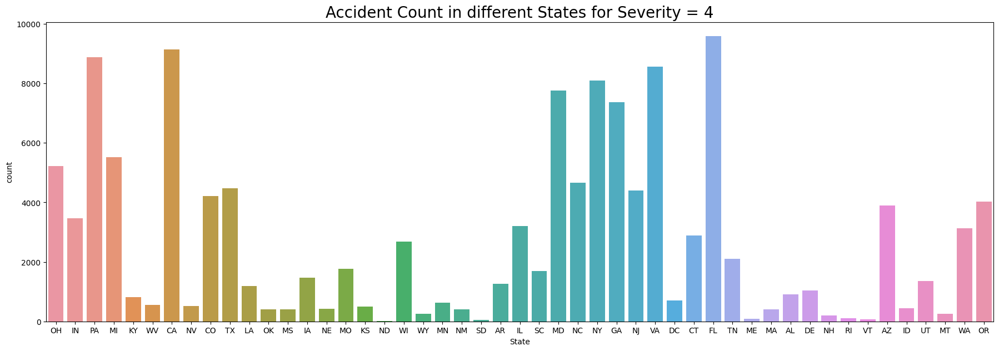

In [ ]:
for severity in set(data['Severity']):
    fig,ax=plt.subplots(figsize=(22,7))
    severity_data=data[data['Severity']==severity]
    sns.countplot(x='State',data=severity_data)
    plt.title(f'Accident Count in different States for Severity = {severity}',fontsize=20)
    plt.show()

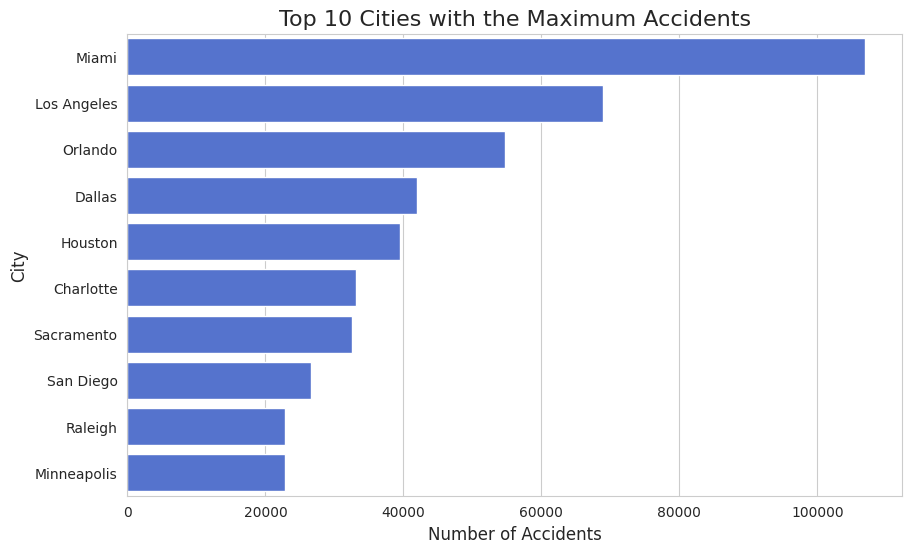

In [ ]:
top_cities = data['City'].value_counts().head(10)
sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
sns.barplot(x=top_cities.values, y=top_cities.index, color='royalblue')
plt.title('Top 10 Cities with the Maximum Accidents', fontsize=16)
plt.xlabel('Number of Accidents', fontsize=12)
plt.ylabel('City', fontsize=12)
plt.show()

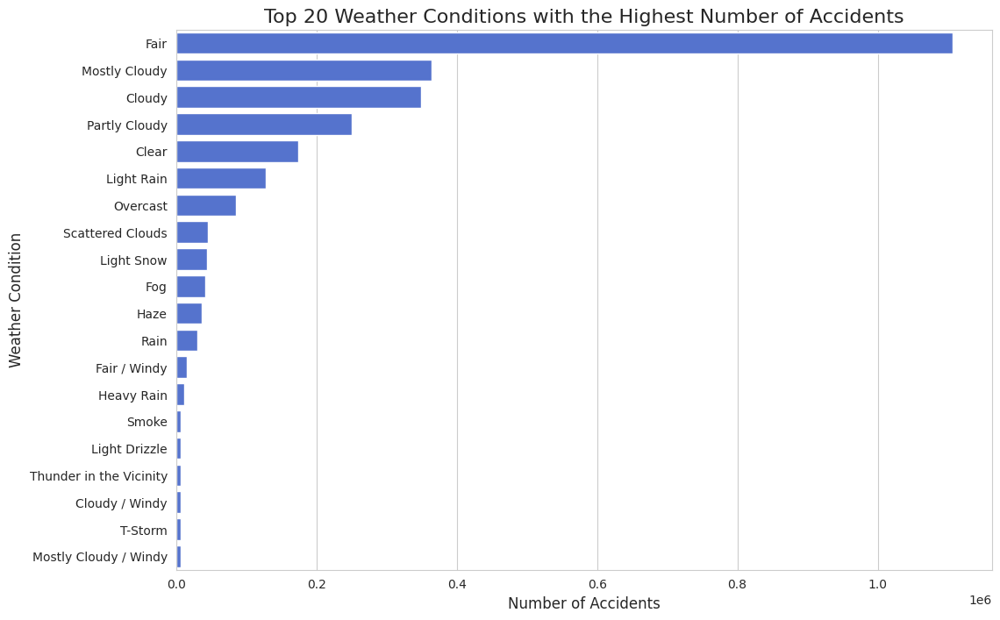

In [ ]:
weather_counts = data['Weather_Condition'].value_counts()
sorted_weather_counts = weather_counts.sort_values(ascending=False)
top_weather_conditions = sorted_weather_counts.head(20)
sns.set_style("whitegrid")
plt.figure(figsize=(12, 8))
sns.barplot(x=top_weather_conditions.values,y=top_weather_conditions.index,color='royalblue')
plt.title('Top 20 Weather Conditions with the Highest Number of Accidents', fontsize=16)
plt.xlabel('Number of Accidents', fontsize=12)
plt.ylabel('Weather Condition', fontsize=12)
plt.show()

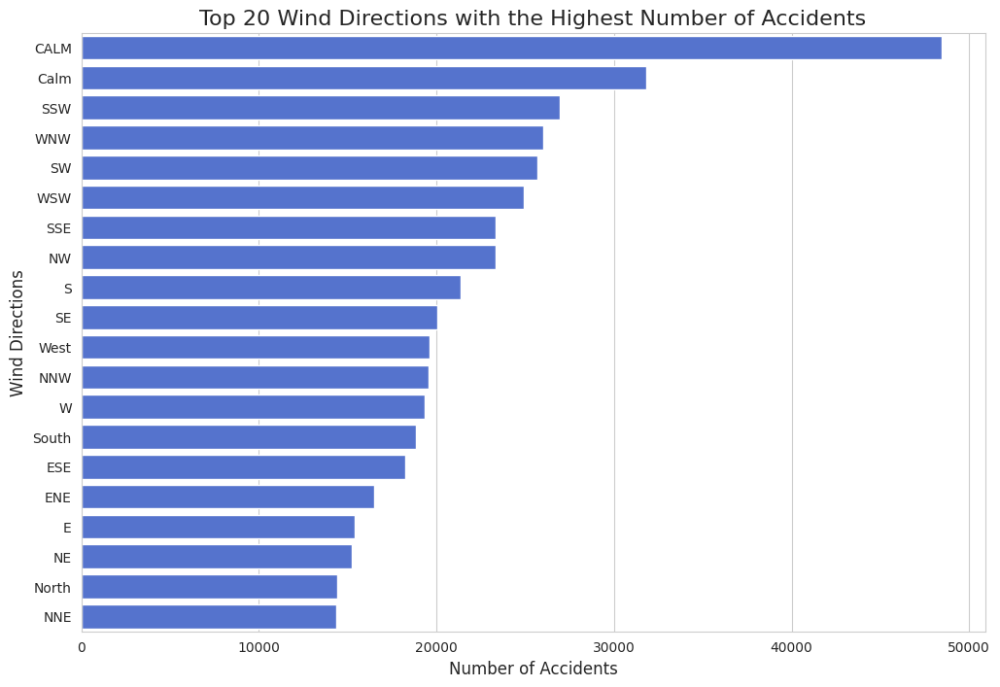

In [ ]:
weather_counts = data['Wind_Direction'].value_counts()
sorted_weather_counts = weather_counts.sort_values(ascending=False)
top_weather_conditions = sorted_weather_counts.head(20)
sns.set_style("whitegrid")
plt.figure(figsize=(12, 8))
sns.barplot(x=top_weather_conditions.values,y=top_weather_conditions.index,color='royalblue')
plt.title('Top 20 Wind Directions with the Highest Number of Accidents', fontsize=16)
plt.xlabel('Number of Accidents', fontsize=12)
plt.ylabel('Wind Directions', fontsize=12)
plt.show()

In [ ]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 500000 entries, 0 to 499999
Data columns (total 37 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   ID                     500000 non-null  object        
 1   Severity               500000 non-null  int64         
 2   Start_Time             500000 non-null  object        
 3   End_Time               500000 non-null  datetime64[ns]
 4   End_Lat                500000 non-null  float64       
 5   End_Lng                500000 non-null  float64       
 6   Distance(mi)           500000 non-null  float64       
 7   Description            500000 non-null  object        
 8   Street                 500000 non-null  object        
 9   Side                   500000 non-null  object        
 10  City                   499965 non-null  object        
 11  County                 500000 non-null  object        
 12  State                  500000 non-null  obje

In [ ]:
def continuous_categorical(column_name):
    data[data['Severity']==2][column_name].plot(kind='kde',label='Severity = 2')
    data[data['Severity']==3][column_name].plot(kind='kde',label='Severity = 3')
    data[data['Severity']==4][column_name].plot(kind='kde',label='Severity = 4')
    plt.legend()
    plt.show()

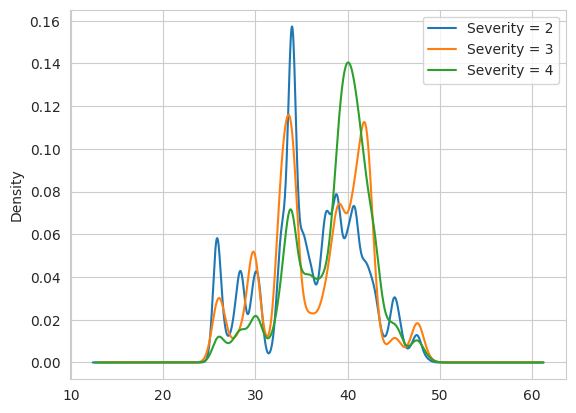

In [ ]:
continuous_categorical('End_Lat')

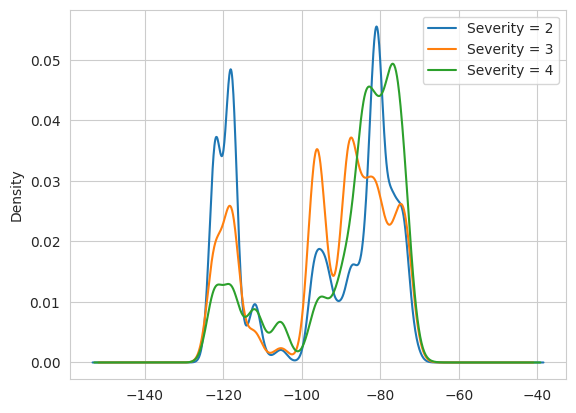

In [ ]:
continuous_categorical('End_Lng')

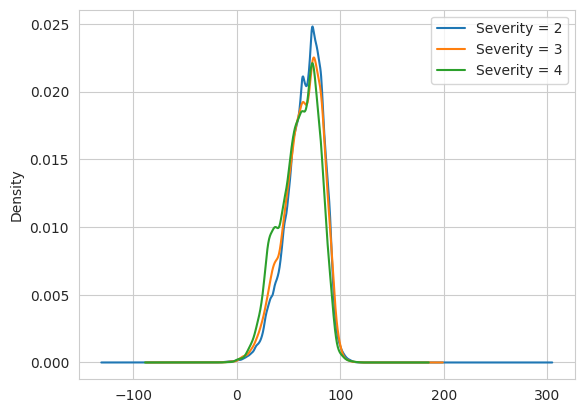

In [ ]:
continuous_categorical('Temperature(F)')

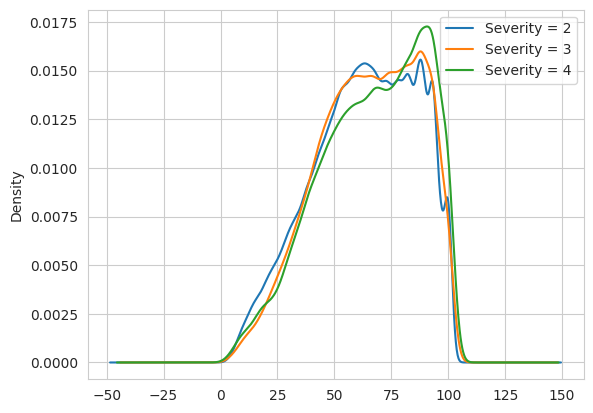

In [ ]:
continuous_categorical('Humidity(%)')

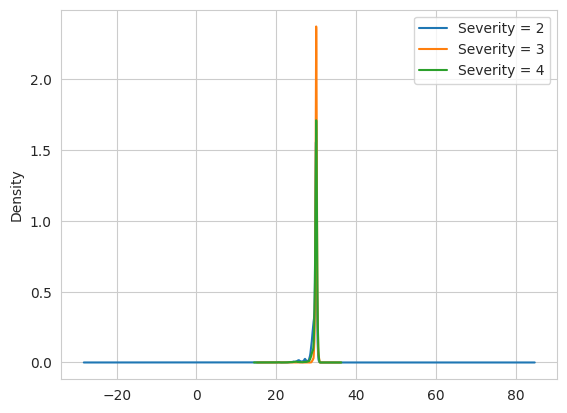

In [ ]:
continuous_categorical('Pressure(in)')

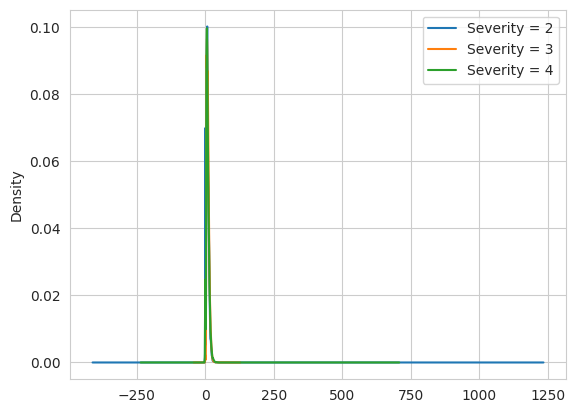

In [ ]:
continuous_categorical('Wind_Speed(mph)')

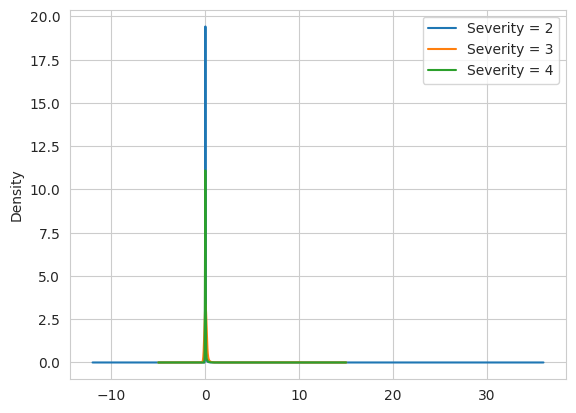

In [ ]:
continuous_categorical('Precipitation(in)')

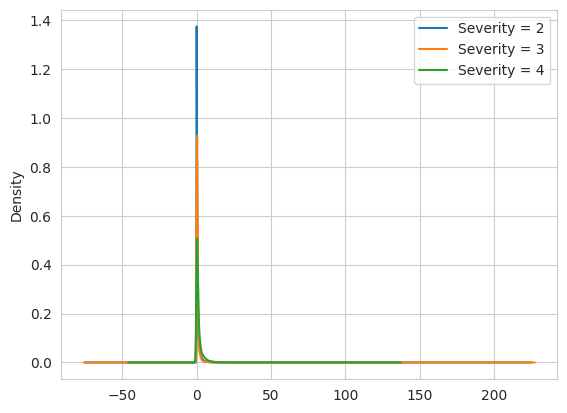

In [ ]:
continuous_categorical('Distance(mi)')

In [ ]:
obj_cols = list(data.select_dtypes(include=['object']).columns)
for col in obj_cols:
    print(f"Column '{col}' has {(len(data[col].unique())*100)/len(data)}% unique values:\n{data[col].unique()}\n")

Column 'ID' has 100.0% unique values:
['A-1' 'A-2' 'A-3' ... 'A-499998' 'A-499999' 'A-500000']

Column 'Start_Time' has 84.5184% unique values:
['2016-02-08 00:37:08' '2016-02-08 05:56:20' '2016-02-08 06:15:39' ...
 '2021-11-21 22:18:41.000000000' '2021-06-01 14:30:30.000000000'
 '2021-03-21 22:31:00.000000000']

Column 'Description' has 55.6746% unique values:
['Between Sawmill Rd/Exit 20 and OH-315/Olentangy Riv Rd/Exit 22 - Accident.'
 'At OH-4/OH-235/Exit 41 - Accident.' 'At I-71/US-50/Exit 1 - Accident.'
 ...
 'Incident on W MARTIN LUTHER KING BLVD near CHESTNUT ST Drive with caution.'
 'Incident on HOUSTON ST near OAK ST Drive with caution.'
 'Incident on DON JULIO BLVD near N LOOP BLVD Drive with caution.']

Column 'Street' has 13.0414% unique values:
['Outerbelt E' 'I-70 E' 'I-75 S' ... ' SE 17th St' 'Almond St'
 ' Dr Martin Luther King Jr St']

Column 'Side' has 0.0004% unique values:
['R' 'L']

Column 'City' has 1.865% unique values:
['Dublin' 'Dayton' 'Cincinnati' ... 'Yazoo

In [ ]:
del data['Description']
del data['Street']
del data['City']
del data['Zipcode']

In [ ]:
del data['Airport_Code']

In [ ]:
obj_cols = list(data.select_dtypes(include=['object']).columns)
for col in obj_cols:
    print(f"Column '{col}' has {(len(data[col].unique())*100)/len(data)}% unique values:\n{data[col].unique()}\n")

Column 'ID' has 100.0% unique values:
['A-1' 'A-2' 'A-3' ... 'A-499998' 'A-499999' 'A-500000']

Column 'Start_Time' has 84.5184% unique values:
['2016-02-08 00:37:08' '2016-02-08 05:56:20' '2016-02-08 06:15:39' ...
 '2021-11-21 22:18:41.000000000' '2021-06-01 14:30:30.000000000'
 '2021-03-21 22:31:00.000000000']

Column 'Side' has 0.0004% unique values:
['R' 'L']

Column 'County' has 0.3134% unique values:
['Franklin' 'Montgomery' 'Hamilton' ... 'Benson' 'Pipestone' 'Slope']

Column 'State' has 0.0098% unique values:
['OH' 'IN' 'KY' 'WV' 'MI' 'PA' 'CA' 'NV' 'MN' 'TX' 'MO' 'CO' 'OK' 'LA'
 'KS' 'WI' 'IA' 'MS' 'NE' 'ND' 'WY' 'SD' 'MT' 'NM' 'AR' 'IL' 'NJ' 'GA'
 'FL' 'NY' 'CT' 'RI' 'SC' 'NC' 'MD' 'MA' 'TN' 'VA' 'DE' 'DC' 'ME' 'AL'
 'NH' 'VT' 'AZ' 'UT' 'ID' 'OR' 'WA']

Column 'Timezone' has 0.001% unique values:
['US/Eastern' 'US/Pacific' nan 'US/Central' 'US/Mountain']

Column 'Weather_Timestamp' has 29.7942% unique values:
['2016-02-08 00:53:00' '2016-02-08 05:58:00' '2016-02-08 05:53:00' 

In [ ]:
del data['ID']

In [ ]:
obj_cols = list(data.select_dtypes(include=['object']).columns)
for col in obj_cols:
    print(f"Column '{col}' has {(len(data[col].unique())*100)/len(data)}% unique values:\n{data[col].unique()}\n")

Column 'Start_Time' has 84.5184% unique values:
['2016-02-08 00:37:08' '2016-02-08 05:56:20' '2016-02-08 06:15:39' ...
 '2021-11-21 22:18:41.000000000' '2021-06-01 14:30:30.000000000'
 '2021-03-21 22:31:00.000000000']

Column 'Side' has 0.0004% unique values:
['R' 'L']

Column 'County' has 0.3134% unique values:
['Franklin' 'Montgomery' 'Hamilton' ... 'Benson' 'Pipestone' 'Slope']

Column 'State' has 0.0098% unique values:
['OH' 'IN' 'KY' 'WV' 'MI' 'PA' 'CA' 'NV' 'MN' 'TX' 'MO' 'CO' 'OK' 'LA'
 'KS' 'WI' 'IA' 'MS' 'NE' 'ND' 'WY' 'SD' 'MT' 'NM' 'AR' 'IL' 'NJ' 'GA'
 'FL' 'NY' 'CT' 'RI' 'SC' 'NC' 'MD' 'MA' 'TN' 'VA' 'DE' 'DC' 'ME' 'AL'
 'NH' 'VT' 'AZ' 'UT' 'ID' 'OR' 'WA']

Column 'Timezone' has 0.001% unique values:
['US/Eastern' 'US/Pacific' nan 'US/Central' 'US/Mountain']

Column 'Weather_Timestamp' has 29.7942% unique values:
['2016-02-08 00:53:00' '2016-02-08 05:58:00' '2016-02-08 05:53:00' ...
 '2021-08-11 01:41:00' '2021-11-21 22:15:00' '2021-03-21 21:00:00']

Column 'Wind_Direction'

In [ ]:
def get_date_month_year_hour(column_name):
    data[column_name]=pd.to_datetime(data[column_name])
    data[str(column_name)+'Month']=data[column_name].dt.month
    data[str(column_name)+'Year']=data[column_name].dt.year
    data[str(column_name)+'Hour']=data[column_name].dt.hour
    data[str(column_name)+'Weekday']=data[column_name].dt.weekday
    del data[column_name]

In [ ]:
get_date_month_year_hour('Start_Time')
get_date_month_year_hour('Weather_Timestamp')
del data['End_Time']

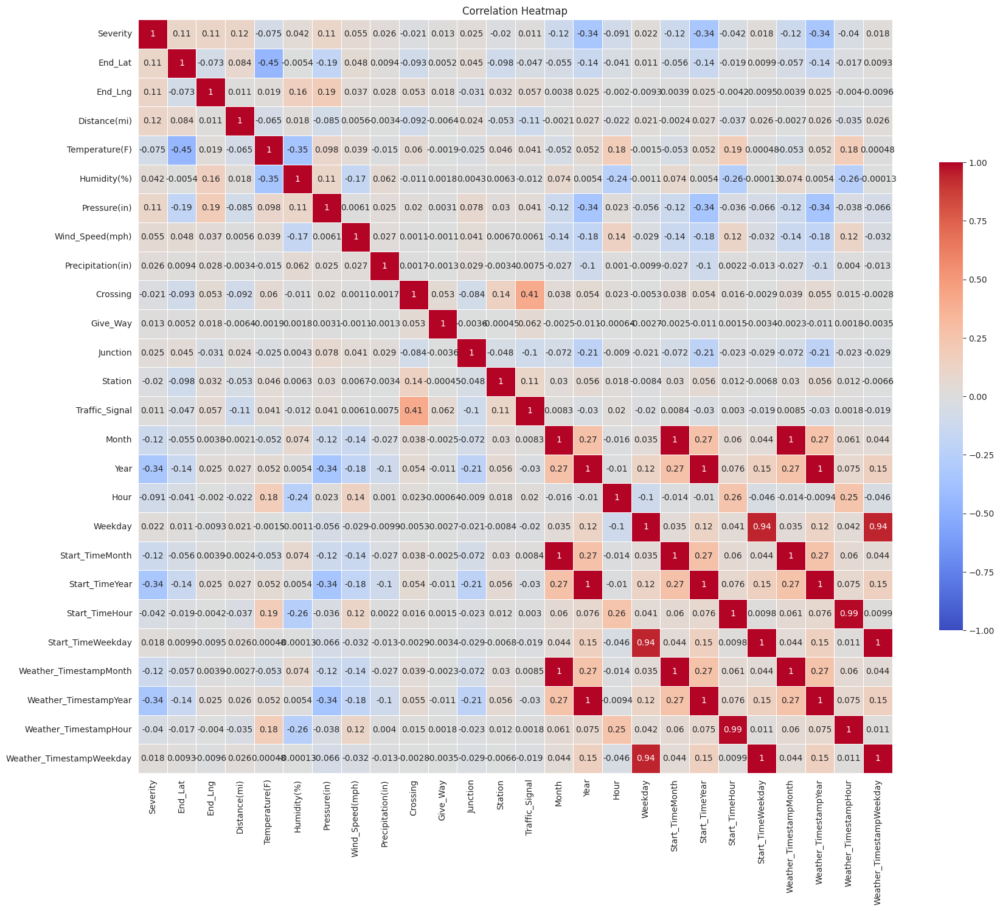

In [ ]:
correlation_heatmap()

In [ ]:
del data['Start_TimeMonth']
del data['Start_TimeYear']
del data['Start_TimeHour']
del data['Start_TimeWeekday']

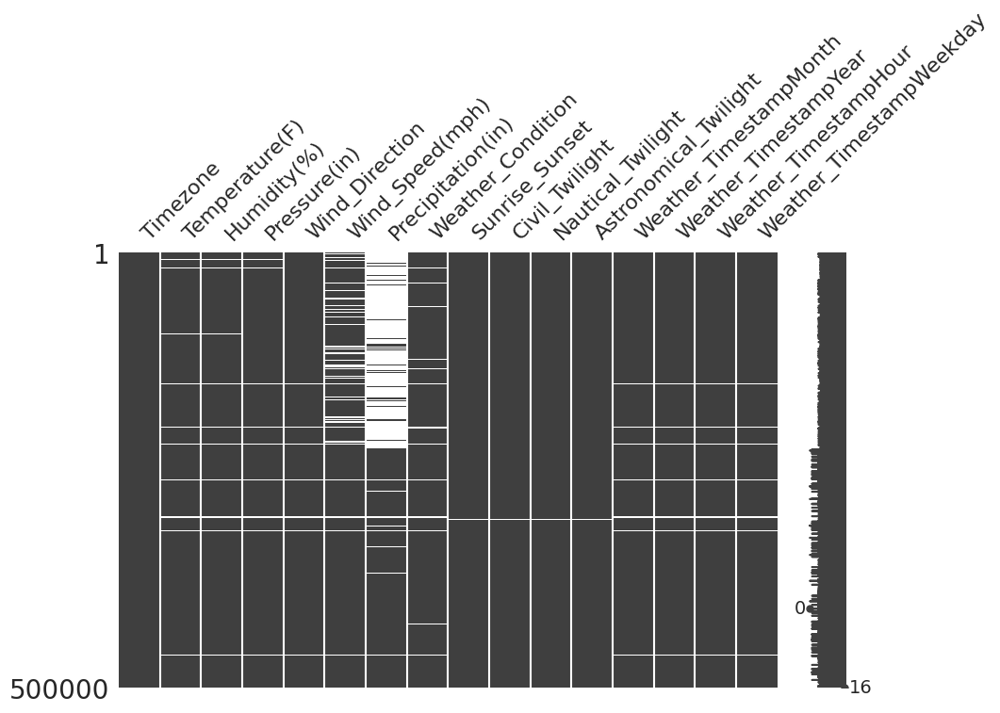

In [ ]:
null_columns=list(data.columns[data.isnull().any()])
missingno.matrix(data[null_columns],figsize=(10,6));

In [ ]:
sample_data=data.sample(int(0.5*len(data)))

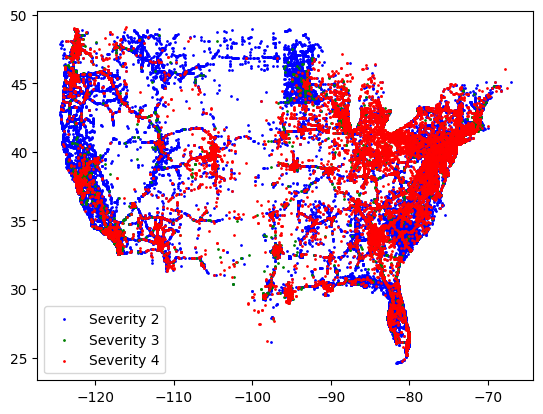

In [ ]:
severity_2=sample_data[sample_data['Severity']==2]
severity_3=sample_data[sample_data['Severity']==3]
severity_4=sample_data[sample_data['Severity']==4]
fig, ax = plt.subplots()
ax.scatter(severity_2['End_Lng'], severity_2['End_Lat'], c='blue', label='Severity 2',s=1)
ax.scatter(severity_3['End_Lng'], severity_3['End_Lat'], c='green', label='Severity 3',s=1)
ax.scatter(severity_4['End_Lng'], severity_4['End_Lat'], c='red', label='Severity 4',s=1)
ax.legend()
plt.show()

<Axes: xlabel='End_Lng', ylabel='End_Lat'>

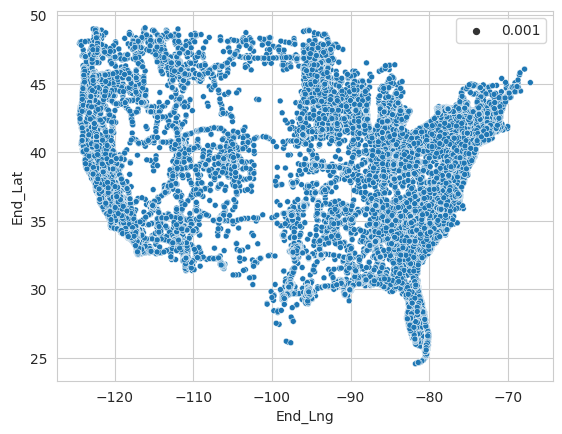

In [ ]:
sns.scatterplot(x=sample_data.End_Lng,y=sample_data.End_Lat,size=0.001)

In [ ]:
print(data['Timezone'].unique())

['US/Eastern' 'US/Pacific' nan 'US/Central' 'US/Mountain']


<Axes: xlabel='Timezone', ylabel='count'>

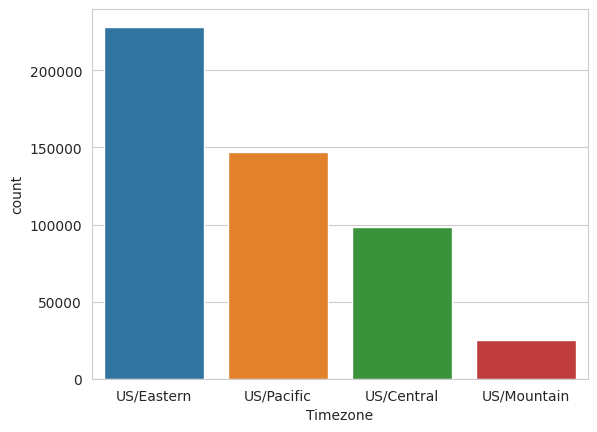

In [ ]:
sns.countplot(x='Timezone',data=data)

In [ ]:
#simple imputer Timezone
print(list(data['Temperature(F)'].value_counts()))
print(data['Temperature(F)'].isnull().sum()/len(data))
#simple imputer Mean Temperature and Humidity, Pressure

[12882, 11629, 10983, 10847, 10767, 10464, 10045, 9827, 9611, 9590, 9572, 9454, 9353, 8854, 8237, 8089, 7863, 7524, 7520, 7080, 6658, 6273, 6071, 5949, 5762, 5581, 5203, 5177, 5057, 4954, 4948, 4724, 4638, 4593, 4577, 4317, 4119, 4033, 3956, 3915, 3824, 3809, 3786, 3667, 3625, 3607, 3604, 3540, 3514, 3489, 3487, 3416, 3414, 3381, 3338, 3244, 3097, 3067, 3051, 2962, 2935, 2911, 2768, 2618, 2602, 2588, 2578, 2468, 2392, 2292, 2253, 2044, 2024, 2012, 1983, 1972, 1968, 1855, 1841, 1786, 1763, 1746, 1710, 1666, 1660, 1656, 1651, 1638, 1635, 1571, 1551, 1551, 1521, 1507, 1445, 1439, 1411, 1383, 1301, 1291, 1279, 1144, 1132, 1106, 1075, 1038, 1022, 1005, 1005, 979, 953, 949, 930, 913, 897, 860, 850, 809, 804, 798, 758, 731, 728, 711, 657, 654, 636, 628, 581, 571, 549, 540, 533, 520, 499, 498, 496, 486, 444, 439, 431, 397, 381, 379, 367, 360, 342, 334, 308, 282, 279, 245, 238, 238, 230, 229, 219, 203, 200, 195, 190, 181, 168, 164, 164, 163, 159, 158, 144, 139, 124, 120, 118, 118, 110, 109, 109

In [ ]:
print((data['Wind_Direction'].value_counts()))
print(data['Wind_Direction'].isnull().sum()/len(data))
#imputer most frequently

CALM        48467
Calm        31815
SSW         26967
WNW         26040
SW          25675
WSW         24913
SSE         23361
NW          23357
S           21365
SE          20037
West        19618
NNW         19542
W           19360
South       18843
ESE         18256
ENE         16494
E           15406
NE          15260
North       14391
NNE         14364
N           13690
VAR         13596
Variable    10246
East         9806
Name: Wind_Direction, dtype: int64
0.018262


In [ ]:
print((data['Precipitation(in)'].value_counts()))
print(data['Precipitation(in)'].isnull().sum()/len(data))
#so fill with 0.00

0.00     258225
0.01       8846
0.02       4422
0.03       2929
0.04       2330
          ...  
1.47          1
9.79          1
9.92          1
10.02         1
24.00         1
Name: Precipitation(in), Length: 171, dtype: int64
0.418034


In [ ]:
numeric_columns=['Temperature(F)','Humidity(%)','Pressure(in)','Wind_Speed(mph)']
data[numeric_columns]=data[numeric_columns].fillna(data[numeric_columns].mean())
categorical_columns=['Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
for col in categorical_columns:
    data[col].fillna(data[col].mode()[0],inplace=True)
data['Precipitation(in)'].fillna(0.00,inplace=True)

In [ ]:
print(data.isnull().sum())

Severity                    0
End_Lat                     0
End_Lng                     0
Distance(mi)                0
Side                        0
County                      0
State                       0
Timezone                    0
Temperature(F)              0
Humidity(%)                 0
Pressure(in)                0
Wind_Direction              0
Wind_Speed(mph)             0
Precipitation(in)           0
Weather_Condition           0
Crossing                    0
Give_Way                    0
Junction                    0
Station                     0
Traffic_Signal              0
Sunrise_Sunset              0
Civil_Twilight              0
Nautical_Twilight           0
Astronomical_Twilight       0
Month                       0
Year                        0
Hour                        0
Weekday                     0
Weather_TimestampMonth      0
Weather_TimestampYear       0
Weather_TimestampHour       0
Weather_TimestampWeekday    0
dtype: int64


In [ ]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 500000 entries, 0 to 499999
Data columns (total 32 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Severity                  500000 non-null  int64  
 1   End_Lat                   500000 non-null  float64
 2   End_Lng                   500000 non-null  float64
 3   Distance(mi)              500000 non-null  float64
 4   Side                      500000 non-null  object 
 5   County                    500000 non-null  object 
 6   State                     500000 non-null  object 
 7   Timezone                  500000 non-null  object 
 8   Temperature(F)            500000 non-null  float64
 9   Humidity(%)               500000 non-null  float64
 10  Pressure(in)              500000 non-null  float64
 11  Wind_Direction            500000 non-null  object 
 12  Wind_Speed(mph)           500000 non-null  float64
 13  Precipitation(in)         500000 non-null  f

In [ ]:
del data['County']

In [ ]:
for column in ['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight']:
    print(column)
    print(len(Counter(data[column])))

Side
2
State
49
Timezone
4
Wind_Direction
24
Weather_Condition
92
Sunrise_Sunset
2
Civil_Twilight
2
Nautical_Twilight
2
Astronomical_Twilight
2


In [ ]:
data_encoded=pd.get_dummies(data,columns=['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight'],drop_first=True)

In [ ]:
data=data_encoded.copy()

In [ ]:
output_data=data['Severity']
del data['Severity']
input_data=data

In [ ]:
print(input_data.info())

In [ ]:
print(input_data.shape)

(500000, 191)


In [ ]:
x_train,x_test,y_train,y_test=train_test_split(input_data,output_data,train_size=0.75,random_state=0)
x_train,x_validation,y_train,y_validation=train_test_split(x_train,y_train,train_size=60/75,random_state=1)

In [ ]:
columns=['End_Lat','End_Lng','Distance(mi)','Temperature(F)','Humidity(%)','Pressure(in)','Wind_Speed(mph)','Precipitation(in)','Month','Year','Hour','Weekday','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
scaler=StandardScaler()
scaler.fit(x_train[columns])
x_train[columns]=(scaler.transform(x_train[columns]))
x_validation[columns]=(scaler.transform(x_validation[columns]))
x_test[columns]=(scaler.transform(x_test[columns]))

## decision tree

Training accuracy: 0.9998266666666666
Testing accuracy: 0.838672
Accuracy: 0.838672


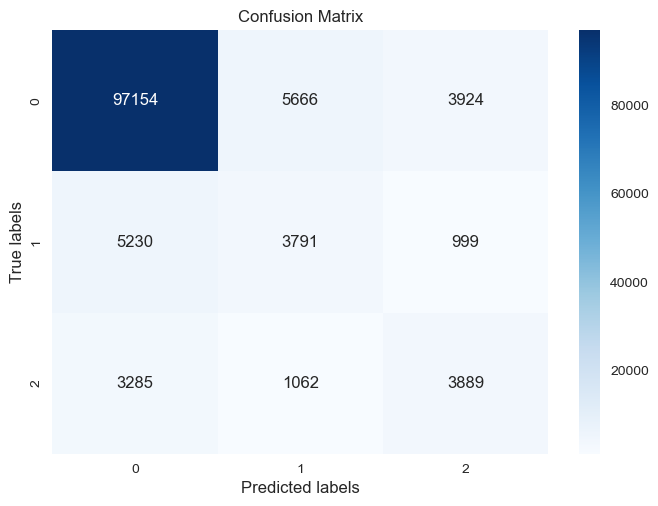

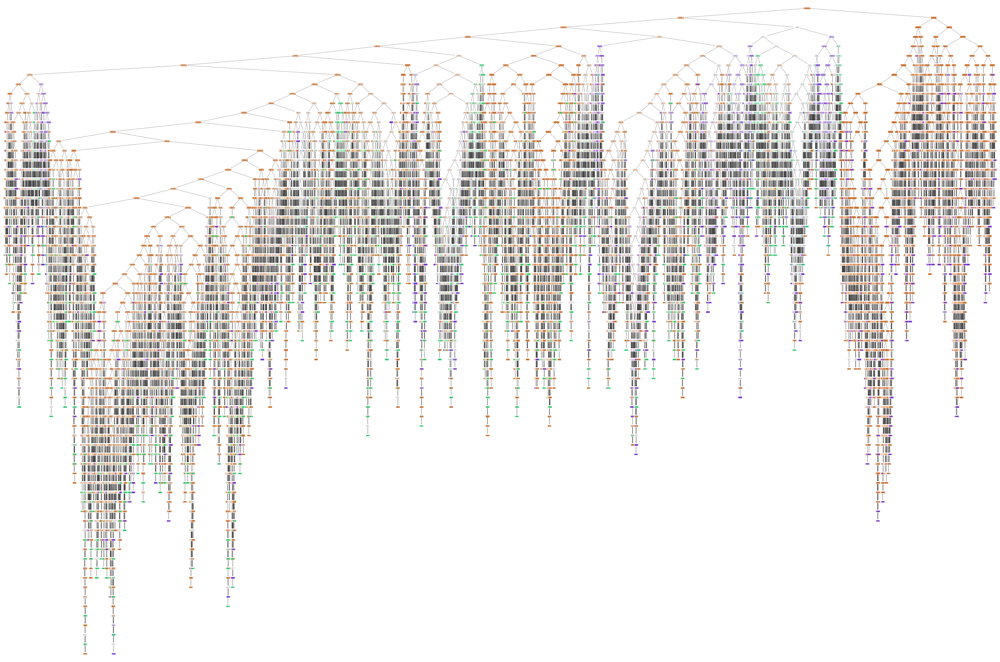

In [ ]:

# Create a Decision Tree Classifier
dtc = DecisionTreeClassifier(random_state=0)

# Fit the classifier to the training data
dtc.fit(x_train, y_train)

print("Training accuracy:", dtc.score(x_train, y_train))
print("Testing accuracy:", dtc.score(x_test, y_test)) 

# Evaluate the classifier on the testing data
y_pred = dtc.predict(x_test)
print("Accuracy:", accuracy_score(y_test, y_pred))


cm = confusion_matrix(y_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()



# Plot the decision tree
plt.figure(figsize=(36,24))
plot_tree(dtc, filled=True)
plt.show()




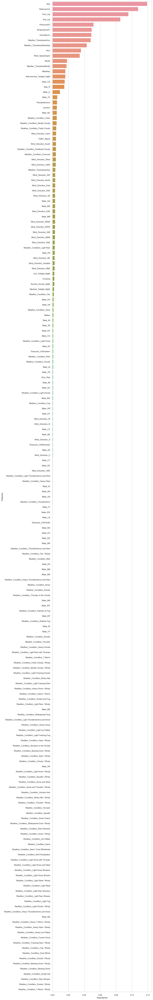

In [ ]:

# Get the feature importances using MDI
importances = dtc.feature_importances_
sorted_idx = importances.argsort()
col=list(input_data.columns)
plt.figure(figsize=(10,100))
# Plot the feature importances using MDI with Seaborn
sorted_idx=np.flip(sorted_idx)
sns.barplot(x=[importances[i] for i in sorted_idx], y=[col[i] for i in sorted_idx])
sns.set(style='whitegrid')
plt.xlabel('Importance')
plt.ylabel('Features')
plt.show()

In [ ]:
 pip install yellowbrick

Note: you may need to restart the kernel to use updated packages.


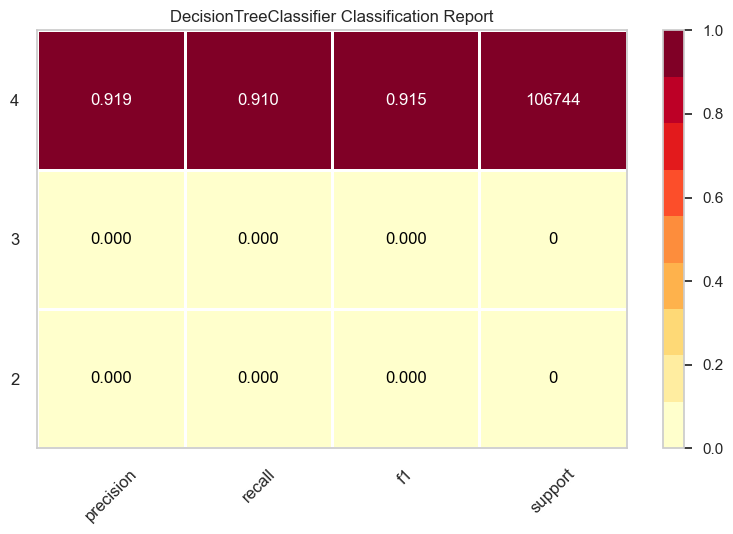

<Axes: title={'center': 'DecisionTreeClassifier Classification Report'}>

In [ ]:

visualizer = ClassificationReport(dtc, classes=list(Counter(y_train).keys()).sort(), support=True)

visualizer.fit(x_train, y_train)        # Fit the visualizer and the model
visualizer.score(x_test, y_test)        # Evaluate the model on the test data
visualizer.show() 

In [ ]:
from sklearn.model_selection import GridSearchCV

# Define the hyperparameters to search over
param_grid = {
    'max_depth': [2, 4, 6],
    'min_samples_split': [2, 4, 6],
    'min_samples_leaf': [1, 2, 3],
    'max_features': ['auto', 'sqrt', 'log2'],
    'criterion': ['gini', 'entropy']
}

# Define the grid search object
grid_search = GridSearchCV(dtc, param_grid, cv=5, scoring='accuracy')

# Train the grid search object
grid_search.fit(x_train, y_train)

# Print the best hyperparameters
print(grid_search.best_params_)

{'criterion': 'gini', 'max_depth': 6, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2}


In [ ]:
print(grid_search.best_score_)

0.8579066666666666


In [ ]:
# Make predictions on the test dataset using the best model
best_model = grid_search.best_estimator_
y_pred = best_model.predict(x_test)

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           2       0.86      1.00      0.92    106744
           3       0.72      0.09      0.17     10020
           4       0.33      0.00      0.00      8236

    accuracy                           0.86    125000
   macro avg       0.64      0.36      0.36    125000
weighted avg       0.81      0.86      0.80    125000



## GaussianNB

Training accuracy: 0.11736666666666666
Testing accuracy: 0.117096
Balanced accuracy: 0.3895202150695556
ROC score (one-vs-one): 0.6920219212102686
ROC score (one-vs-rest): 0.6576626492406757


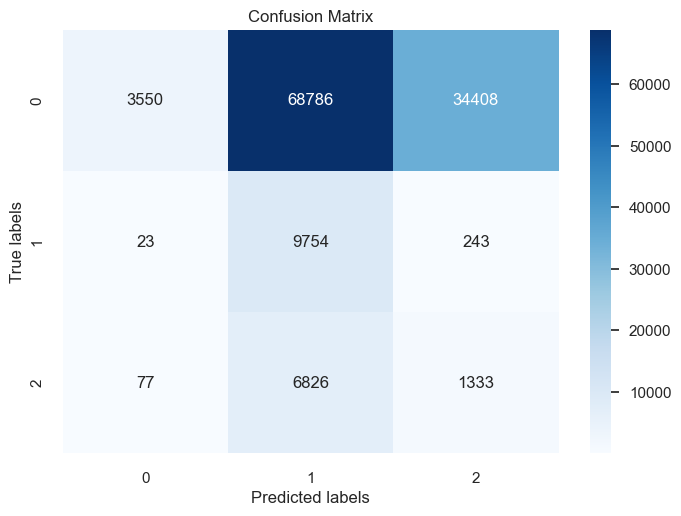

Classification Report:
               precision    recall  f1-score   support

           2       0.97      0.03      0.06    106744
           3       0.11      0.97      0.20     10020
           4       0.04      0.16      0.06      8236

    accuracy                           0.12    125000
   macro avg       0.37      0.39      0.11    125000
weighted avg       0.84      0.12      0.08    125000



In [ ]:
gnb = GaussianNB()
gnb.fit(x_train, y_train)

print("Training accuracy:", gnb.score(x_train, y_train))
print("Testing accuracy:", gnb.score(x_test, y_test)) 
# Make predictions on the testing set
y_pred = gnb.predict(x_test)
bal_acc = balanced_accuracy_score(y_test, y_pred)

print("Balanced accuracy:", bal_acc)

# Get ROC scores for one-vs-one classification
roc_ovo = roc_auc_score(y_test, gnb.predict_proba(x_test), multi_class='ovo')
print("ROC score (one-vs-one):", roc_ovo)

# Get ROC scores for one-vs-rest classification
roc_ovr = roc_auc_score(y_test, gnb.predict_proba(x_test), multi_class='ovr')
print("ROC score (one-vs-rest):", roc_ovr)

# Compute and print the confusion matrix
cm = confusion_matrix(y_test, y_pred)


# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# Compute and print the classification report
cr = classification_report(y_test, y_pred)
print("Classification Report:\n", cr)

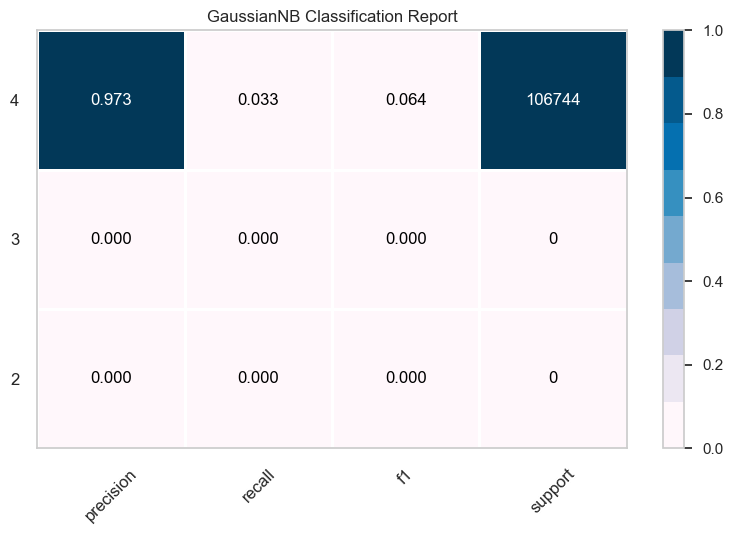

<Axes: title={'center': 'GaussianNB Classification Report'}>

In [ ]:
visualizer = ClassificationReport(gnb, support=True, cmap='PuBu')
visualizer.fit(x_train, y_train)
visualizer.score(x_test, y_test)

visualizer.show()

In [ ]:
from sklearn.model_selection import GridSearchCV

# Define the parameter grid
param_grid = {
    'var_smoothing': [1e-9, 1e-8, 1e-7, 1e-6, 1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10]
}

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=GaussianNB(), param_grid=param_grid, cv=5)

# Fit the grid search to the training data
grid_search.fit(x_train, y_train)

# Print the best parameter and the corresponding score
print("Best parameter:", grid_search.best_params_)
print("Best score:", grid_search.best_score_)


Best parameter: {'var_smoothing': 10}
Best score: 0.8549466666666667


In [ ]:
# Make predictions on the test dataset using the best model
best_model = grid_search.best_estimator_
y_pred = best_model.predict(x_test)

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           2       0.85      1.00      0.92    106744
           3       0.17      0.00      0.00     10020
           4       0.50      0.00      0.01      8236

    accuracy                           0.85    125000
   macro avg       0.51      0.33      0.31    125000
weighted avg       0.78      0.85      0.79    125000



## Random Forest




Training accuracy: 0.9997966666666667
Testing accuracy: 0.891232
Balanced accuracy: 0.5598400696873385
ROC score (one-vs-one): 0.8779368690143694
ROC score (one-vs-rest): 0.9133019806632238
Classification Report:
              precision    recall  f1-score   support

           2       0.90      0.99      0.94    106744
           3       0.67      0.27      0.39     10020
           4       0.76      0.42      0.54      8236

    accuracy                           0.89    125000
   macro avg       0.78      0.56      0.62    125000
weighted avg       0.88      0.89      0.87    125000



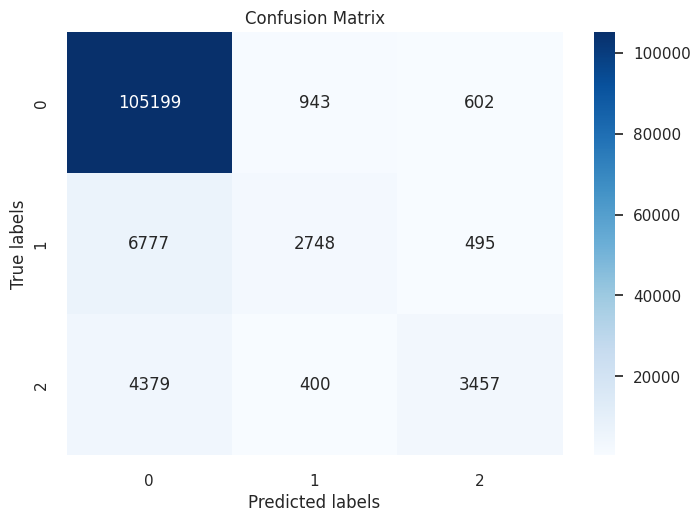

In [ ]:
# Create the Random Forest model
rf = RandomForestClassifier(n_estimators=100, random_state=0)

# Fit the model to the data
rf.fit(x_train, y_train)

y_pred = rf.predict(x_test)
# Get balanced accuracy score
bal_acc = balanced_accuracy_score(y_test, y_pred)

print("Training accuracy:", rf.score(x_train, y_train))
print("Testing accuracy:", rf.score(x_test, y_test)) 

print("Balanced accuracy:", bal_acc)

# Get ROC scores for one-vs-one classification
roc_ovo = roc_auc_score(y_test, rf.predict_proba(x_test), multi_class='ovo')
print("ROC score (one-vs-one):", roc_ovo)

# Get ROC scores for one-vs-rest classification
roc_ovr = roc_auc_score(y_test, rf.predict_proba(x_test), multi_class='ovr')
print("ROC score (one-vs-rest):", roc_ovr)

cm = confusion_matrix(y_test, y_pred)

cr = classification_report(y_test, y_pred, zero_division=1)
print("Classification Report:")
print(cr)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

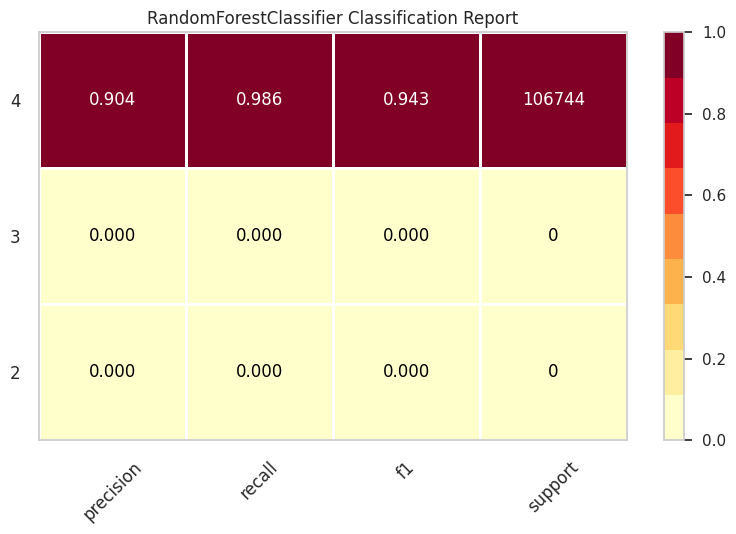

<Axes: title={'center': 'RandomForestClassifier Classification Report'}>

In [ ]:
visualizer = ClassificationReport(rf, support=True)

visualizer.fit(x_train, y_train)        # Fit the visualizer and the model
visualizer.score(x_test, y_test)        # Evaluate the model on the test data
visualizer.show() 

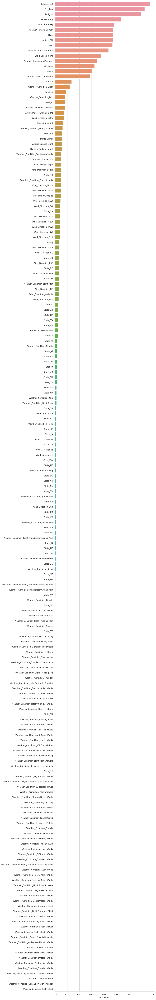

In [ ]:
# Get the feature importances using MDI
importances = rf.feature_importances_
sorted_idx = importances.argsort()
col=list(input_data.columns)
plt.figure(figsize=(10,100))
# Plot the feature importances using MDI with Seaborn
sorted_idx=np.flip(sorted_idx)
sns.barplot(x=[importances[i] for i in sorted_idx], y=[col[i] for i in sorted_idx])
sns.set(style='whitegrid')
plt.xlabel('Importance')
plt.show()

## Logistic Regression

Training accuracy: 0.8656433333333333
Testing accuracy: 0.86436
Balanced accuracy: 0.43264060937579324
ROC score (one-vs-one): 0.8220674190595432
ROC score (one-vs-rest): 0.8689506662517182


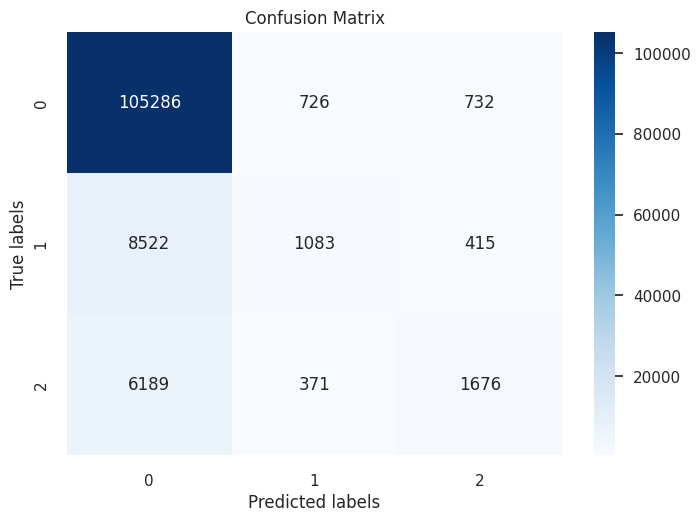

Classification Report:
              precision    recall  f1-score   support

           2       0.88      0.99      0.93    106744
           3       0.50      0.11      0.18     10020
           4       0.59      0.20      0.30      8236

    accuracy                           0.86    125000
   macro avg       0.66      0.43      0.47    125000
weighted avg       0.83      0.86      0.83    125000



In [ ]:
lr = LogisticRegression(max_iter=1000)
lr.fit(x_train, y_train)

print("Training accuracy:", lr.score(x_train, y_train))
print("Testing accuracy:", lr.score(x_test, y_test))


y_pred = lr.predict(x_test)

# Get balanced accuracy score
bal_acc = balanced_accuracy_score(y_test, y_pred)
print("Balanced accuracy:", bal_acc)

# Get ROC scores for one-vs-one classification
roc_ovo = roc_auc_score(y_test, lr.predict_proba(x_test), multi_class='ovo')
print("ROC score (one-vs-one):", roc_ovo)

# Get ROC scores for one-vs-rest classification
roc_ovr = roc_auc_score(y_test, lr.predict_proba(x_test), multi_class='ovr')
print("ROC score (one-vs-rest):", roc_ovr)

cm = confusion_matrix(y_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

cr = classification_report(y_test, y_pred, zero_division=1)
print("Classification Report:")
print(cr)

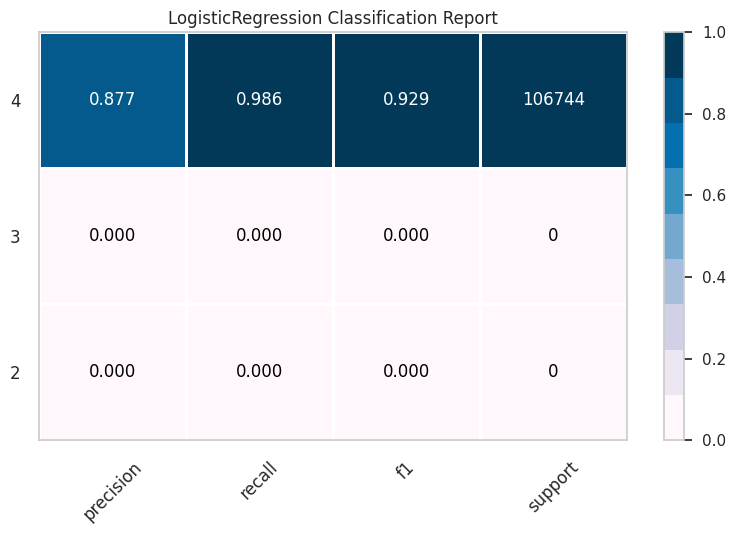

<Axes: title={'center': 'LogisticRegression Classification Report'}>

In [ ]:
visualizer = ClassificationReport(lr, support=True, cmap='PuBu')
visualizer.fit(x_train, y_train)
visualizer.score(x_test, y_test)

visualizer.show()

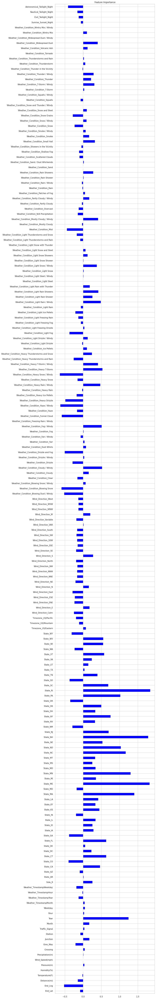

In [ ]:
# Get the feature importances using MDI
coefficients = lr.coef_[0]
feature_importance = pd.Series(coefficients, index=col)
plt.figure(figsize=(10,100))
feature_importance.plot(kind='barh', color='blue')
plt.title('Feature Importance')
plt.show()


## Gradient Boosting

Training accuracy: 0.87842
Testing accuracy: 0.876368
Balanced accuracy: 0.48574796860507635
One-vs-one macro accuracy: 0.8435378872087244
One-vs-rest macro accuracy: 0.8941212664426826


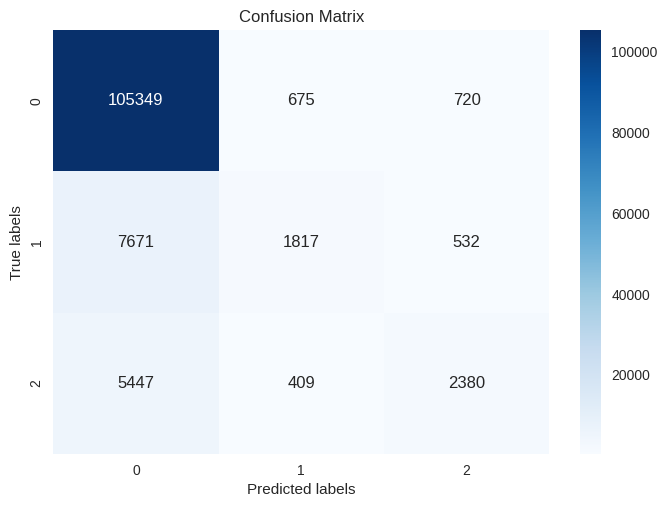

Classification Report:
              precision    recall  f1-score   support

           2       0.89      0.99      0.94    106744
           3       0.63      0.18      0.28     10020
           4       0.66      0.29      0.40      8236

    accuracy                           0.88    125000
   macro avg       0.72      0.49      0.54    125000
weighted avg       0.85      0.88      0.85    125000



In [ ]:
# Fit a Gradient Boosting Tree classifier
gbt = GradientBoostingClassifier(n_estimators=100, learning_rate=0.1, random_state=0)
gbt.fit(x_train, y_train)
y_pred = gbt.predict(x_test)


print("Training accuracy:", gbt.score(x_train, y_train))
print("Testing accuracy:", gbt.score(x_test, y_test))

bal_acc = balanced_accuracy_score(y_test, y_pred)
print("Balanced accuracy:", bal_acc)

# Compute the one-vs-one macro accuracy
ovo_acc = roc_auc_score(y_test, gbt.predict_proba(x_test), multi_class="ovo", average="macro")
print("One-vs-one macro accuracy:", ovo_acc)

# Compute the one-vs-rest macro accuracy
ovr_acc = roc_auc_score(y_test, gbt.predict_proba(x_test), multi_class="ovr", average="macro")
print("One-vs-rest macro accuracy:", ovr_acc)

cm = confusion_matrix(y_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# Compute the classification report, which includes precision, recall, f1-score, and support
cr = classification_report(y_test, y_pred, zero_division=1)
print("Classification Report:")
print(cr)

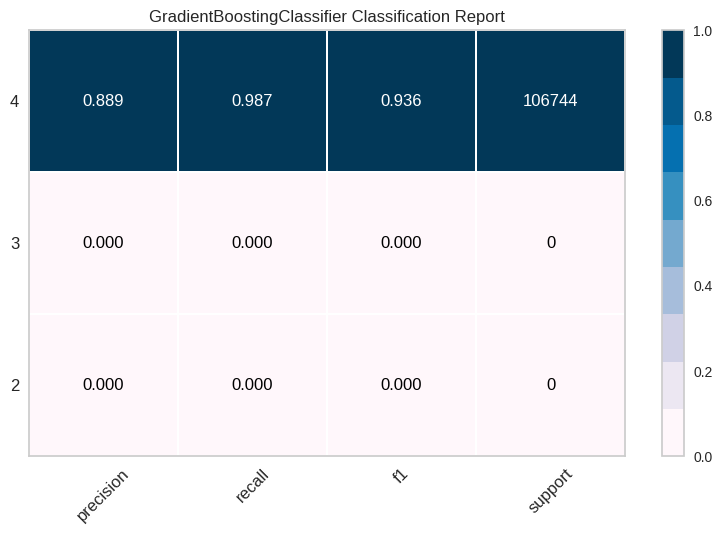

<Axes: title={'center': 'GradientBoostingClassifier Classification Report'}>

In [ ]:
visualizer = ClassificationReport(gbt, support=True, cmap='PuBu')
visualizer.fit(x_train, y_train)
visualizer.score(x_test, y_test)

visualizer.show()

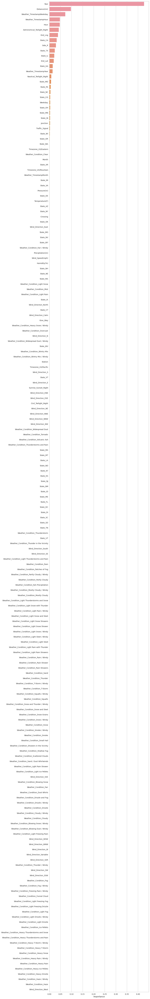

In [ ]:
# Get the feature importances using MDI
importances = gbt.feature_importances_
sorted_idx = importances.argsort()
col=list(input_data.columns)
plt.figure(figsize=(10,100))
# Plot the feature importances using MDI with Seaborn
sorted_idx=np.flip(sorted_idx)
sns.barplot(x=[importances[i] for i in sorted_idx], y=[col[i] for i in sorted_idx])
sns.set(style='whitegrid')
plt.xlabel('Importance')
plt.show()

## Xg Boosting

Training accuracy: 0.8956033333333333
Testing accuracy: 0.884576
Accuracy: 0.884576
Balanced accuracy: 0.5423825872008087
ROC one-vs-one macro accuracy: 0.8736074700258722
ROC one-vs-rest macro accuracy: 0.9127412686566672


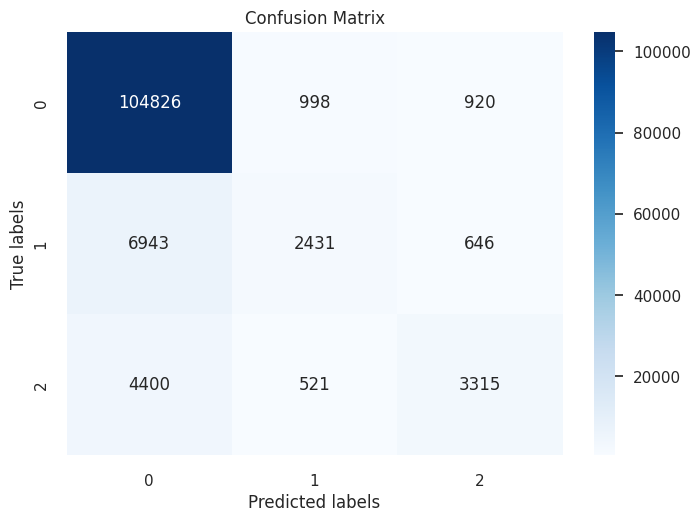

Classification Report:
              precision    recall  f1-score   support

           0       0.90      0.98      0.94    106744
           1       0.62      0.24      0.35     10020
           2       0.68      0.40      0.51      8236

    accuracy                           0.88    125000
   macro avg       0.73      0.54      0.60    125000
weighted avg       0.86      0.88      0.86    125000



In [ ]:
# Create an XGBoost classifier
xgb = XGBClassifier()

# Fit the classifier to the training data
y_new_train=y_train-2
y_new_test=y_test-2
xgb.fit(x_train, y_new_train)
print("Training accuracy:", xgb.score(x_train, y_new_train))
print("Testing accuracy:", xgb.score(x_test, y_new_test))
# Evaluate the classifier on the testing data
y_pred = xgb.predict(x_test)
print("Accuracy:", accuracy_score(y_new_test, y_pred))

y_pred = xgb.predict(x_test)

# Calculate balanced accuracy
balanced_acc = balanced_accuracy_score(y_new_test, y_pred)

# Calculate ROC one-vs-one macro accuracy
roc_ovo_macro = roc_auc_score(y_new_test, xgb.predict_proba(x_test), multi_class='ovo', average='macro')

# Calculate ROC one-vs-rest accuracy
roc_ovr_macro = roc_auc_score(y_new_test, xgb.predict_proba(x_test), multi_class='ovr', average='macro')

# Print the results
print("Balanced accuracy:", balanced_acc)
print("ROC one-vs-one macro accuracy:", roc_ovo_macro)
print("ROC one-vs-rest macro accuracy:", roc_ovr_macro)



cm = confusion_matrix(y_new_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# Compute the classification report, which includes precision, recall, f1-score, and support
cr = classification_report(y_new_test, y_pred)
print("Classification Report:")
print(cr)





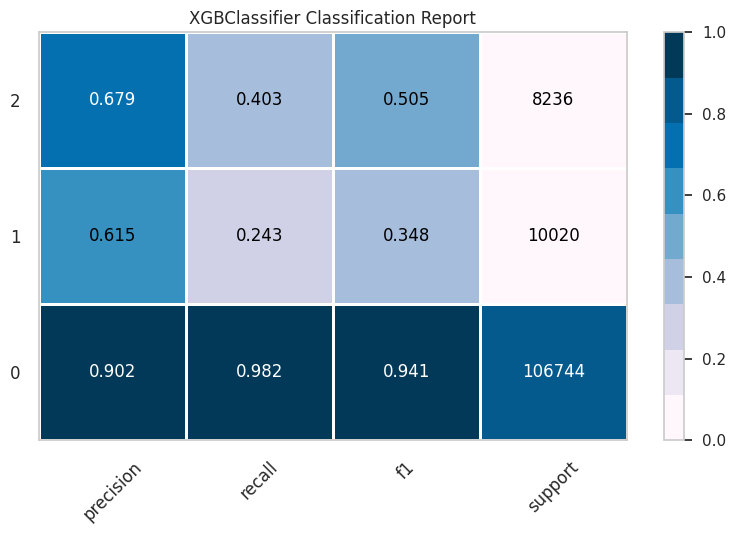

<Axes: title={'center': 'XGBClassifier Classification Report'}>

In [ ]:
visualizer = ClassificationReport(xgb, support=True, cmap='PuBu')
visualizer.fit(x_train, y_new_train)
visualizer.score(x_test, y_new_test)

visualizer.show()

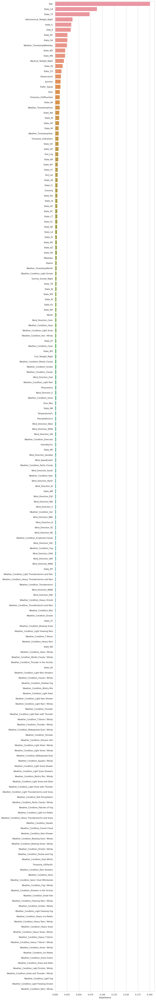

In [ ]:
# Get the feature importances using MDI
importances = xgb.feature_importances_
sorted_idx = importances.argsort()
col=list(input_data.columns)
plt.figure(figsize=(10,100))
# Plot the feature importances using MDI with Seaborn
sorted_idx=np.flip(sorted_idx)
sns.barplot(x=[importances[i] for i in sorted_idx], y=[col[i] for i in sorted_idx])
sns.set(style='whitegrid')
plt.xlabel('Importance')
plt.show()

## KNN

Training accuracy: 0.89669
Testing accuracy: 0.864088
Balanced accuracy: 0.48508097573572573
One-vs-one macro accuracy: 0.776852367316808
One-vs-rest macro accuracy: 0.8068038431167629


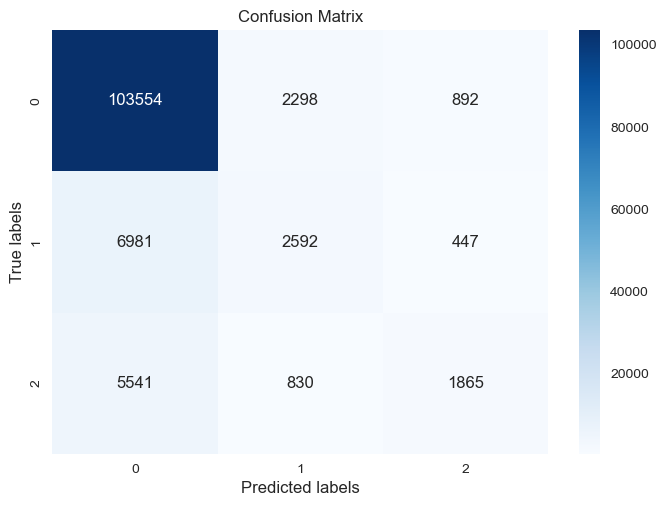

Classification Report:
              precision    recall  f1-score   support

           2       0.89      0.97      0.93    106744
           3       0.45      0.26      0.33     10020
           4       0.58      0.23      0.33      8236

    accuracy                           0.86    125000
   macro avg       0.64      0.49      0.53    125000
weighted avg       0.84      0.86      0.84    125000



In [ ]:
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(x_train, y_train)

print("Training accuracy:", knn.score(x_train, y_train))
print("Testing accuracy:", knn.score(x_test, y_test))

y_pred = knn.predict(x_test)

bal_acc = balanced_accuracy_score(y_test, y_pred)
print("Balanced accuracy:", bal_acc)

# Compute the one-vs-one macro accuracy
ovo_acc = roc_auc_score(y_test, knn.predict_proba(x_test), multi_class="ovo", average="macro")
print("One-vs-one macro accuracy:", ovo_acc)

# Compute the one-vs-rest macro accuracy
ovr_acc = roc_auc_score(y_test, knn.predict_proba(x_test), multi_class="ovr", average="macro")
print("One-vs-rest macro accuracy:", ovr_acc)
cm = confusion_matrix(y_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# Compute the classification report, which includes precision, recall, f1-score, and support
cr = classification_report(y_test, y_pred, zero_division=1)
print("Classification Report:")
print(cr)


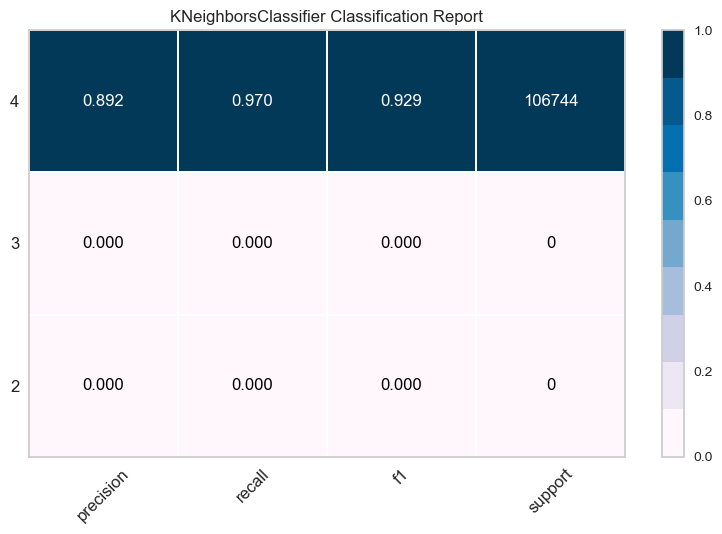

<Axes: title={'center': 'KNeighborsClassifier Classification Report'}>

In [ ]:
visualizer = ClassificationReport(knn, support=True, cmap='PuBu')
visualizer.fit(x_train, y_train)
visualizer.score(x_test, y_test)

visualizer.show()

# AdaBoost

Training accuracy: 0.85971
Testing accuracy: 0.858248
Balanced accuracy: 0.3895202150695556
ROC score (one-vs-one): 0.7635332899408267
ROC score (one-vs-rest): 0.7155236619476799


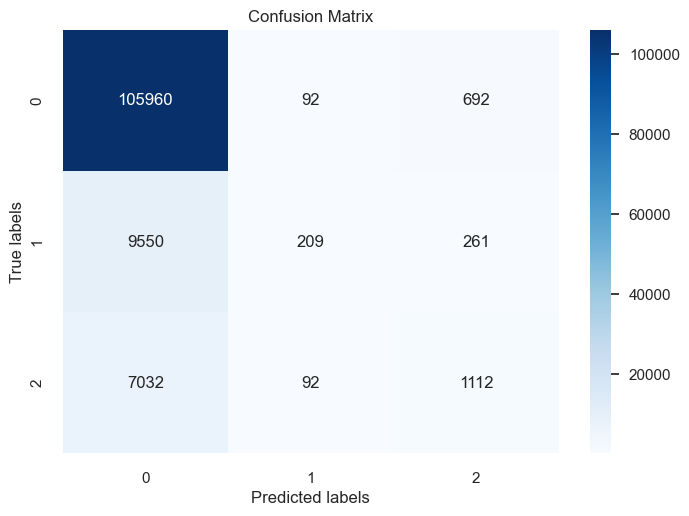

Classification Report:
              precision    recall  f1-score   support

           2       0.86      0.99      0.92    106744
           3       0.53      0.02      0.04     10020
           4       0.54      0.14      0.22      8236

    accuracy                           0.86    125000
   macro avg       0.64      0.38      0.39    125000
weighted avg       0.82      0.86      0.81    125000



In [ ]:
adaboost = AdaBoostClassifier(n_estimators=100, learning_rate=0.1, random_state=0)
adaboost.fit(x_train, y_train)

print("Training accuracy:", adaboost.score(x_train, y_train))
print("Testing accuracy:", adaboost.score(x_test, y_test))

y_pred = adaboost.predict(x_test)

bal_acc = balanced_accuracy_score(y_test, y_pred)
print("Balanced accuracy:", bal_acc)

# Get ROC scores for one-vs-one classification
roc_ovo = roc_auc_score(y_test, adaboost.predict_proba(x_test), multi_class='ovo')
print("ROC score (one-vs-one):", roc_ovo)

# Get ROC scores for one-vs-rest classification
roc_ovr = roc_auc_score(y_test, adaboost.predict_proba(x_test), multi_class='ovr')
print("ROC score (one-vs-rest):", roc_ovr)

cm = confusion_matrix(y_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# Compute the classification report, which includes precision, recall, f1-score, and support
cr = classification_report(y_test, y_pred, zero_division=1)
print("Classification Report:")
print(cr)

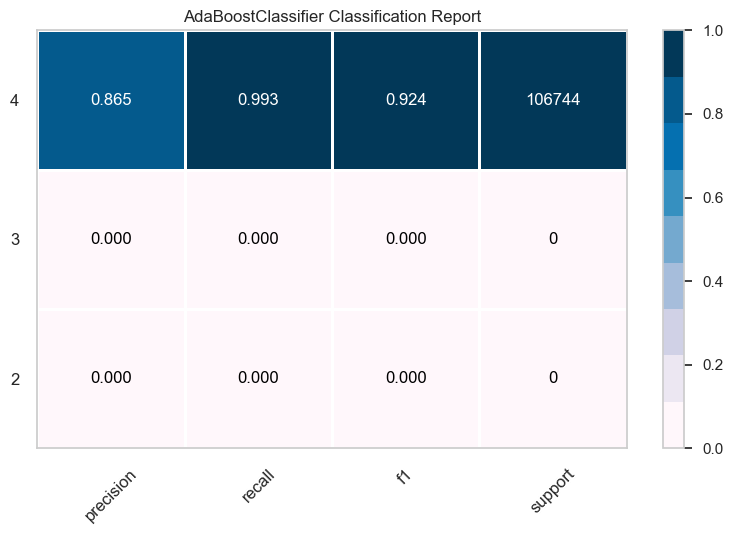

<Axes: title={'center': 'AdaBoostClassifier Classification Report'}>

In [ ]:
visualizer = ClassificationReport(adaboost, support=True, cmap='PuBu')
visualizer.fit(x_train, y_train)
visualizer.score(x_test, y_test)

visualizer.show()

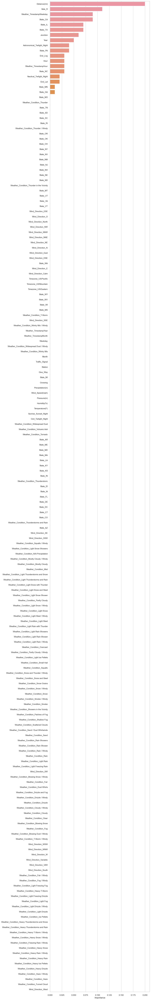

In [ ]:
# Get the feature importances using MDI
importances = adaboost.feature_importances_
sorted_idx = importances.argsort()
col=list(input_data.columns)
plt.figure(figsize=(10,100))
# Plot the feature importances using MDI with Seaborn
sorted_idx=np.flip(sorted_idx)
sns.barplot(x=[importances[i] for i in sorted_idx], y=[col[i] for i in sorted_idx])
sns.set(style='whitegrid')
plt.xlabel('Importance')
plt.show()


# lightGBM

Training accuracy: 0.8877433333333333
Testing accuracy: 0.882776
Balanced accuracy: 0.5315048187464237
ROC score (one-vs-one): 0.8668302757496423
ROC score (one-vs-rest): 0.9084195634553099


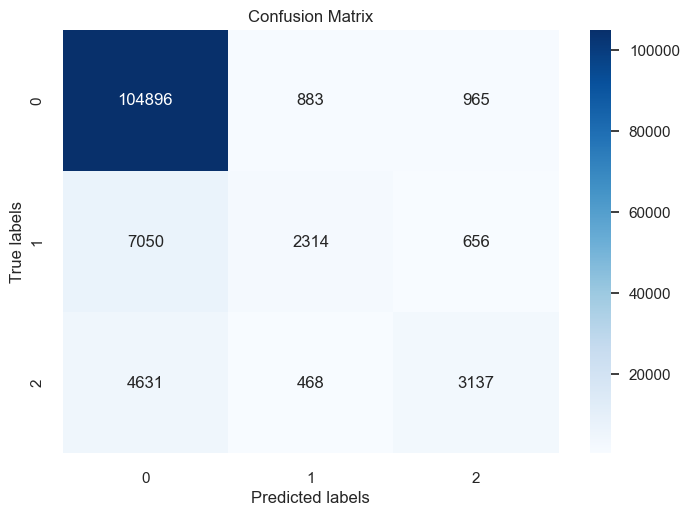

Classification Report:
              precision    recall  f1-score   support

           2       0.90      0.98      0.94    106744
           3       0.63      0.23      0.34     10020
           4       0.66      0.38      0.48      8236

    accuracy                           0.88    125000
   macro avg       0.73      0.53      0.59    125000
weighted avg       0.86      0.88      0.86    125000



In [ ]:
lgb_clf = lgb.LGBMClassifier(n_estimators=100, learning_rate=0.1, random_state=0)
lgb_clf.fit(x_train, y_train)

print("Training accuracy:", lgb_clf.score(x_train, y_train))
print("Testing accuracy:", lgb_clf.score(x_test, y_test))

y_pred = lgb_clf.predict(x_test)
bal_acc = balanced_accuracy_score(y_test, y_pred)
print("Balanced accuracy:", bal_acc)

# Get ROC scores for one-vs-one classification
roc_ovo = roc_auc_score(y_test, lgb_clf.predict_proba(x_test), multi_class='ovo')
print("ROC score (one-vs-one):", roc_ovo)

# Get ROC scores for one-vs-rest classification
roc_ovr = roc_auc_score(y_test, lgb_clf.predict_proba(x_test), multi_class='ovr')
print("ROC score (one-vs-rest):", roc_ovr)
cm = confusion_matrix(y_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# Compute the classification report, which includes precision, recall, f1-score, and support
cr = classification_report(y_test, y_pred, zero_division=1)
print("Classification Report:")
print(cr)

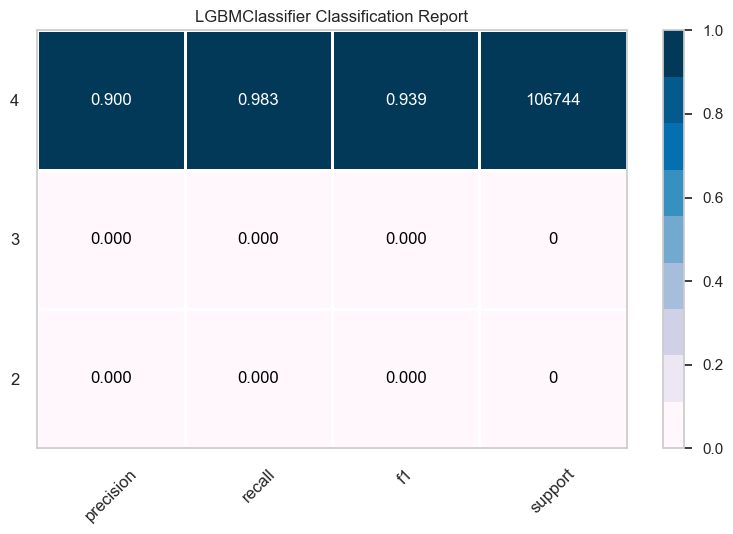

<Axes: title={'center': 'LGBMClassifier Classification Report'}>

In [ ]:
visualizer = ClassificationReport(lgb_clf, support=True, cmap='PuBu')
visualizer.fit(x_train, y_train)
visualizer.score(x_test, y_test)

visualizer.show()

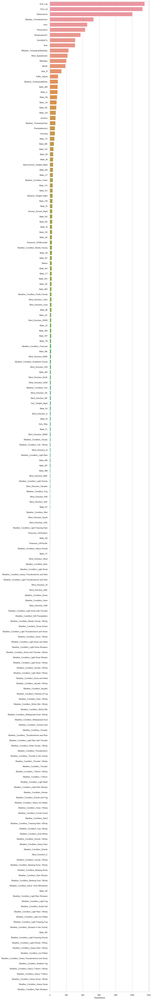

In [ ]:
# Get the feature importances using MDI
importances = lgb_clf.feature_importances_
sorted_idx = importances.argsort()
col=list(input_data.columns)
plt.figure(figsize=(10,100))
# Plot the feature importances using MDI bwith Seaborn
sorted_idx=np.flip(sorted_idx)
sns.barplot(x=[importances[i] for i in sorted_idx], y=[col[i] for i in sorted_idx])
sns.set(style='whitegrid')
plt.xlabel('Importance')
plt.show()

# CatBoost

Training accuracy: 0.8792766666666667
Testing accuracy: 0.877464
Balanced accuracy: 0.4927474564511228
ROC score (one-vs-one): 0.8454912416995999
ROC score (one-vs-rest): 0.8962885045445804


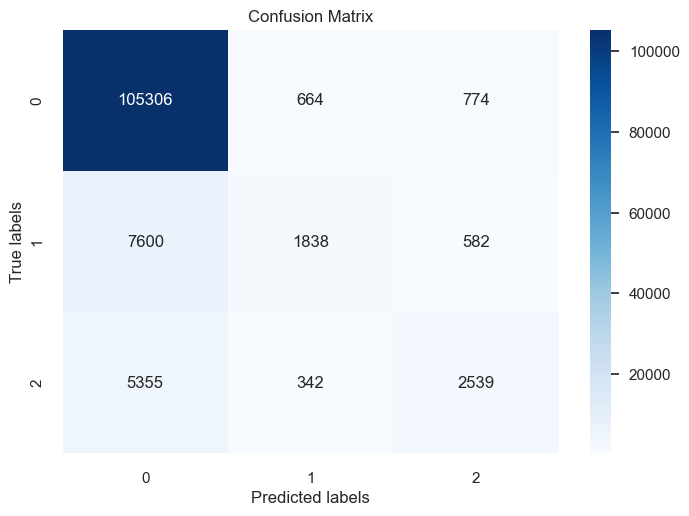

Classification Report:
              precision    recall  f1-score   support

           2       0.89      0.99      0.94    106744
           3       0.65      0.18      0.29     10020
           4       0.65      0.31      0.42      8236

    accuracy                           0.88    125000
   macro avg       0.73      0.49      0.55    125000
weighted avg       0.86      0.88      0.85    125000



In [ ]:
catboost = CatBoostClassifier(n_estimators=100, learning_rate=0.1, random_state=0)
catboost.fit(x_train, y_train,verbose=False)

print("Training accuracy:", catboost.score(x_train, y_train))
print("Testing accuracy:", catboost.score(x_test, y_test))
y_pred = catboost.predict(x_test)

bal_acc = balanced_accuracy_score(y_test, y_pred)
print("Balanced accuracy:", bal_acc)

# Get ROC scores for one-vs-one classification
roc_ovo = roc_auc_score(y_test, catboost.predict_proba(x_test), multi_class='ovo')
print("ROC score (one-vs-one):", roc_ovo)

# Get ROC scores for one-vs-rest classification
roc_ovr = roc_auc_score(y_test, catboost.predict_proba(x_test), multi_class='ovr')
print("ROC score (one-vs-rest):", roc_ovr)
cm = confusion_matrix(y_test, y_pred)

# Create a heatmap of the confusion matrix
sns.heatmap(cm, annot=True, cmap='Blues', fmt='g')
plt.xlabel('Predicted labels')
plt.ylabel('True labels')
plt.title('Confusion Matrix')
plt.show()

# Compute the classification report, which includes precision, recall, f1-score, and support
cr = classification_report(y_test, y_pred, zero_division=1)
print("Classification Report:")
print(cr)




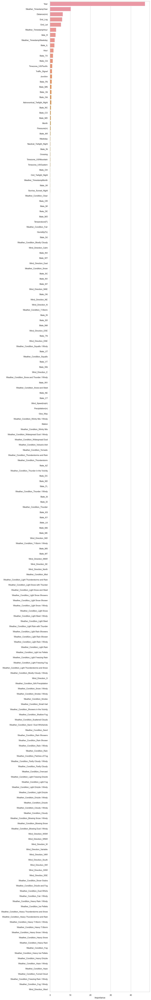

In [ ]:
# Get the feature importances using MDI
importances = catboost.feature_importances_
sorted_idx = importances.argsort()
col=list(input_data.columns)
plt.figure(figsize=(10,100))
# Plot the feature importances using MDI bwith Seaborn
sorted_idx=np.flip(sorted_idx)
sns.barplot(x=[importances[i] for i in sorted_idx], y=[col[i] for i in sorted_idx])
sns.set(style='whitegrid')
plt.xlabel('Importance')
plt.show()

In [ ]:

y_train=np.array(pd.get_dummies(y_train))
y_validation=np.array(pd.get_dummies(y_validation))
y_test=np.array(pd.get_dummies(y_test))

In [ ]:
x_train=tensorflow.convert_to_tensor(x_train,dtype=tensorflow.float32)
x_validation=tensorflow.convert_to_tensor(x_validation,dtype=tensorflow.float32)
x_test=tensorflow.convert_to_tensor(x_test,dtype=tensorflow.float32)

In [ ]:
import os
os.environ['TF_KERAS_TUNER_FLAG'] = '1'
def build_model(hp):
    model=Sequential()
    model.add(Dense(units=hp.Int('input_units',min_value=32,max_value=512,step=32),
                           activation=hp.Choice('input_activation', values=['relu', 'tanh', 'sigmoid']),
                           input_shape=(len(data.columns),)))
    for i in range(hp.Int('num_layers',min_value=1,max_value=10)):
        model.add(Dense(units=hp.Int(f'layer_{i}_units', min_value=32, max_value=512, step=32),
                               activation=hp.Choice(f'layer_{i}_activation', values=['relu', 'tanh', 'sigmoid']),
                               kernel_regularizer=hp.Choice(f'layer_{i}_kernel_regularizer', values=['l1', 'l2']),
                               bias_regularizer=hp.Choice(f'layer_{i}_bias_regularizer', values=['l1', 'l2'])))
        model.add(Dropout(hp.Float(f'layer_{i}_dropout', min_value=0.0, max_value=0.9, step=0.1)))
        if hp.Boolean(f'layer_{i}_batch_normalization'):
            model.add(BatchNormalization())
    model.add(Dense(units=3, activation='softmax'))
    model.compile(optimizer=hp.Choice('optimizer',values=['adam','rmsprop', 'sgd']),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model

In [ ]:
tuner = kt.RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=5,
    directory='My_Final_Directory_2023',
    project_name='my_project'
)
early_stopping=keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=3,
    restore_best_weights=True
)

In [ ]:
tuner.search(x=x_train,y=y_train,
             epochs=5,
             validation_data=(x_validation,y_validation),
             callbacks=[early_stopping]
        )

Trial 5 Complete [00h 05m 56s]
val_accuracy: 0.8575999736785889

Best val_accuracy So Far: 0.8706666827201843
Total elapsed time: 00h 23m 21s


In [ ]:
best_hp=tuner.get_best_hyperparameters()[0]
severity_model=build_model(best_hp)

In [ ]:
severity_model.fit(x_train,y_train,epochs=100,initial_epoch=6,validation_data=(x_validation,y_validation),callbacks=early_stopping)

Epoch 7/100
9375/9375 [==============================] - 34s 3ms/step - loss: 0.7914 - accuracy: 0.8606 - val_loss: 0.6646 - val_accuracy: 0.8635
Epoch 8/100
9375/9375 [==============================] - 39s 4ms/step - loss: 0.6566 - accuracy: 0.8668 - val_loss: 0.6580 - val_accuracy: 0.8692
Epoch 9/100
9375/9375 [==============================] - 35s 4ms/step - loss: 0.6513 - accuracy: 0.8687 - val_loss: 0.6498 - val_accuracy: 0.8696
Epoch 10/100
9375/9375 [==============================] - 34s 4ms/step - loss: 0.6492 - accuracy: 0.8695 - val_loss: 0.6484 - val_accuracy: 0.8700
Epoch 11/100
9375/9375 [==============================] - 40s 4ms/step - loss: 0.6465 - accuracy: 0.8705 - val_loss: 0.6500 - val_accuracy: 0.8704
Epoch 12/100
9375/9375 [==============================] - 33s 4ms/step - loss: 0.6447 - accuracy: 0.8710 - val_loss: 0.6478 - val_accuracy: 0.8708
Epoch 13/100
9375/9375 [==============================] - 33s 3ms/step - loss: 0.6438 - accuracy: 0.8712 - val_loss: 0.65

In [ ]:
import pickle 
with open('severity_model','wb') as f:
  pickle.dump(severity_model,f) 

In [ ]:
import pickle
with open('severity_model','rb') as f:
    severity_model=pickle.load(f)

In [ ]:
y_predicted=np.argmax(severity_model.predict(x_test),axis=1)
y_predicted+=2

3907/3907 [==============================] - 7s 2ms/step


In [ ]:
y_test=np.argmax(y_test,axis=1)
y_test+=2

In [ ]:
from sklearn.metrics import accuracy_score
print(f'Testing Accuracy for our Model is {accuracy_score(y_predicted,y_test)}')

 Accuracy for our Model is 0.872472


In [ ]:
#location(regression) prediction starts here

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project_data.csv',nrows=5e5)

In [ ]:
print(data.columns)

Index(['ID', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Description', 'Number', 'Street',
       'Side', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')


In [ ]:
data.End_Time=pd.to_datetime(data.End_Time)
data['Month']=data['End_Time'].dt.month
data['Year']=data['End_Time'].dt.year
data['Hour']=data['End_Time'].dt.hour
data['Weekday']=data['End_Time'].dt.weekday

In [ ]:
del data['Country']
del data['Turning_Loop']
del data['Roundabout']
del data['Bump']

<ipython-input-42-38b3f6c62ed6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr=data.corr()


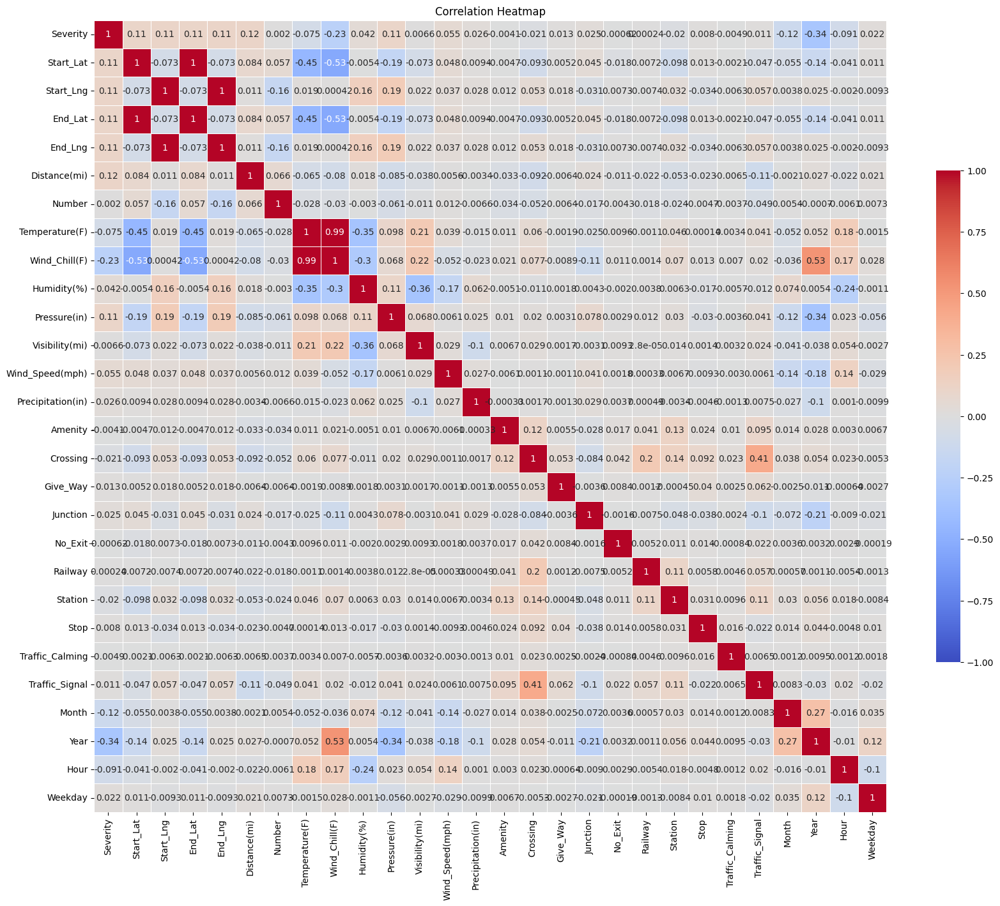

In [ ]:
correlation_heatmap()

In [ ]:
print(data.columns)

Index(['ID', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Description', 'Number', 'Street',
       'Side', 'City', 'County', 'State', 'Zipcode', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Station',
       'Stop', 'Traffic_Calming', 'Traffic_Signal', 'Sunrise_Sunset',
       'Civil_Twilight', 'Nautical_Twilight', 'Astronomical_Twilight', 'Month',
       'Year', 'Hour', 'Weekday'],
      dtype='object')


<ipython-input-42-38b3f6c62ed6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr=data.corr()


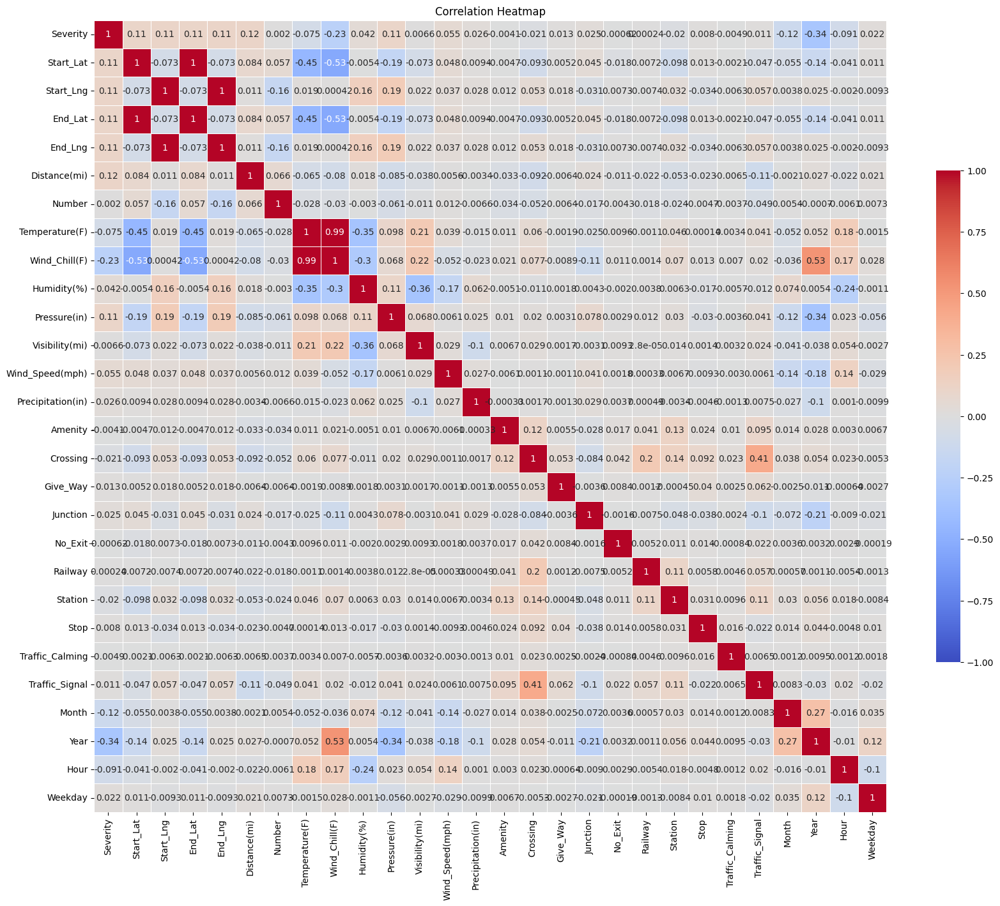

In [ ]:
correlation_heatmap()

In [ ]:
def delete_low_corr_cols(data):
    corr_matrix=data.corr()
    severity_corr=corr_matrix['End_Lat']
    low_corr_cols=severity_corr[abs(severity_corr)<0.01].index.tolist()
    data=data.drop(columns=low_corr_cols)
    print(low_corr_cols)
    corr_matrix=data.corr()
    severity_corr=corr_matrix['End_Lng']
    low_corr_cols=severity_corr[abs(severity_corr)<0.01].index.tolist()
    print(low_corr_cols)
    data=data.drop(columns=low_corr_cols)
    return data

In [ ]:
data=delete_low_corr_cols(data)

<ipython-input-192-bbe05777d941>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix=data.corr()


['Humidity(%)', 'Precipitation(in)', 'Amenity', 'Give_Way', 'Railway', 'Traffic_Calming']


<ipython-input-192-bbe05777d941>:7: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix=data.corr()


['Wind_Chill(F)', 'No_Exit', 'Month', 'Hour', 'Weekday']


<ipython-input-42-38b3f6c62ed6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr=data.corr()


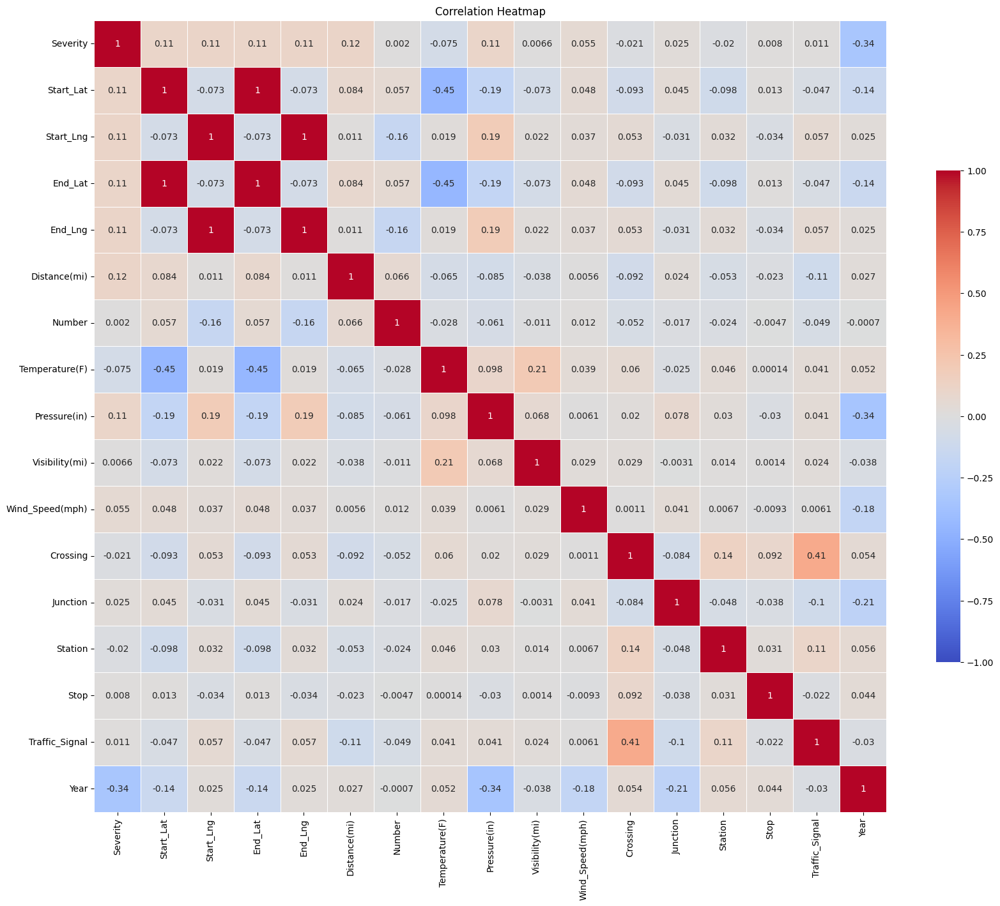

In [ ]:
correlation_heatmap()

In [ ]:
del data['ID']
del data['Airport_Code']
del data['Description']
del data['Street']
del data['City']
del data['Zipcode']
del data['County']

In [ ]:
get_date_month_year_hour('Start_Time')
get_date_month_year_hour('Weather_Timestamp')
del data['End_Time']

<ipython-input-42-38b3f6c62ed6>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr=data.corr()


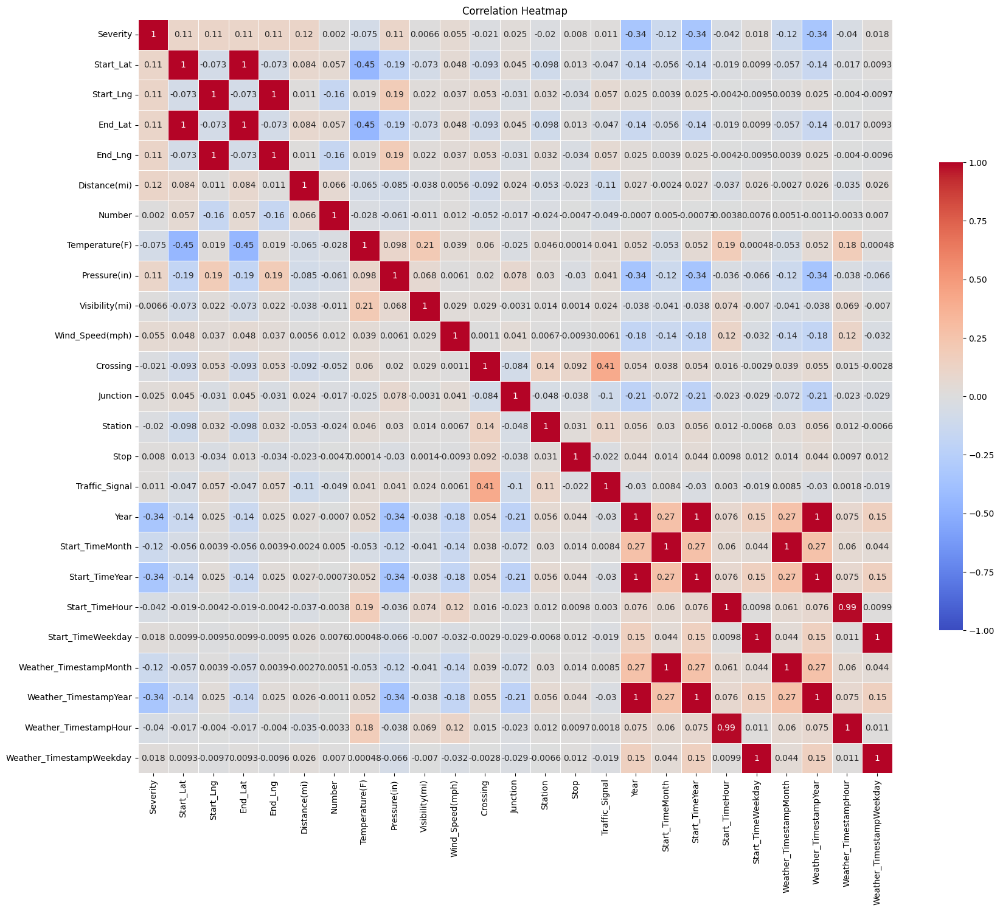

In [ ]:
correlation_heatmap()

In [ ]:
del data['Start_TimeMonth']
del data['Start_TimeYear']
del data['Start_TimeHour']
del data['Start_TimeWeekday']

In [ ]:
numeric_columns=['Temperature(F)','Pressure(in)','Wind_Speed(mph)']
data[numeric_columns]=data[numeric_columns].fillna(data[numeric_columns].mean())
categorical_columns=['Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
for col in categorical_columns:
    data[col].fillna(data[col].mode()[0],inplace=True)

In [ ]:
data.isnull().sum()

Severity                         0
Start_Lat                        0
Start_Lng                        0
End_Lat                          0
End_Lng                          0
Distance(mi)                     0
Number                      325677
Side                             0
State                            0
Timezone                         0
Temperature(F)                   0
Pressure(in)                     0
Visibility(mi)               11311
Wind_Direction                   0
Wind_Speed(mph)                  0
Weather_Condition                0
Crossing                         0
Junction                         0
Station                          0
Stop                             0
Traffic_Signal                   0
Sunrise_Sunset                   0
Civil_Twilight                   0
Nautical_Twilight                0
Astronomical_Twilight            0
Year                             0
Weather_TimestampMonth           0
Weather_TimestampYear            0
Weather_TimestampHou

In [ ]:
del data['Number']
data['Visibility(mi)'].fillna(data['Visibility(mi)'].mean(),inplace=True)

In [ ]:
data.isnull().sum()

Severity                    0
Start_Lat                   0
Start_Lng                   0
End_Lat                     0
End_Lng                     0
Distance(mi)                0
Side                        0
State                       0
Timezone                    0
Temperature(F)              0
Pressure(in)                0
Visibility(mi)              0
Wind_Direction              0
Wind_Speed(mph)             0
Weather_Condition           0
Crossing                    0
Junction                    0
Station                     0
Stop                        0
Traffic_Signal              0
Sunrise_Sunset              0
Civil_Twilight              0
Nautical_Twilight           0
Astronomical_Twilight       0
Year                        0
Weather_TimestampMonth      0
Weather_TimestampYear       0
Weather_TimestampHour       0
Weather_TimestampWeekday    0
dtype: int64

In [ ]:
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 29 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   Severity                  500000 non-null  int64  
 1   Start_Lat                 500000 non-null  float64
 2   Start_Lng                 500000 non-null  float64
 3   End_Lat                   500000 non-null  float64
 4   End_Lng                   500000 non-null  float64
 5   Distance(mi)              500000 non-null  float64
 6   Side                      500000 non-null  object 
 7   State                     500000 non-null  object 
 8   Timezone                  500000 non-null  object 
 9   Temperature(F)            500000 non-null  float64
 10  Pressure(in)              500000 non-null  float64
 11  Visibility(mi)            500000 non-null  float64
 12  Wind_Direction            500000 non-null  object 
 13  Wind_Speed(mph)           500000 non-null  f

In [ ]:
data=pd.get_dummies(data,columns=['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight'],drop_first=True)

In [ ]:
input_data=data.drop(['End_Lat','End_Lng'],axis=1)
output_data=data[['End_Lat','End_Lng']]

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(input_data,output_data,train_size=0.75,random_state=0)
x_train,x_validation,y_train,y_validation=train_test_split(x_train,y_train,train_size=60/75,random_state=1)

## numerical_num

In [ ]:
continuous_col=['Start_Lat','Start_Lng','Distance(mi)','Number','Temperature(F)','Wind_Chill(F)','Humidity(%)','Pressure(in)','Visibility(mi)','Precipitation(in)','Wind_Speed(mph)']

In [ ]:
def scatter_plot(col1,col2):
  x = data[col1]
  y = data[col2]
  plt.scatter(x, y,s=2,c=np.random.rand(3,))

  # set plot title and axis labels
  t="Scatter Plot of "+str(col1)+" and "+str(col2)
  plt.title(t)
  plt.xlabel(col1)
  plt.ylabel(col2)

  # show the plot
  plt.show()

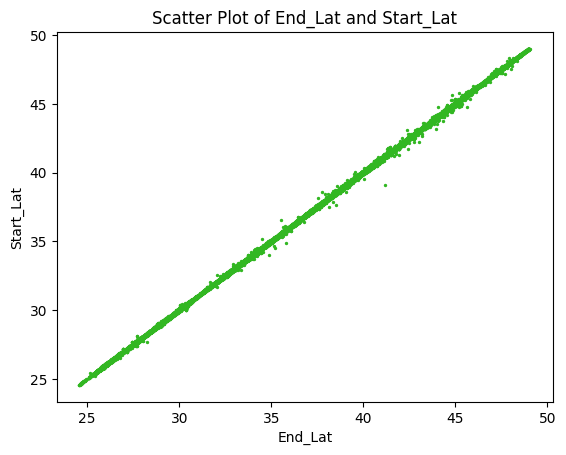

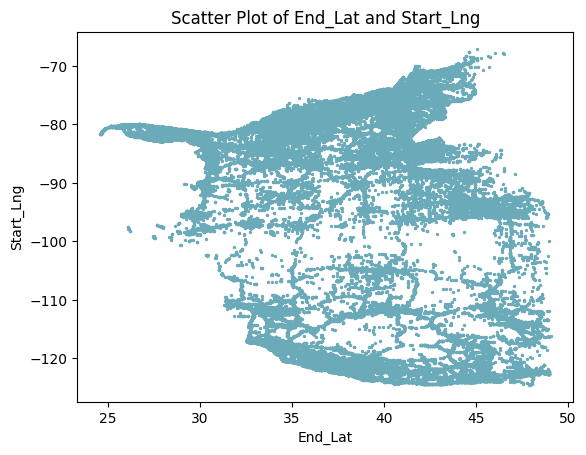

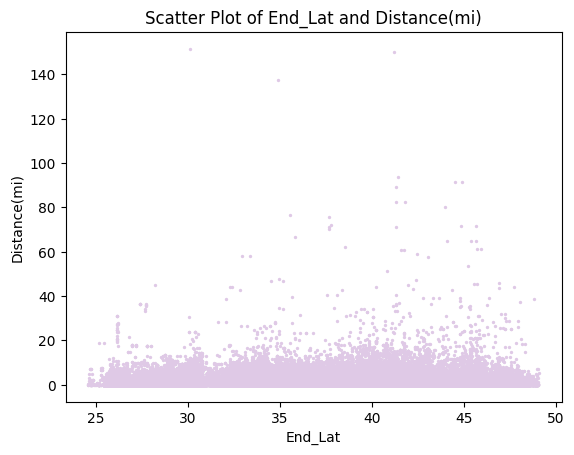

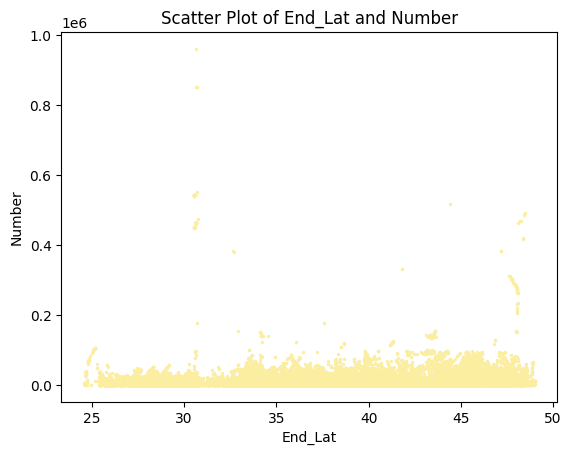

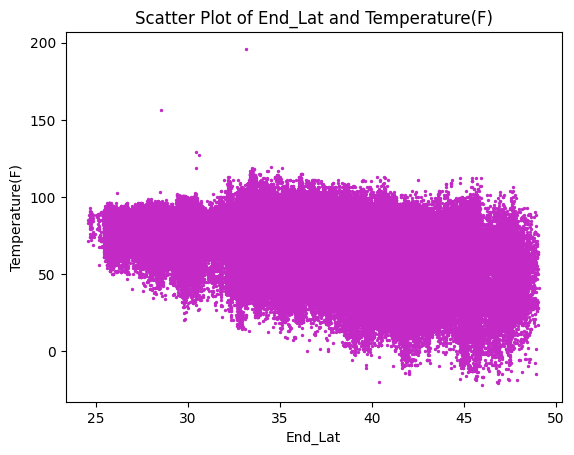

...

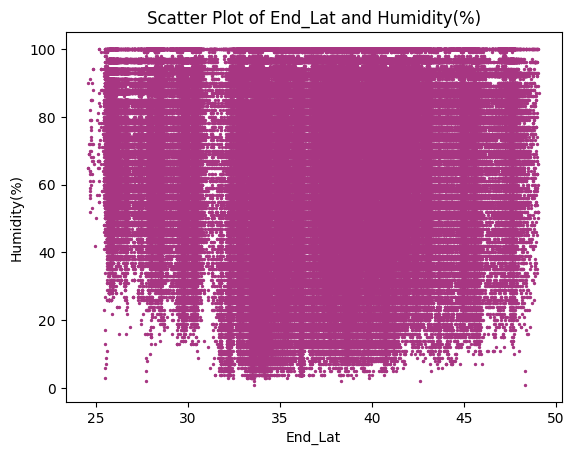

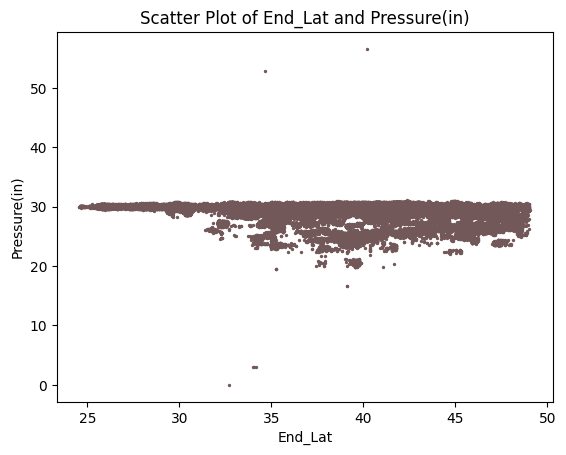

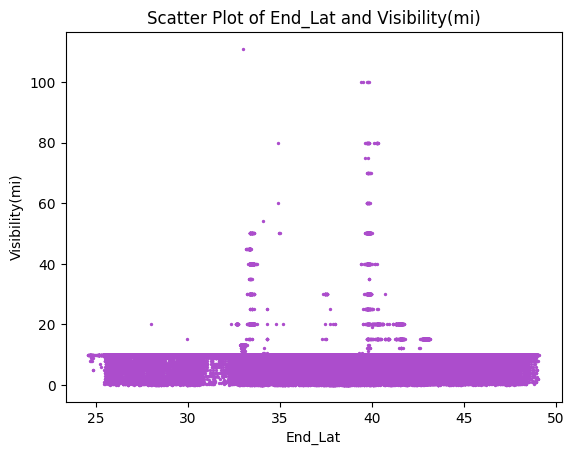

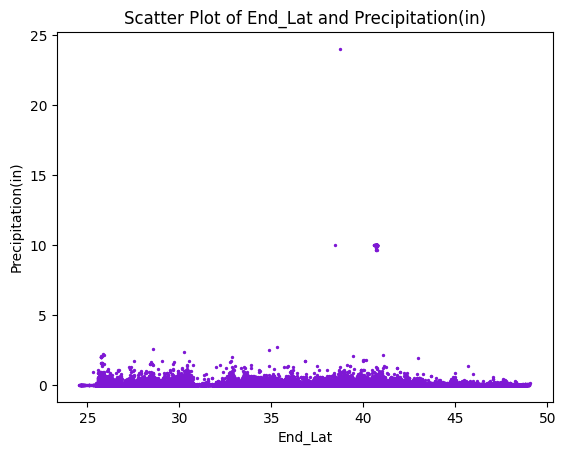

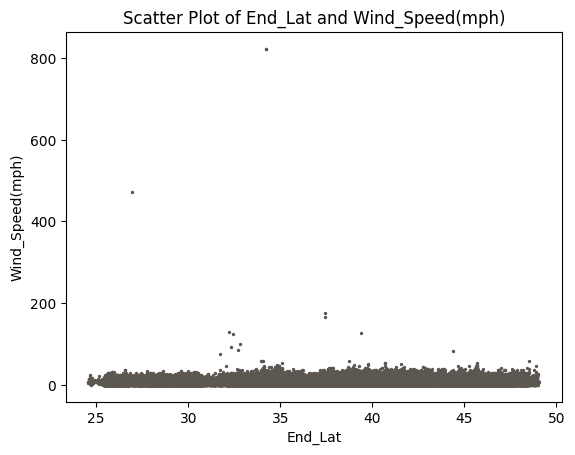

In [ ]:
for i in continuous_col:
  scatter_plot('End_Lat',i)

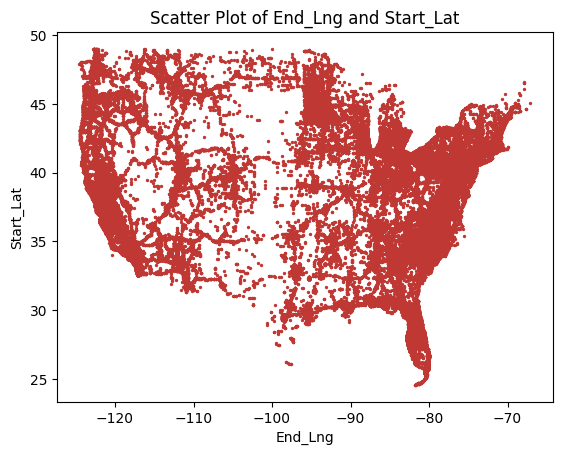

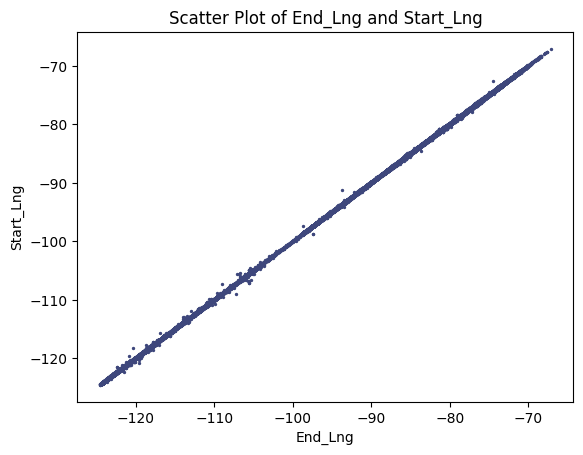

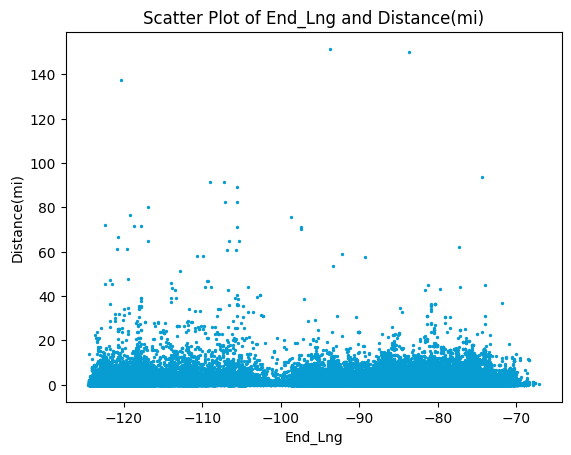

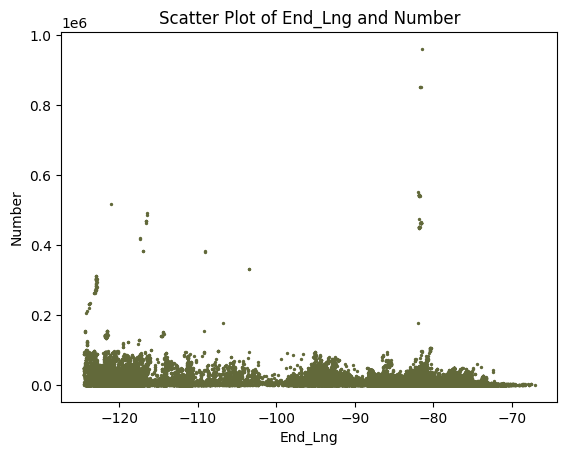

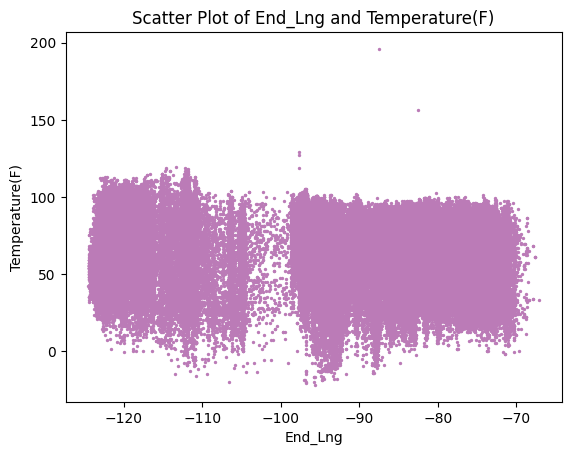

...

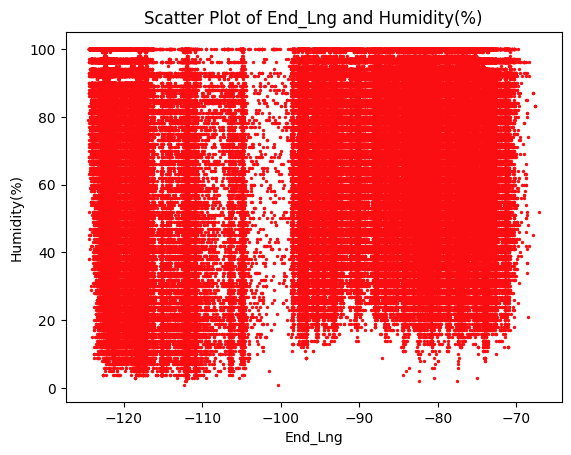

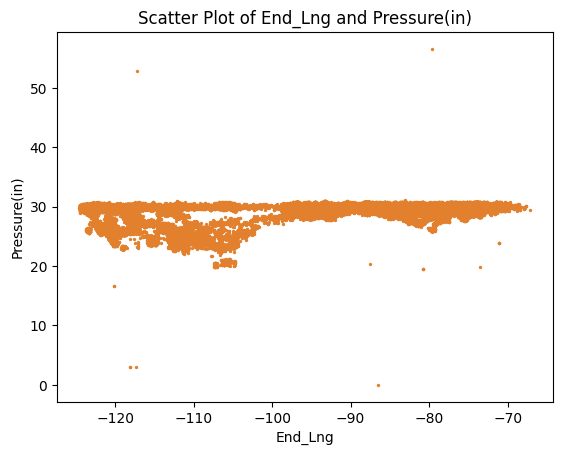

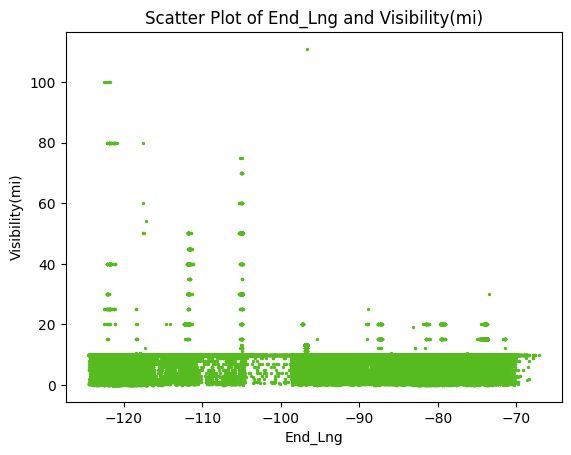

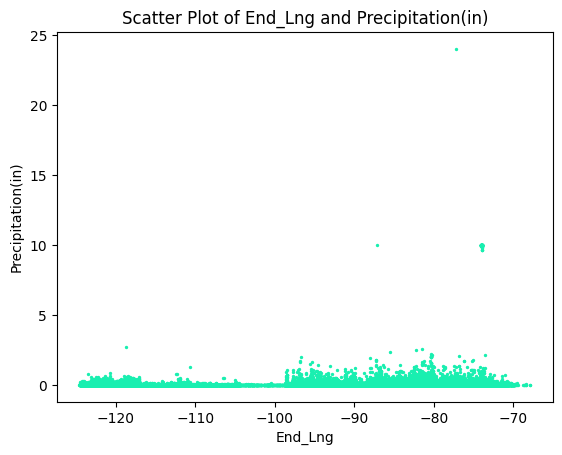

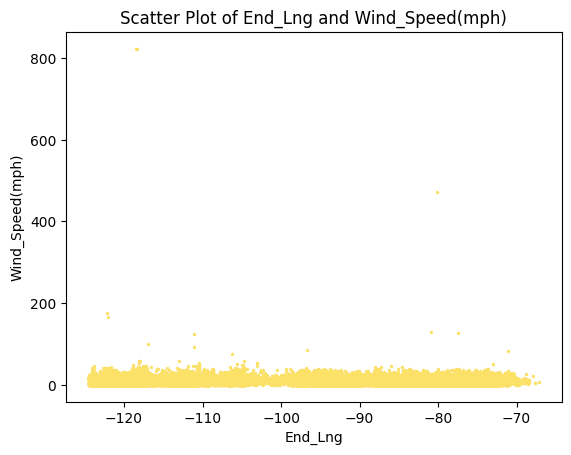

In [ ]:
for i in continuous_col:
  scatter_plot('End_Lng',i)

In [ ]:
import seaborn as sns

def regression_plot(col1,col2):
  
  sns.set_style('whitegrid')
  sns.lmplot(x =col1, y =col2, data = data, 
            hue ='Severity', markers =['o', 'v','+'])


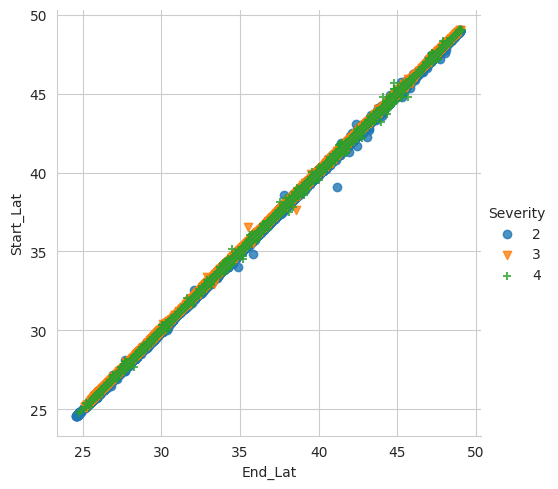

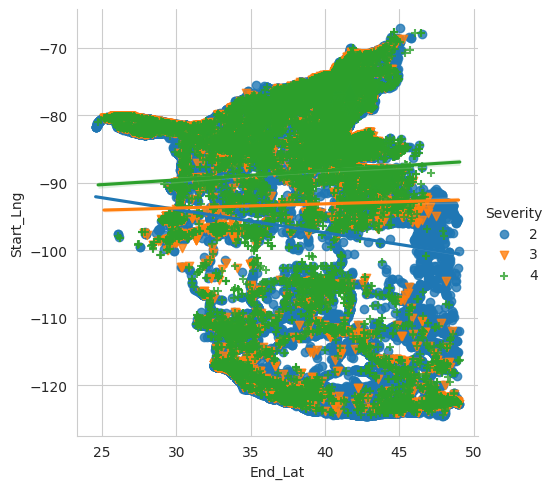

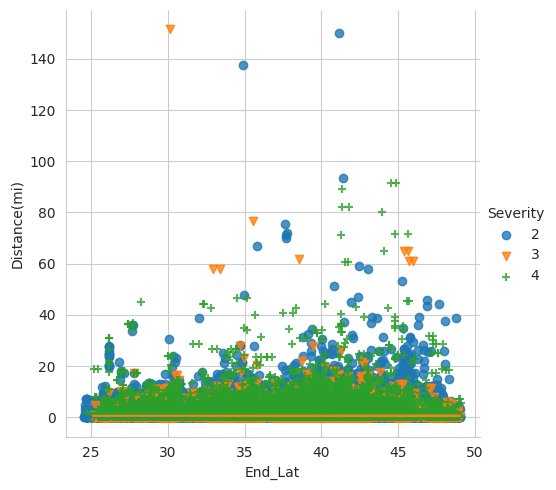

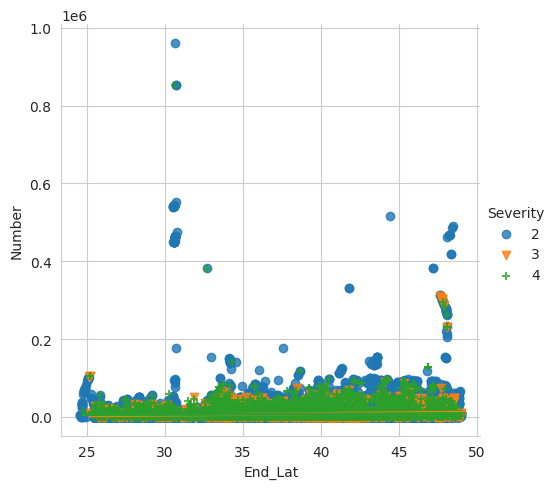

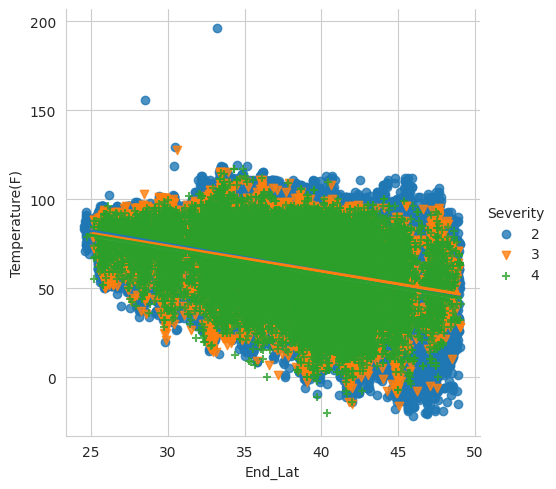

...

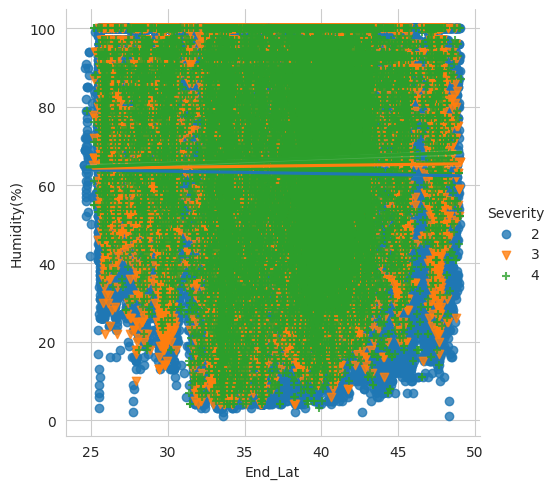

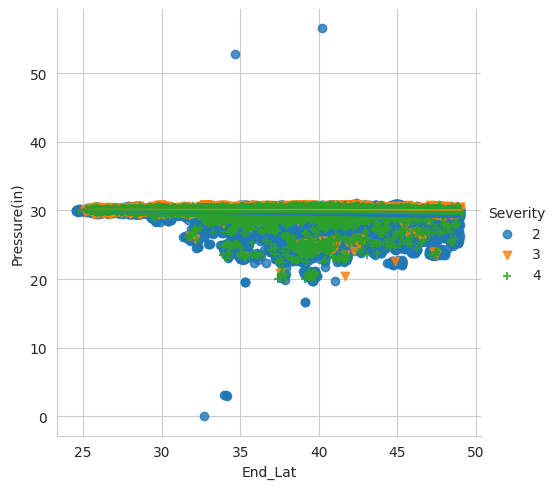

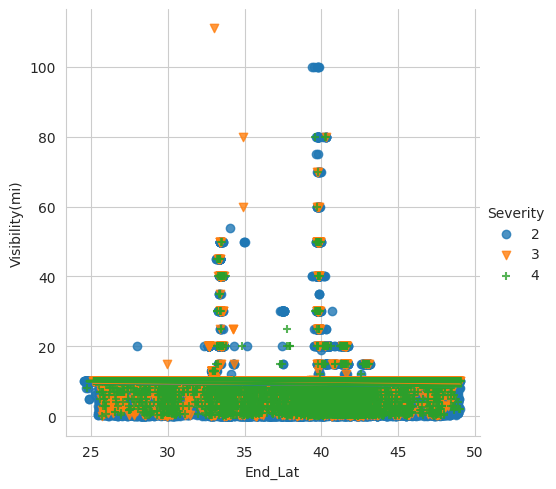

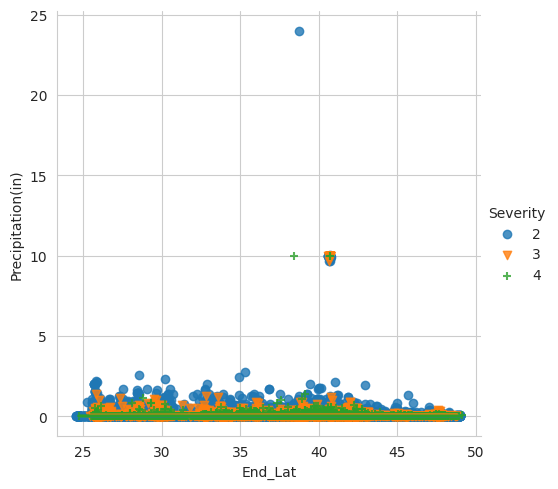

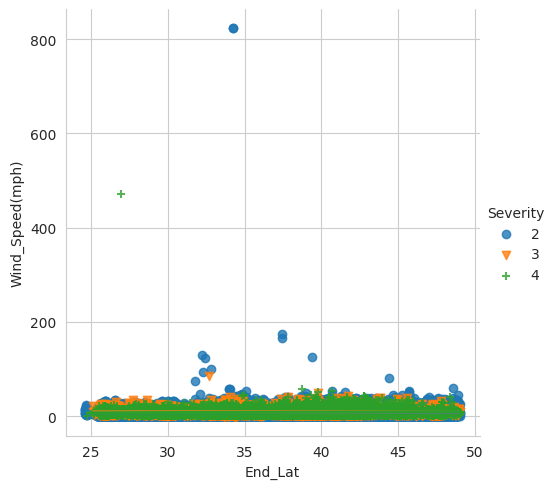

In [ ]:
for i in continuous_col:
  regression_plot('End_Lat',i)

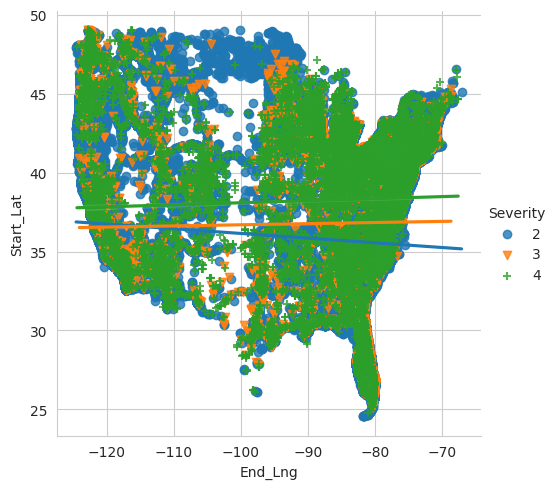

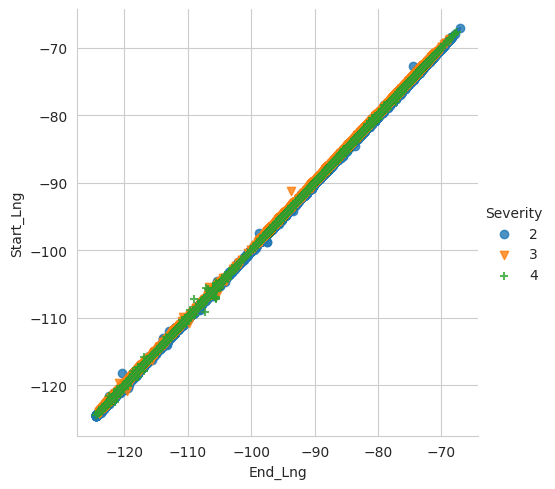

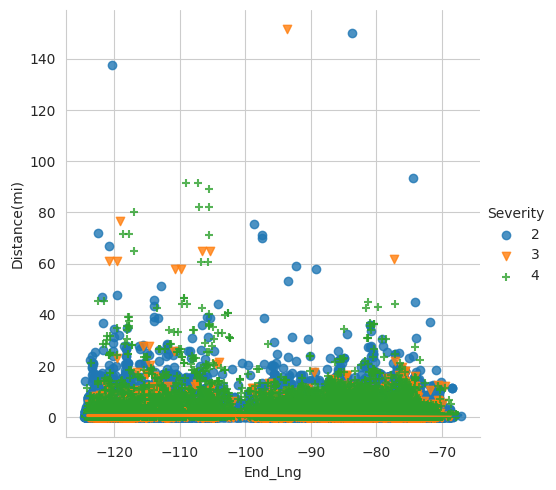

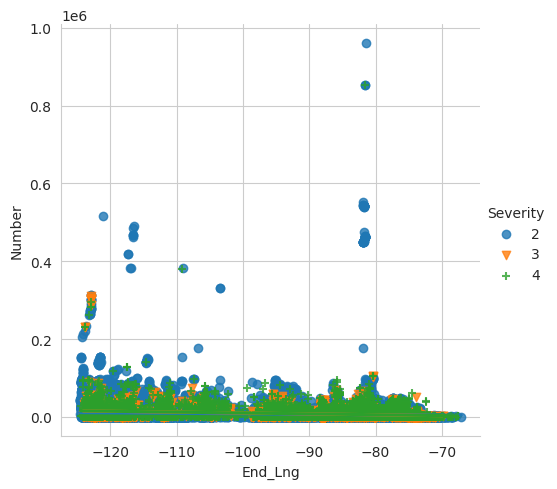

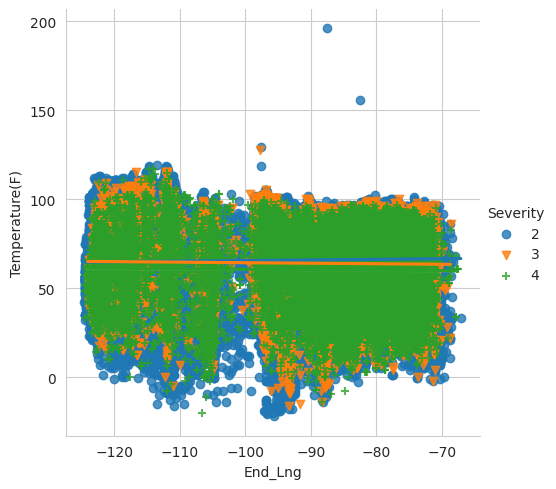

...

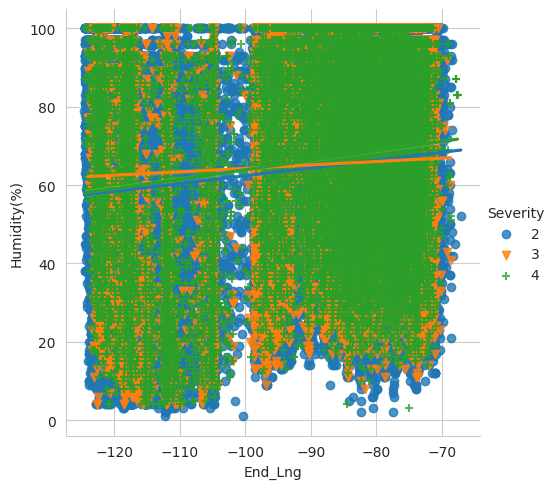

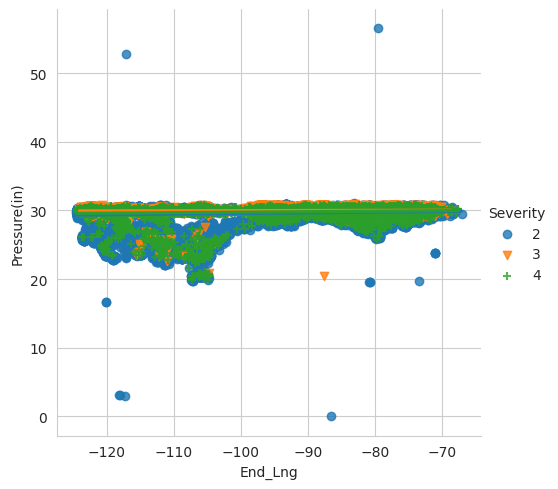

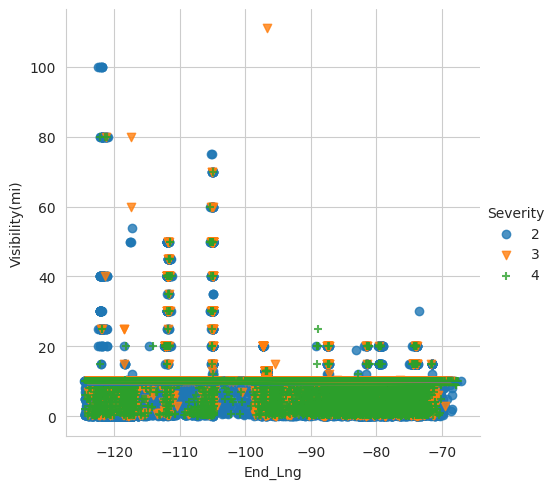

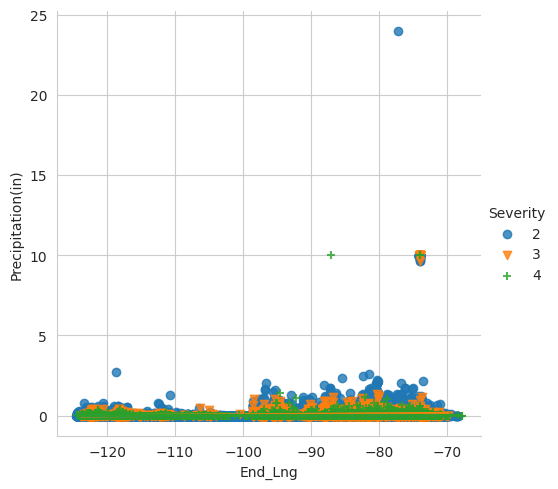

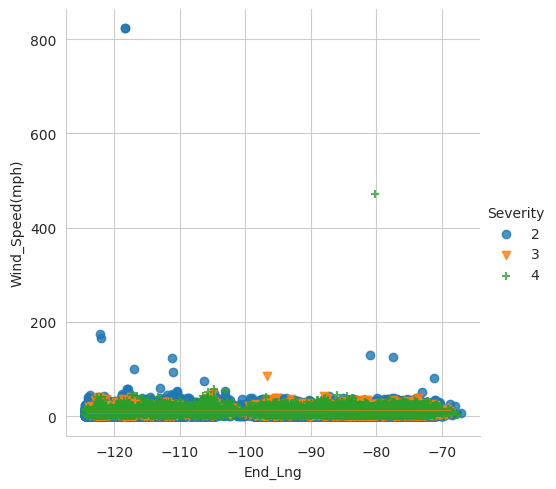

In [ ]:
for i in continuous_col:
  regression_plot('End_Lng',i)

In [ ]:
def hist_2d(col1, col2):
    col1_clean = data[col1].fillna(data[col1].mean())
    col2_clean = data[col2].fillna(data[col2].mean())
    plt.hist2d(col1_clean, col2_clean, bins=30, cmap='coolwarm')
    plt.colorbar()
    plt.xlabel(col1)
    plt.ylabel(col2)
    plt.show()



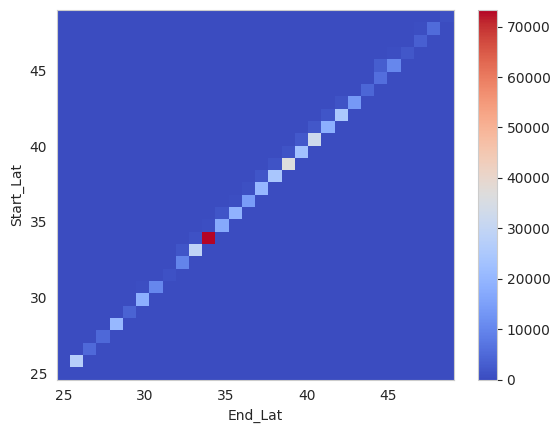

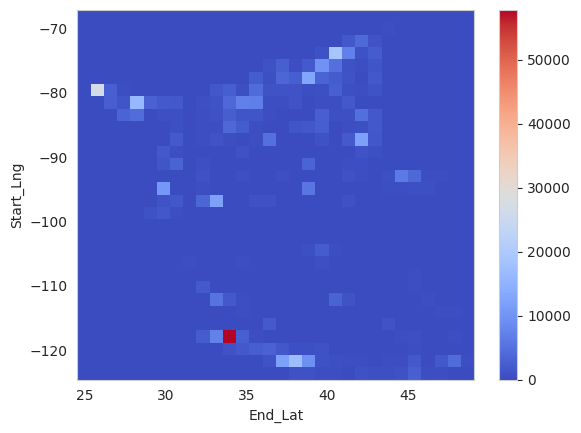

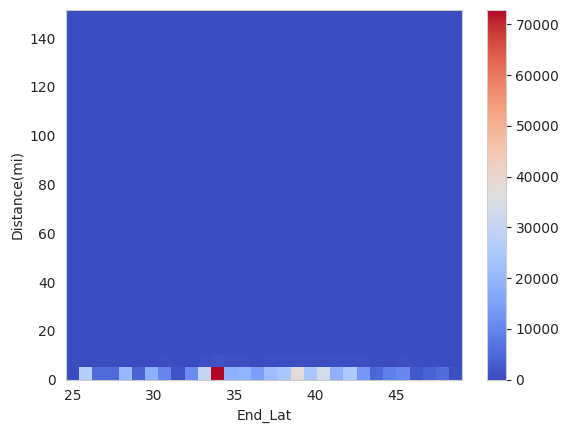

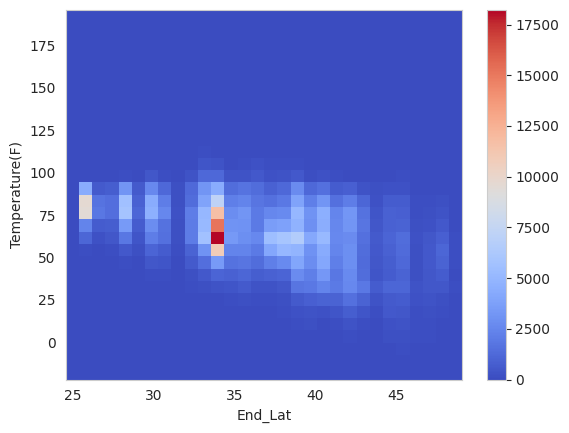

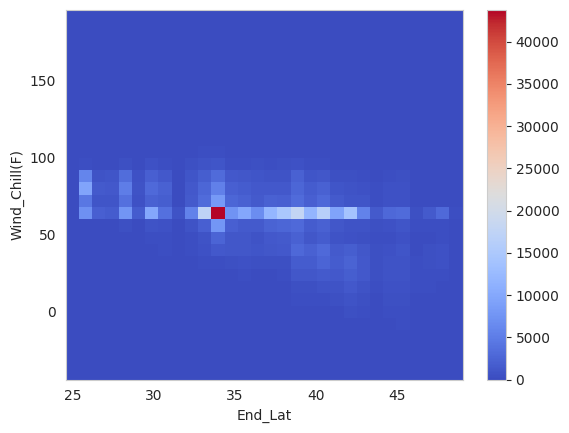

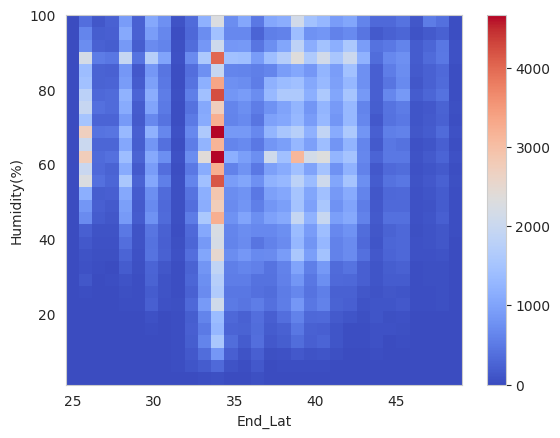

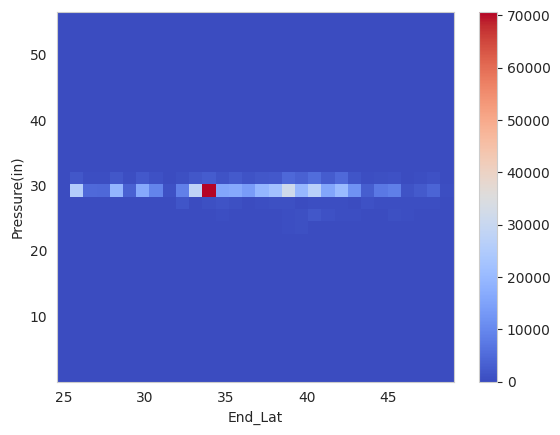

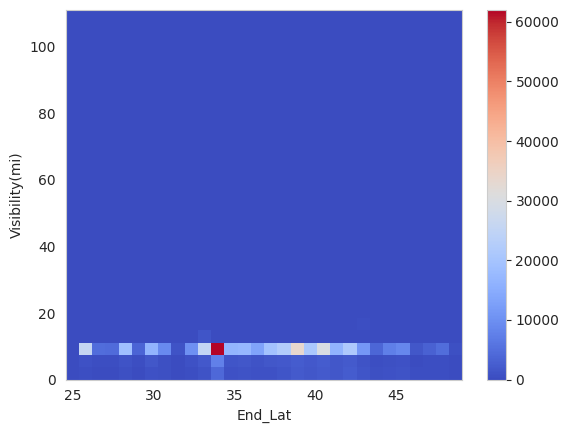

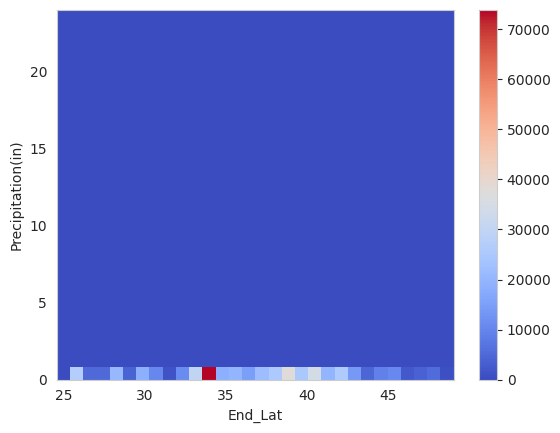

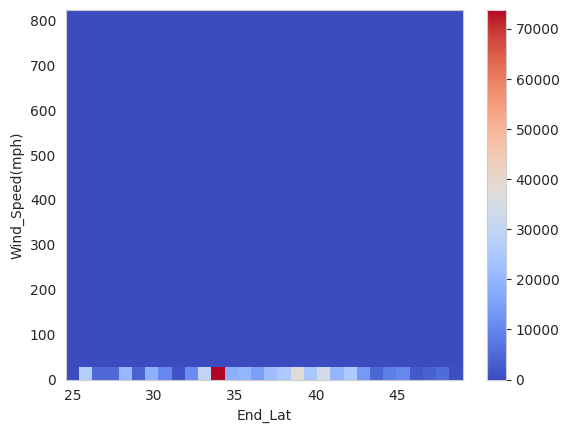

In [ ]:
for i in continuous_col:
  hist_2d('End_Lat',i)

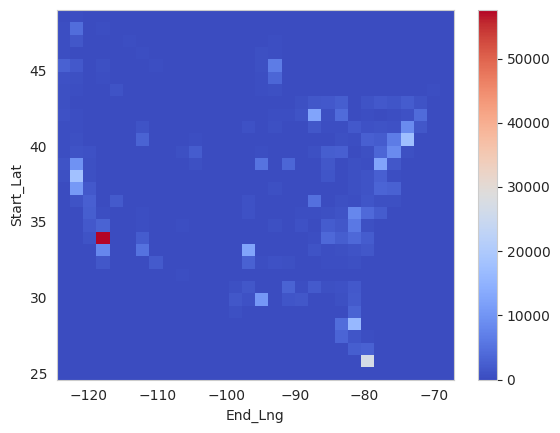

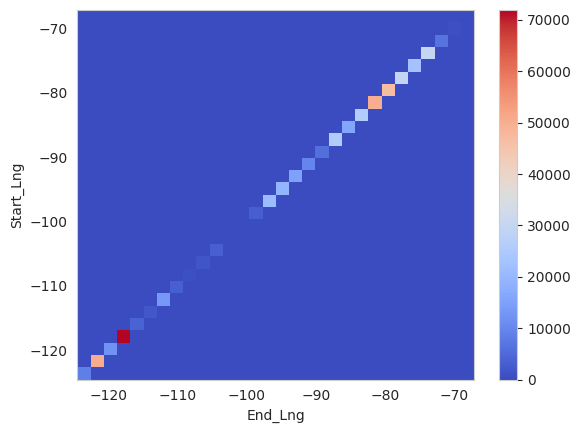

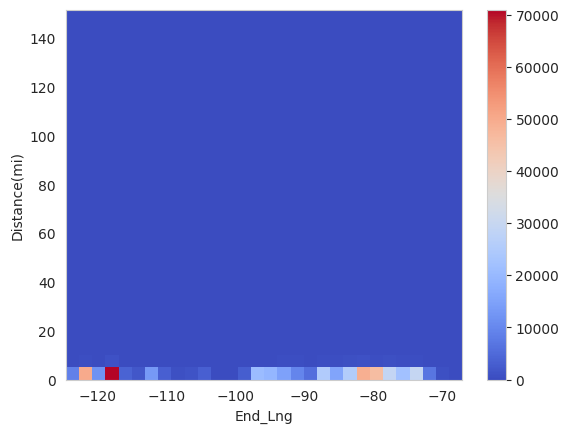

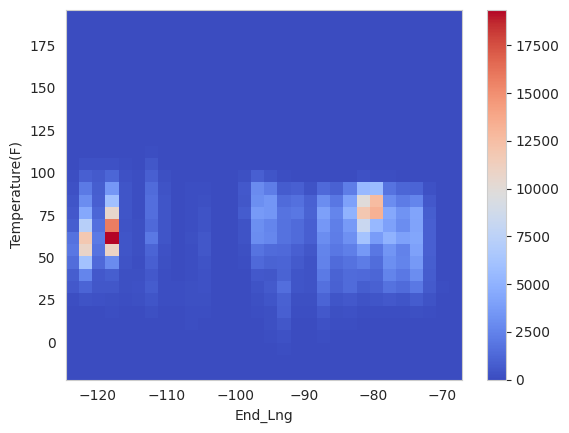

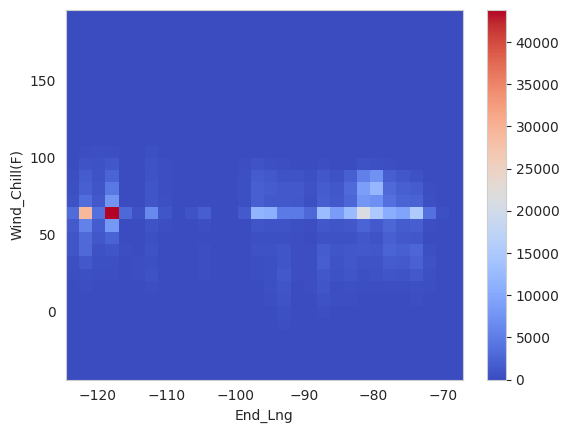

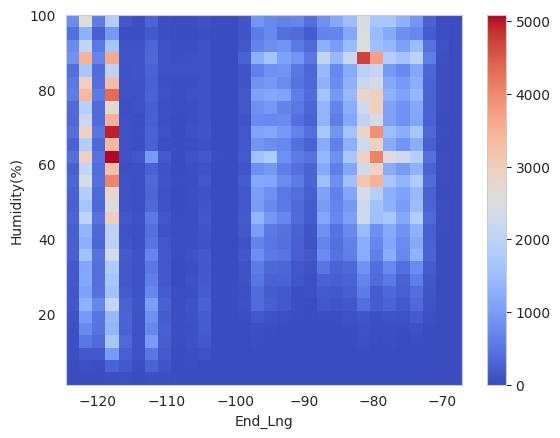

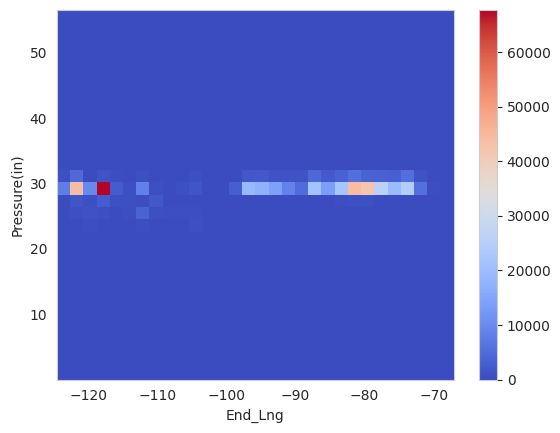

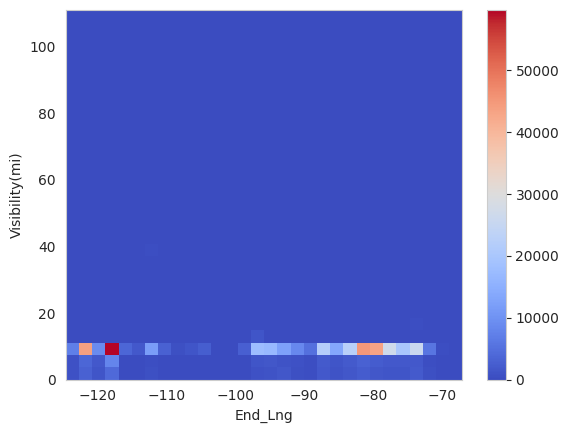

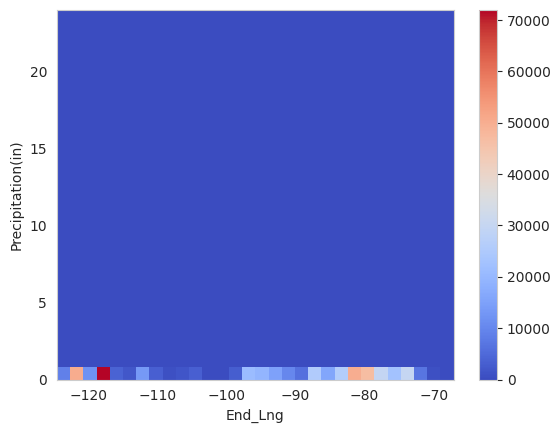

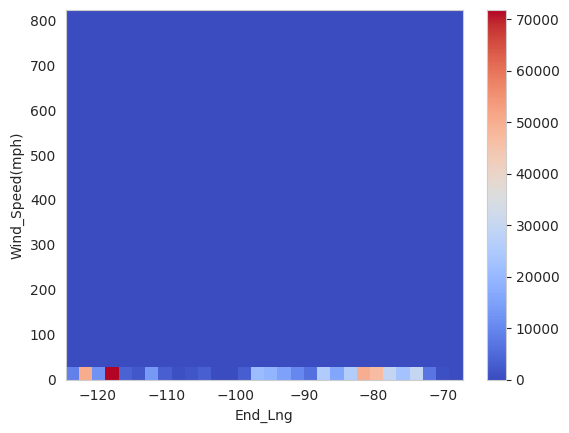

In [ ]:
for i in continuous_col:
  hist_2d('End_Lng',i)

In [ ]:
def box_plot(col1,col2):
  df = pd.DataFrame().assign(x=data[col1], y=data[col2])
  df.rename(columns = {'x':col1,'y':col2}, inplace = True)
  df.boxplot()
  plt.ylabel('Value')
  plt.show()

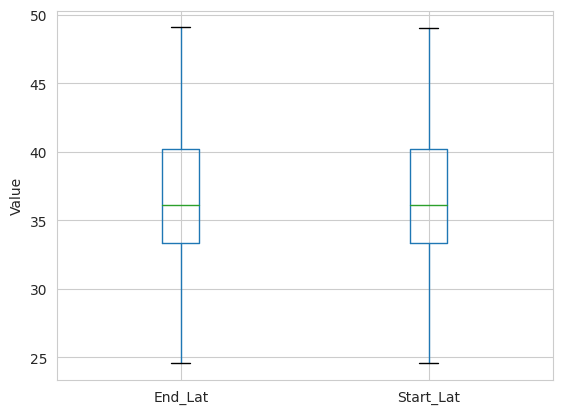

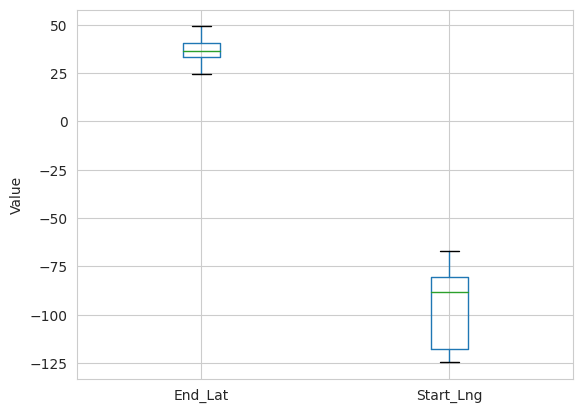

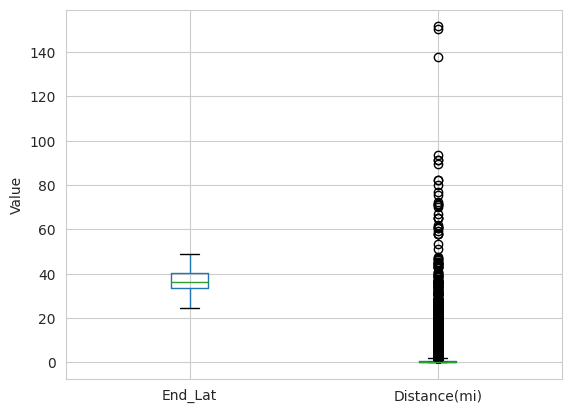

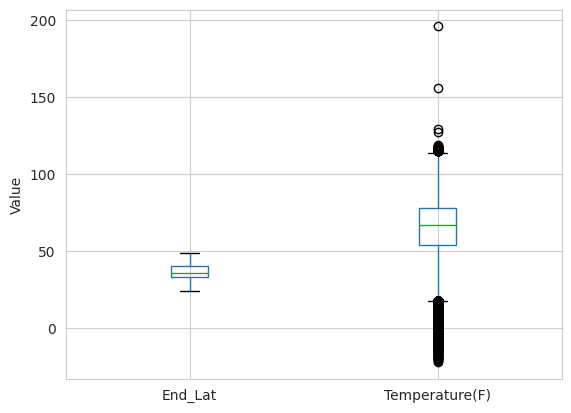

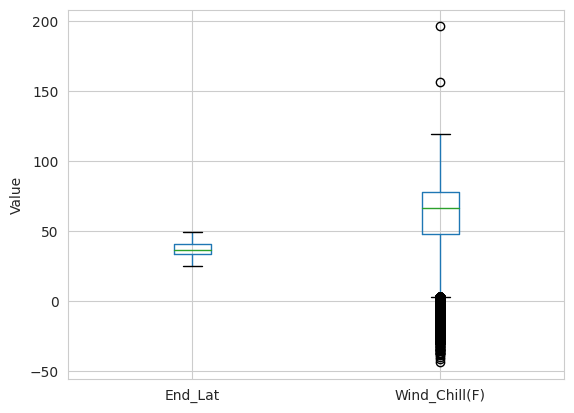

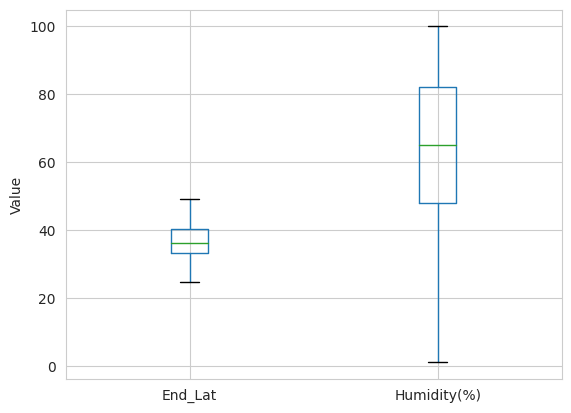

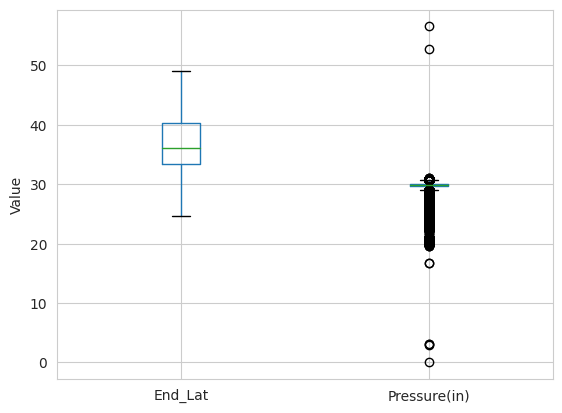

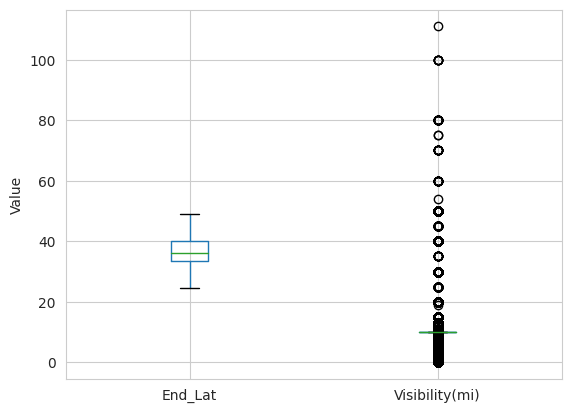

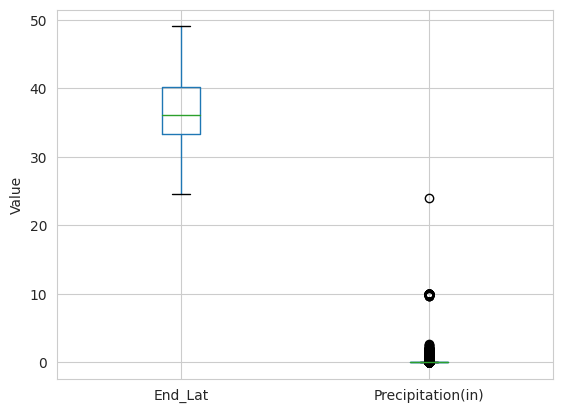

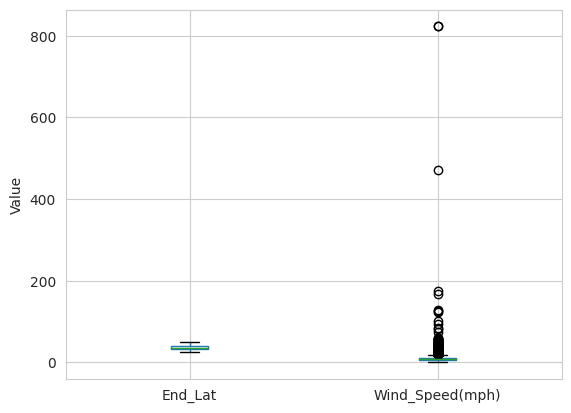

In [ ]:
for i in continuous_col:
  box_plot('End_Lat',i)

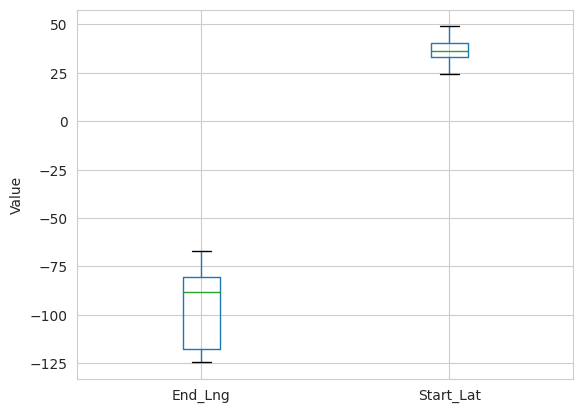

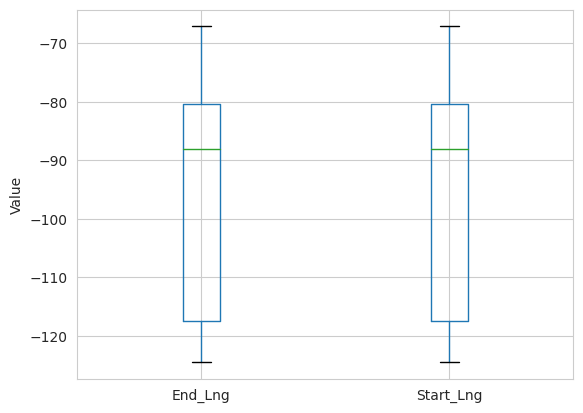

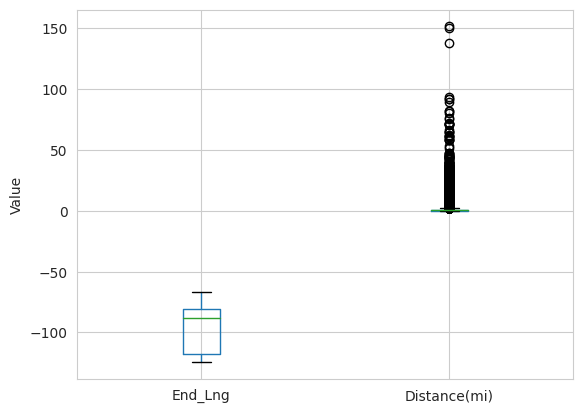

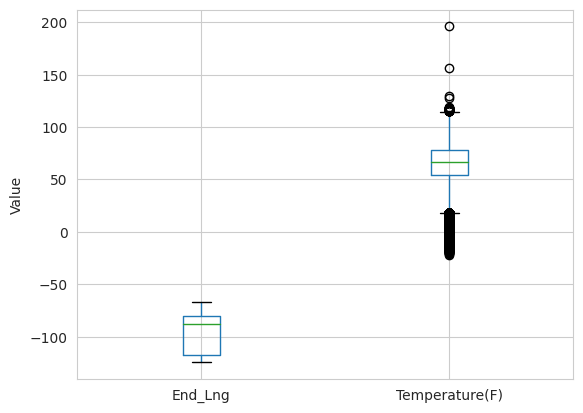

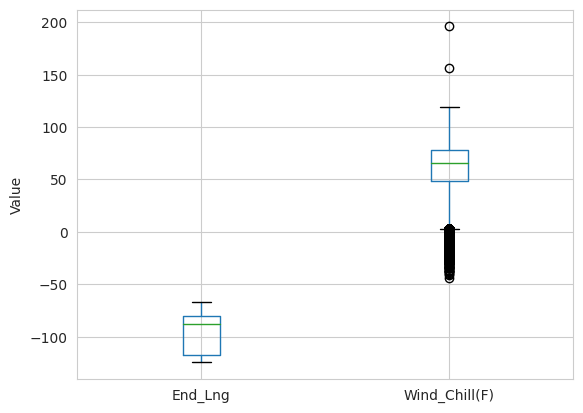

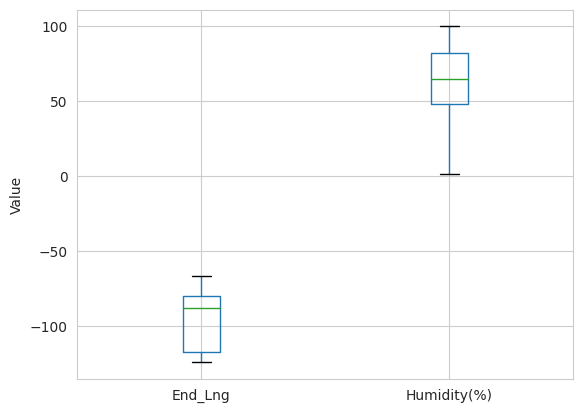

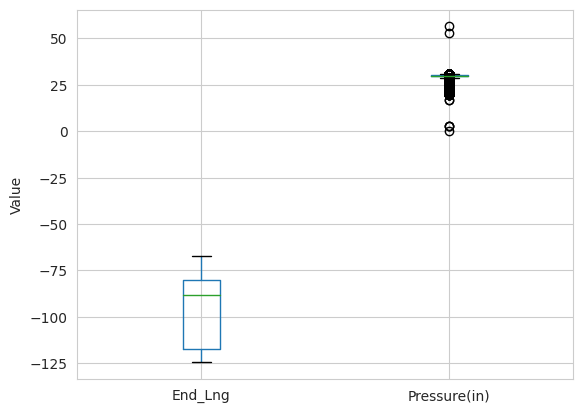

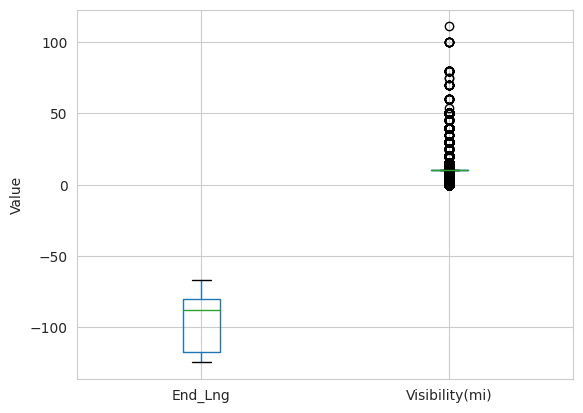

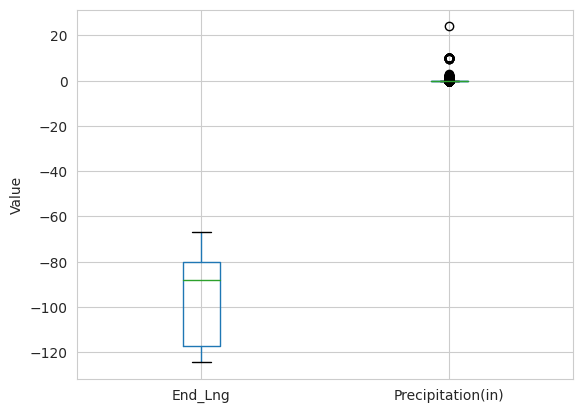

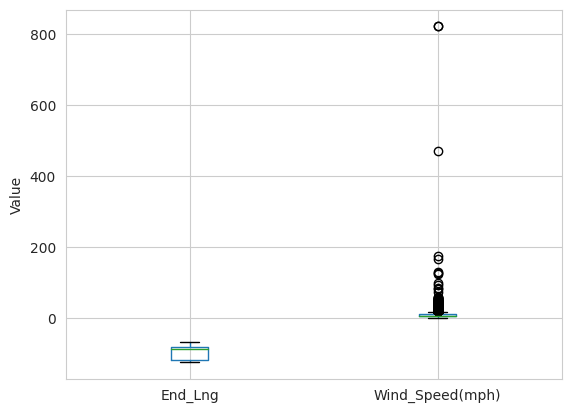

In [ ]:
for i in continuous_col:
  box_plot('End_Lng',i)

## cat_num

In [ ]:
categorical_col=['Amenity','Bump','Crossing','Give_Way','Junction','No_Exit','Railway','Roundabout','Station','Stop','Traffic_Calming','Traffic_Signal','Turning_Loop','Country','State','Side','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight']

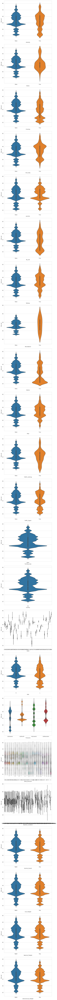

In [ ]:
import seaborn as sns

fig, axs = plt.subplots(nrows=len(categorical_col), figsize=(8, 6*len(categorical_col)))
for i, col in enumerate(categorical_col):
    ax = axs[i]
    sns.violinplot(x=col, y='End_Lat', data=data, ax=ax)
    ax.set_xlabel(col)
    ax.set_ylabel('End_Lat')

plt.tight_layout()
plt.show()

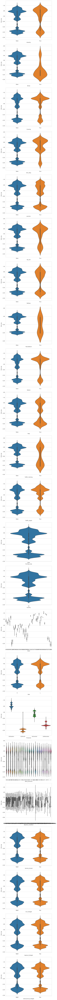

In [ ]:
import seaborn as sns

fig, axs = plt.subplots(nrows=len(categorical_col), figsize=(8, 6*len(categorical_col)))
for i, col in enumerate(categorical_col):
    ax = axs[i]
    sns.violinplot(x=col, y='End_Lng', data=data, ax=ax)
    ax.set_xlabel(col)
    ax.set_ylabel('End_Lng')

plt.tight_layout()
plt.show()

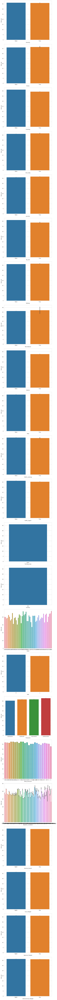

In [ ]:
import seaborn as sns

fig, axs = plt.subplots(nrows=len(categorical_col), figsize=(8, 6*len(categorical_col)))
for i, col in enumerate(categorical_col):
    ax = axs[i]
    sns.barplot(x=col, y='End_Lat', data=data, ax=ax)
    ax.set_xlabel(col)
    ax.set_ylabel('End_Lat')

plt.tight_layout()
plt.show()

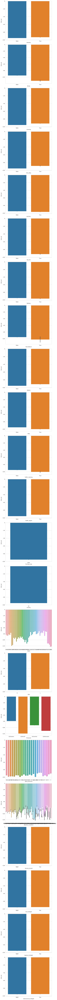

In [ ]:
import seaborn as sns

fig, axs = plt.subplots(nrows=len(categorical_col), figsize=(8, 6*len(categorical_col)))
for i, col in enumerate(categorical_col):
    ax = axs[i]
    sns.barplot(x=col, y='End_Lng', data=data, ax=ax)
    ax.set_xlabel(col)
    ax.set_ylabel('End_Lat')

plt.tight_layout()
plt.show()

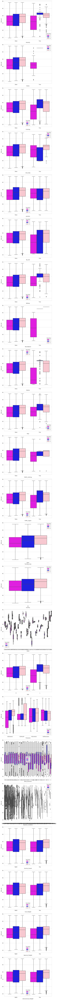

In [ ]:
import seaborn as sns

fig, axs = plt.subplots(nrows=len(categorical_col), figsize=(8, 6*len(categorical_col)))
for i, col in enumerate(categorical_col):
    ax = axs[i]
    sns.boxplot(x=col, y='End_Lat', data=data, ax=ax,hue="Severity",palette={2: "magenta", 3: "blue",4:"pink"})
    ax.set_xlabel(col)
    ax.set_ylabel('End_Lat')

plt.tight_layout()
plt.show()

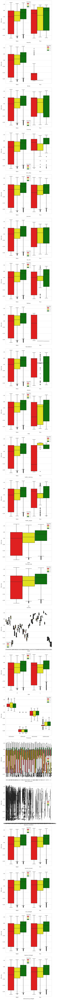

In [ ]:
import seaborn as sns

fig, axs = plt.subplots(nrows=len(categorical_col), figsize=(8, 6*len(categorical_col)))
for i, col in enumerate(categorical_col):
    ax = axs[i]
    sns.boxplot(x=col, y='End_Lng', data=data, ax=ax,hue="Severity",palette={2: "red", 3: "yellow",4:"green"})
    ax.set_xlabel(col)
    ax.set_ylabel('End_Lng')

plt.tight_layout()
plt.show()

In [ ]:
data.End_Time=pd.to_datetime(data.End_Time)
data['Month']=data['End_Time'].dt.month
data['Year']=data['End_Time'].dt.year
data['Hour']=data['End_Time'].dt.hour
data['Weekday']=data['End_Time'].dt.weekday

In [ ]:
del data['Country']
del data['Turning_Loop']
del data['Roundabout']
del data['Bump']

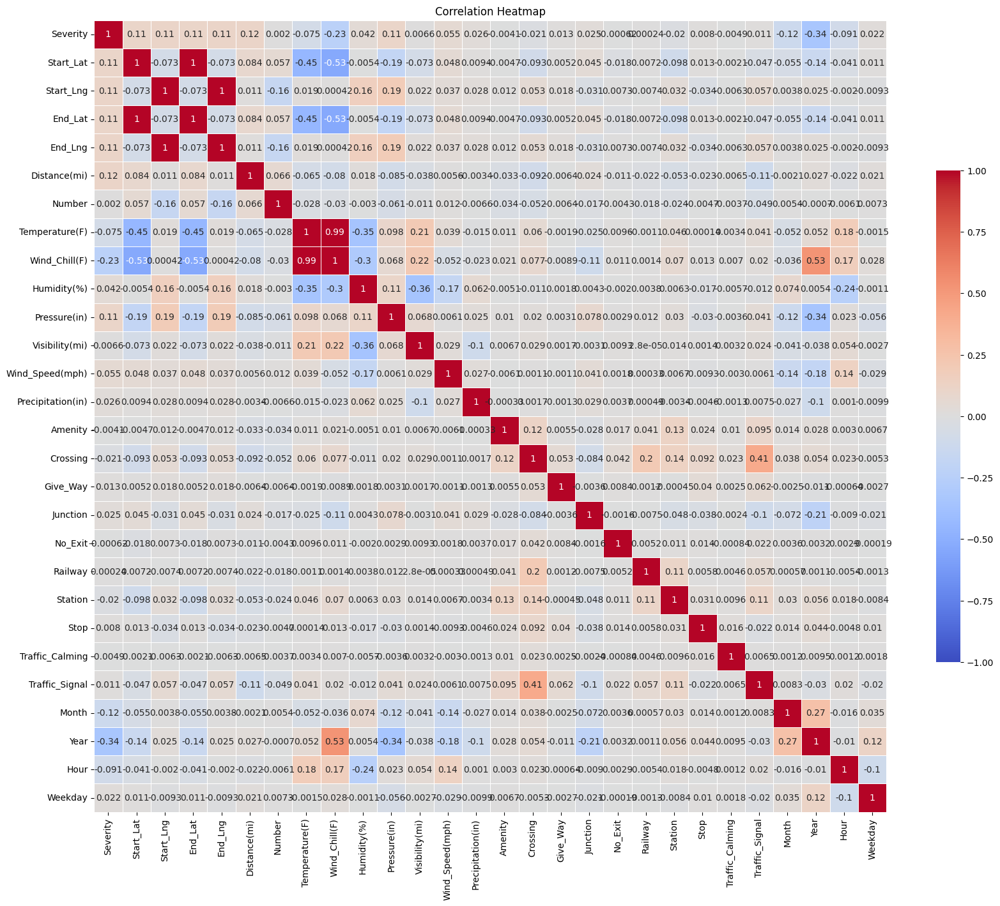

In [ ]:
correlation_heatmap()

In [ ]:
print(data.columns)

In [ ]:
correlation_heatmap()

In [ ]:
def delete_low_corr_cols(data):
    corr_matrix=data.corr()
    severity_corr=corr_matrix['End_Lat']
    low_corr_cols=severity_corr[abs(severity_corr)<0.01].index.tolist()
    data=data.drop(columns=low_corr_cols)
    print(low_corr_cols)
    corr_matrix=data.corr()
    severity_corr=corr_matrix['End_Lng']
    low_corr_cols=severity_corr[abs(severity_corr)<0.01].index.tolist()
    print(low_corr_cols)
    data=data.drop(columns=low_corr_cols)
    return data

In [ ]:
data=delete_low_corr_cols(data)

In [ ]:
del data['ID']
del data['Airport_Code']
del data['Description']
del data['Street']
del data['City']
del data['Zipcode']
del data['County']

In [ ]:
get_date_month_year_hour('Start_Time')
get_date_month_year_hour('Weather_Timestamp')
del data['End_Time']

In [ ]:
correlation_heatmap()

In [ ]:
del data['Start_TimeMonth']
del data['Start_TimeYear']
del data['Start_TimeHour']
del data['Start_TimeWeekday']

In [ ]:
numeric_columns=['Temperature(F)','Pressure(in)','Wind_Speed(mph)']
data[numeric_columns]=data[numeric_columns].fillna(data[numeric_columns].mean())
categorical_columns=['Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
for col in categorical_columns:
    data[col].fillna(data[col].mode()[0],inplace=True)

In [ ]:
data.isnull().sum()

In [ ]:
del data['Number']
data['Visibility(mi)'].fillna(data['Visibility(mi)'].mean(),inplace=True)

In [ ]:
data.isnull().sum()

In [ ]:
print(data.info())

In [ ]:
data=pd.get_dummies(data,columns=['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight'],drop_first=True)

In [ ]:
input_data=data.drop(['End_Lat','End_Lng'],axis=1)
output_data=data[['End_Lat','End_Lng']]

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(input_data,output_data,train_size=0.75,random_state=0)
x_train,x_validation,y_train,y_validation=train_test_split(x_train,y_train,train_size=60/75,random_state=1)

In [ ]:
columns=['Distance(mi)','Temperature(F)','Visibility(mi)','Pressure(in)','Wind_Speed(mph)','Year','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
scaler=StandardScaler()
scaler.fit(x_train[columns])
x_train[columns]=(scaler.transform(x_train[columns]))
x_validation[columns]=(scaler.transform(x_validation[columns]))
x_test[columns]=(scaler.transform(x_test[columns]))

In [ ]:
x_train=tensorflow.convert_to_tensor(x_train,dtype=tensorflow.float32)
x_validation=tensorflow.convert_to_tensor(x_validation,dtype=tensorflow.float32)
x_test=tensorflow.convert_to_tensor(x_test,dtype=tensorflow.float32)

In [ ]:
print(x_train.shape)

In [ ]:
def build_model(hp):
    model=Sequential()
    model.add(Dense(units=hp.Int('input_units',min_value=32,max_value=512,step=32),
                           activation=hp.Choice('input_activation', values=['relu', 'tanh', 'sigmoid']),
                           input_shape=(len(input_data.columns),)))
    for i in range(hp.Int('num_layers',min_value=1,max_value=10)):
        model.add(Dense(units=hp.Int(f'layer_{i}_units', min_value=32, max_value=512, step=32),
                               activation=hp.Choice(f'layer_{i}_activation', values=['relu', 'tanh', 'sigmoid']),
                               kernel_regularizer=hp.Choice(f'layer_{i}_kernel_regularizer', values=['l1', 'l2']),
                               bias_regularizer=hp.Choice(f'layer_{i}_bias_regularizer', values=['l1', 'l2'])))
        model.add(Dropout(hp.Float(f'layer_{i}_dropout', min_value=0.0, max_value=0.9, step=0.1)))
        if hp.Boolean(f'layer_{i}_batch_normalization'):
            model.add(BatchNormalization())
    model.add(Dense(units=2,activation='linear'))
    model.compile(optimizer=hp.Choice('optimizer',values=['adam','rmsprop', 'sgd']),
                  loss='mean_squared_error',
                  metrics=['mse'])

    return model

In [ ]:
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=5,
    directory='My_final_directory_3000',
    project_name='my_project'
)
early_stopping=keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True
)

In [ ]:
tuner.search(x=x_train,y=y_train,
             epochs=5,
             validation_data=(x_validation,y_validation),
             callbacks=[early_stopping]
        )

In [ ]:
best_hp=tuner.get_best_hyperparameters()[0]
location_model=build_model(best_hp) 

In [ ]:
location_model.fit(x_train,y_train,epochs=100,initial_epoch=6,validation_data=(x_validation,y_validation),callbacks=early_stopping) 

In [ ]:
import pickle 
with open('location_model','wb') as f:
  pickle.dump(location_model,f)

In [ ]:
y_predicted=location_model.predict(x_test)

In [ ]:
print(y_predicted)

In [ ]:
print(y_test)

In [ ]:
mse=tensorflow.keras.losses.mean_squared_error(y_test,y_predicted)

In [ ]:
print(f'Testing Mean Squared Error is {np.array(mse).mean()}')

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project_data.csv',nrows=5e5)

In [ ]:
class DropColumnsTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, columns_to_drop):
        self.columns_to_drop = columns_to_drop
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        return X.drop(self.columns_to_drop, axis=1)

class DateTimeFeatureTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, column_name):
        self.column_name = column_name

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        X[self.column_name] = pd.to_datetime(X[self.column_name])
        X[str(self.column_name)+'Month'] = X[self.column_name].dt.month
        X[str(self.column_name)+'Year'] = X[self.column_name].dt.year
        X[str(self.column_name)+'Hour'] = X[self.column_name].dt.hour
        X[str(self.column_name)+'Weekday'] = X[self.column_name].dt.weekday
        del X[self.column_name]
        return X

In [ ]:
columns_to_drop=['Bump','Roundabout','Turning_Loop','Country','Number', 'Visibility(mi)', 'Amenity', 'Bump', 'No_Exit', 'Railway', 'Roundabout', 'Stop', 'Traffic_Calming','Wind_Chill(F)','Start_Lat','Start_Lng','Description','Street',
'City','Zipcode','Airport_Code','ID','County','Start_TimeMonth','Start_TimeYear','Start_TimeHour','Start_TimeWeekday']

In [ ]:
numeric_columns=['End_Lat','End_Lng','Distance(mi)','Temperature(F)','Humidity(%)','Pressure(in)','Wind_Speed(mph)','Precipitation(in)','End_TimeMonth','End_TimeYear','End_TimeHour','End_TimeWeekday','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
categorical_columns=['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight']

In [ ]:
numeric_transformer=Pipeline(steps=[
    ('standardize',StandardScaler()),
    ('imputer',SimpleImputer(strategy='mean')),
    ('precipitation_imputer',SimpleImputer(strategy='constant',fill_value=0.00))
])
categorical_transformer=Pipeline(steps=[
    ('imputer',SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(drop='first',handle_unknown='ignore'))
])
preprocessor=ColumnTransformer(
    transformers=[
        ('num',numeric_transformer,numeric_columns),
        ('cat',categorical_transformer,categorical_columns)
    ],remainder='passthrough')

In [ ]:
output_data=data['Severity']
del data['Severity']
input_data=data

In [ ]:
severity_pipeline=Pipeline([
    ('datetime_feature_transformer_weather',DateTimeFeatureTransformer('Weather_Timestamp')),
    ('datetime_feature_transformer_end_time',DateTimeFeatureTransformer('End_Time')),
    ('datetime_feature_transformer_start_time',DateTimeFeatureTransformer('Start_Time')),
    ('drop_columns',DropColumnsTransformer(columns_to_drop)),
    ('preprocessor',preprocessor),
])

In [ ]:
input_data=severity_pipeline.fit_transform(input_data)

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(input_data,output_data,train_size=0.75,random_state=0)
x_train,x_validation,y_train,y_validation=train_test_split(x_train,y_train,train_size=60/75,random_state=1)

In [ ]:
x_train=x_train.toarray()
x_validation=x_validation.toarray()
x_test=x_test.toarray()

In [ ]:
y_train=np.array(pd.get_dummies(y_train))
y_validation=np.array(pd.get_dummies(y_validation))
y_test=np.array(pd.get_dummies(y_test))

In [ ]:
x_train=tensorflow.convert_to_tensor(x_train,dtype=tensorflow.float32)
x_validation=tensorflow.convert_to_tensor(x_validation,dtype=tensorflow.float32)
x_test=tensorflow.convert_to_tensor(x_test,dtype=tensorflow.float32)

In [ ]:
with open('severity_model','rb') as f:
    severity_model=pickle.load(f)

In [ ]:
y_predicted=np.argmax(severity_model.predict(x_test),axis=1)
y_test=np.argmax(y_test,axis=1)

In [ ]:
#Visualize pipeline
set_config(display='diagram')
severity_pipeline

In [ ]:
with open('severity_pipeline','wb') as f:
  pickle.dump(severity_pipeline,f) 

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project_data.csv',nrows=5e5)

In [ ]:
#Location pipeline
class DropColumnsTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, columns_to_drop):
        self.columns_to_drop = columns_to_drop
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        return X.drop(self.columns_to_drop, axis=1)

class DateTimeFeatureTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, column_name):
        self.column_name = column_name

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        X[self.column_name] = pd.to_datetime(X[self.column_name])
        X[str(self.column_name)+'Month'] = X[self.column_name].dt.month
        X[str(self.column_name)+'Year'] = X[self.column_name].dt.year
        X[str(self.column_name)+'Hour'] = X[self.column_name].dt.hour
        X[str(self.column_name)+'Weekday'] = X[self.column_name].dt.weekday
        del X[self.column_name]
        return X

In [ ]:
columns_to_drop=['Country','Turning_Loop','Roundabout','Bump','Humidity(%)', 'Precipitation(in)', 'Amenity', 'Give_Way', 'Railway', 'Traffic_Calming','Wind_Chill(F)', 'No_Exit', 'End_TimeMonth', 'End_TimeHour', 'End_TimeWeekday','ID','Airport_Code','Description','Street','City','Zipcode','County','Start_TimeYear','Start_TimeHour','Start_TimeWeekday','Start_TimeMonth','Number']

In [ ]:
numeric_columns=['Distance(mi)','Temperature(F)','Visibility(mi)','End_TimeYear','Pressure(in)','Wind_Speed(mph)','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
categorical_columns=['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight']

In [ ]:
numeric_transformer=Pipeline(steps=[
    ('standardize',StandardScaler()),
    ('imputer',SimpleImputer(strategy='mean'))
])
categorical_transformer=Pipeline(steps=[
    ('imputer',SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(drop='first',handle_unknown='ignore'))
])
preprocessor=ColumnTransformer(
    transformers=[
        ('num',numeric_transformer,numeric_columns),
        ('cat',categorical_transformer,categorical_columns)
    ],remainder='passthrough')

In [ ]:
output_data=data[['End_Lat','End_Lng']]
del data['End_Lat']
del data['End_Lng']
input_data=data

In [ ]:
location_pipeline=Pipeline([
    ('datetime_feature_transformer_weather',DateTimeFeatureTransformer('Weather_Timestamp')),
    ('datetime_feature_transformer_end_time',DateTimeFeatureTransformer('End_Time')),
    ('datetime_feature_transformer_start_time',DateTimeFeatureTransformer('Start_Time')),
    ('drop_columns',DropColumnsTransformer(columns_to_drop)),
    ('preprocessor',preprocessor),
])

In [ ]:
input_data=location_pipeline.fit_transform(input_data)

In [ ]:
#Visualize pipeline
set_config(display='diagram')
location_pipeline

In [ ]:
with open('location_model','rb') as f:
    location_model=pickle.load(f)

In [ ]:
y_predicted=location_model.predict(x_test)

In [ ]:
print(y_predicted)

In [ ]:
with open('location_pipeline','wb') as f:
  pickle.dump(location_pipeline,f)

In [ ]:
columns=['Distance(mi)','Temperature(F)','Visibility(mi)','Pressure(in)','Wind_Speed(mph)','Year','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
scaler=StandardScaler()
scaler.fit(x_train[columns])
x_train[columns]=(scaler.transform(x_train[columns]))
x_validation[columns]=(scaler.transform(x_validation[columns]))
x_test[columns]=(scaler.transform(x_test[columns]))

In [ ]:
x_train=tensorflow.convert_to_tensor(x_train,dtype=tensorflow.float32)
x_validation=tensorflow.convert_to_tensor(x_validation,dtype=tensorflow.float32)
x_test=tensorflow.convert_to_tensor(x_test,dtype=tensorflow.float32)

In [ ]:
print(x_train.shape)

(300000, 188)


In [ ]:
def build_model(hp):
    model=Sequential()
    model.add(Dense(units=hp.Int('input_units',min_value=32,max_value=512,step=32),
                           activation=hp.Choice('input_activation', values=['relu', 'tanh', 'sigmoid']),
                           input_shape=(len(input_data.columns),)))
    for i in range(hp.Int('num_layers',min_value=1,max_value=10)):
        model.add(Dense(units=hp.Int(f'layer_{i}_units', min_value=32, max_value=512, step=32),
                               activation=hp.Choice(f'layer_{i}_activation', values=['relu', 'tanh', 'sigmoid']),
                               kernel_regularizer=hp.Choice(f'layer_{i}_kernel_regularizer', values=['l1', 'l2']),
                               bias_regularizer=hp.Choice(f'layer_{i}_bias_regularizer', values=['l1', 'l2'])))
        model.add(Dropout(hp.Float(f'layer_{i}_dropout', min_value=0.0, max_value=0.9, step=0.1)))
        if hp.Boolean(f'layer_{i}_batch_normalization'):
            model.add(BatchNormalization())
    model.add(Dense(units=2,activation='linear'))
    model.compile(optimizer=hp.Choice('optimizer',values=['adam','rmsprop', 'sgd']),
                  loss='mean_squared_error',
                  metrics=['mse'])

    return model

In [ ]:
tuner = kt.RandomSearch(
    build_model,
    objective='val_loss',
    max_trials=5,
    directory='My_final_directory_3000',
    project_name='my_project'
)
early_stopping=keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=3,
    restore_best_weights=True
)

In [ ]:
tuner.search(x=x_train,y=y_train,
             epochs=5,
             validation_data=(x_validation,y_validation),
             callbacks=[early_stopping]
        )

Trial 5 Complete [00h 05m 24s]
val_loss: 175.1054229736328

Best val_loss So Far: 0.9923053979873657
Total elapsed time: 00h 24m 02s


In [ ]:
best_hp=tuner.get_best_hyperparameters()[0]
location_model=build_model(best_hp) 

In [ ]:
location_model.fit(x_train,y_train,epochs=100,initial_epoch=6,validation_data=(x_validation,y_validation),callbacks=early_stopping) 

Epoch 7/100
9375/9375 [==============================] - 34s 3ms/step - loss: 20.2991 - mse: 13.0939 - val_loss: 2.2267 - val_mse: 0.1096
Epoch 8/100
9375/9375 [==============================] - 34s 4ms/step - loss: 8.3813 - mse: 6.9165 - val_loss: 1.4379 - val_mse: 0.2166
Epoch 9/100
9375/9375 [==============================] - 32s 3ms/step - loss: 7.0229 - mse: 5.9691 - val_loss: 0.9750 - val_mse: 0.0778
Epoch 10/100
9375/9375 [==============================] - 32s 3ms/step - loss: 6.3427 - mse: 5.5084 - val_loss: 0.9566 - val_mse: 0.2132
Epoch 11/100
9375/9375 [==============================] - 32s 3ms/step - loss: 6.0144 - mse: 5.2869 - val_loss: 0.7407 - val_mse: 0.0837
Epoch 12/100
9375/9375 [==============================] - 32s 3ms/step - loss: 5.7776 - mse: 5.1080 - val_loss: 1.3781 - val_mse: 0.7368
Epoch 13/100
9375/9375 [==============================] - 32s 3ms/step - loss: 5.6153 - mse: 4.9936 - val_loss: 0.8471 - val_mse: 0.2502
Epoch 14/100
9375/9375 [==================

In [ ]:
import pickle 
with open('location_model','wb') as f:
  pickle.dump(location_model,f)

In [ ]:
y_predicted=location_model.predict(x_test)

3907/3907 [==============================] - 8s 2ms/step


In [ ]:
print(y_predicted)

[[  34.973106  -80.79473 ]
 [  30.009634  -93.02018 ]
 [  41.23828   -81.95166 ]
 ...
 [  34.96531   -85.53509 ]
 [  34.84378  -119.98987 ]
 [  25.921661  -80.3165  ]]


In [ ]:
print(y_test)

          End_Lat     End_Lng
194257  35.214570  -80.854590
396319  30.198083  -93.277093
138738  41.461120  -81.694160
66570   42.975595  -90.132807
149424  27.298800  -82.496861
...           ...         ...
254749  33.460894 -112.085488
186957  45.069670  -93.296760
280743  35.051570  -85.298194
223365  34.590130 -120.032630
276946  25.923407  -80.293263

[125000 rows x 2 columns]


In [ ]:
mse=tensorflow.keras.losses.mean_squared_error(y_test,y_predicted)

In [ ]:
print(f'Testing Mean Squared Error is {np.array(mse).mean()}')

Testing Mean Squared Error is 0.08314898610115051


In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project_data.csv',nrows=5e5)

In [ ]:
class DropColumnsTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, columns_to_drop):
        self.columns_to_drop = columns_to_drop
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        return X.drop(self.columns_to_drop, axis=1)

class DateTimeFeatureTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, column_name):
        self.column_name = column_name

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        X[self.column_name] = pd.to_datetime(X[self.column_name])
        X[str(self.column_name)+'Month'] = X[self.column_name].dt.month
        X[str(self.column_name)+'Year'] = X[self.column_name].dt.year
        X[str(self.column_name)+'Hour'] = X[self.column_name].dt.hour
        X[str(self.column_name)+'Weekday'] = X[self.column_name].dt.weekday
        del X[self.column_name]
        return X

In [ ]:
columns_to_drop=['Bump','Roundabout','Turning_Loop','Country','Number', 'Visibility(mi)', 'Amenity', 'Bump', 'No_Exit', 'Railway', 'Roundabout', 'Stop', 'Traffic_Calming','Wind_Chill(F)','Start_Lat','Start_Lng','Description','Street',
'City','Zipcode','Airport_Code','ID','County','Start_TimeMonth','Start_TimeYear','Start_TimeHour','Start_TimeWeekday']

In [ ]:
MinMax_columns=['End_Lat','End_Lng','Humidity(%)','End_TimeMonth','End_TimeYear','End_TimeHour','End_TimeWeekday','Weather_TimestampMonth','Weather_TimestampYear']
Robust_columns=['Distance(mi)','Temperature(F)','Pressure(in)','Precipitation(in)','Wind_Speed(mph)']

In [ ]:
minmax_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', MinMaxScaler())
])

robust_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', RobustScaler())
])
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(drop='first', handle_unknown='ignore'))
])
preprocessor = ColumnTransformer(
    transformers=[
        ('num_minmax', minmax_transformer, MinMax_columns),
        ('num_robust', robust_transformer, Robust_columns),
        ('cat', categorical_transformer, categorical_columns)
    ],
    remainder='passthrough'
)

In [ ]:
output_data=data['Severity']
del data['Severity']
input_data=data

In [ ]:
severity_pipeline=Pipeline([
    ('datetime_feature_transformer_weather',DateTimeFeatureTransformer('Weather_Timestamp')),
    ('datetime_feature_transformer_end_time',DateTimeFeatureTransformer('End_Time')),
    ('datetime_feature_transformer_start_time',DateTimeFeatureTransformer('Start_Time')),
    ('drop_columns',DropColumnsTransformer(columns_to_drop)),
    ('preprocessor',preprocessor),
])

In [ ]:
input_data=severity_pipeline.fit_transform(input_data)

In [ ]:
set_config(display='diagram')
severity_pipeline

Pipeline(steps=[('datetime_feature_transformer_weather',
                 DateTimeFeatureTransformer(column_name='Weather_Timestamp')),
                ('datetime_feature_transformer_end_time',
                 DateTimeFeatureTransformer(column_name='End_Time')),
                ('datetime_feature_transformer_start_time',
                 DateTimeFeatureTransformer(column_name='Start_Time')),
                ('drop_columns',
                 DropColumnsTransformer(colu...
                                                   'Temperature(F)',
                                                   'Pressure(in)',
                                                   'Precipitation(in)',
                                                   'Wind_Speed(mph)']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore'))]),
                                                  ['Side', 'State', 'Timezone',
                                                   'Wind_Direction',
                                                   'Weather_Condition',
                                                   'Sunrise_Sunset',
                                                   'Civil_Twilight',
                                                   'Nautical_Twilight',
                                                   'Astronomical_Twilight'])]))])

In [ ]:
x_train,x_test,y_train,y_test=train_test_split(input_data,output_data,train_size=0.75,random_state=0)
x_train,x_validation,y_train,y_validation=train_test_split(x_train,y_train,train_size=60/75,random_state=1)

In [ ]:
x_train=x_train.toarray()
x_validation=x_validation.toarray()
x_test=x_test.toarray()

In [ ]:
y_train=np.array(pd.get_dummies(y_train))
y_validation=np.array(pd.get_dummies(y_validation))
y_test=np.array(pd.get_dummies(y_test))

In [ ]:
x_train=tensorflow.convert_to_tensor(x_train,dtype=tensorflow.float32)
x_validation=tensorflow.convert_to_tensor(x_validation,dtype=tensorflow.float32)
x_test=tensorflow.convert_to_tensor(x_test,dtype=tensorflow.float32)

In [ ]:
with open('severity_model','rb') as f:
    severity_model=pickle.load(f)

In [ ]:
from joblib import dump
dump(severity_model,'/content/severity_model.joblib')

['/content/severity_model.joblib']

In [ ]:
y_predicted=np.argmax(severity_model.predict(x_test),axis=1)
y_test=np.argmax(y_test,axis=1)

3907/3907 [==============================] - 8s 2ms/step


In [ ]:
with open('severity_pipeline','wb') as f:
  pickle.dump(severity_pipeline,f) 

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project_data.csv',nrows=5e5)

In [ ]:
#Location pipeline
class DropColumnsTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, columns_to_drop):
        self.columns_to_drop = columns_to_drop
    
    def fit(self, X, y=None):
        return self
    
    def transform(self, X):
        return X.drop(self.columns_to_drop, axis=1)

class DateTimeFeatureTransformer(BaseEstimator, TransformerMixin):
    def __init__(self, column_name):
        self.column_name = column_name

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        X[self.column_name] = pd.to_datetime(X[self.column_name])
        X[str(self.column_name)+'Month'] = X[self.column_name].dt.month
        X[str(self.column_name)+'Year'] = X[self.column_name].dt.year
        X[str(self.column_name)+'Hour'] = X[self.column_name].dt.hour
        X[str(self.column_name)+'Weekday'] = X[self.column_name].dt.weekday
        del X[self.column_name]
        return X

In [ ]:
columns_to_drop=['Country','Turning_Loop','Roundabout','Bump','Humidity(%)','Precipitation(in)', 'Amenity', 'Give_Way', 'Railway', 'Traffic_Calming','Wind_Chill(F)', 'No_Exit', 'End_TimeMonth', 'End_TimeHour', 'End_TimeWeekday','ID','Airport_Code','Description','Street','City','Zipcode','County','Start_TimeYear','Start_TimeHour','Start_TimeWeekday','Start_TimeMonth','Number']

In [ ]:
numeric_columns=['Distance(mi)','Temperature(F)','Visibility(mi)','End_TimeYear','Pressure(in)','Wind_Speed(mph)','Weather_TimestampMonth','Weather_TimestampYear','Weather_TimestampHour','Weather_TimestampWeekday']
categorical_columns=['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight']

In [ ]:
numeric_transformer=Pipeline(steps=[
    ('standardize',StandardScaler()),
    ('imputer',SimpleImputer(strategy='mean'))
])
categorical_transformer=Pipeline(steps=[
    ('imputer',SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(drop='first',handle_unknown='ignore'))
])
preprocessor=ColumnTransformer(
    transformers=[
        ('num',numeric_transformer,numeric_columns),
        ('cat',categorical_transformer,categorical_columns)
    ],remainder='passthrough')

In [ ]:
output_data=data[['End_Lat','End_Lng']]
del data['End_Lat']
del data['End_Lng']
input_data=data

In [ ]:
location_pipeline=Pipeline([
    ('datetime_feature_transformer_weather',DateTimeFeatureTransformer('Weather_Timestamp')),
    ('datetime_feature_transformer_end_time',DateTimeFeatureTransformer('End_Time')),
    ('datetime_feature_transformer_start_time',DateTimeFeatureTransformer('Start_Time')),
    ('drop_columns',DropColumnsTransformer(columns_to_drop)),
    ('preprocessor',preprocessor),
])

In [ ]:
input_data=location_pipeline.fit_transform(input_data)

In [ ]:
#Visualize pipeline
set_config(display='diagram')
location_pipeline

Pipeline(steps=[('datetime_feature_transformer_weather',
                 DateTimeFeatureTransformer(column_name='Weather_Timestamp')),
                ('datetime_feature_transformer_end_time',
                 DateTimeFeatureTransformer(column_name='End_Time')),
                ('datetime_feature_transformer_start_time',
                 DateTimeFeatureTransformer(column_name='Start_Time')),
                ('drop_columns',
                 DropColumnsTransformer(colu...
                                                   'Weather_TimestampYear',
                                                   'Weather_TimestampHour',
                                                   'Weather_TimestampWeekday']),
                                                 ('cat',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore'))]),
                                                  ['Side', 'State', 'Timezone',
                                                   'Wind_Direction',
                                                   'Weather_Condition',
                                                   'Sunrise_Sunset',
                                                   'Civil_Twilight',
                                                   'Nautical_Twilight',
                                                   'Astronomical_Twilight'])]))])

In [ ]:
with open('location_model','rb') as f:
    location_model=pickle.load(f)

In [ ]:
from joblib import dump
dump(location_model,'/content/location_model.joblib')

['/content/location_model.joblib']

In [ ]:
y_predicted=location_model.predict(x_test)

3907/3907 [==============================] - 10s 3ms/step


In [ ]:
print(y_predicted)

[[  34.973106  -80.79473 ]
 [  30.009634  -93.02018 ]
 [  41.23828   -81.95166 ]
 ...
 [  34.96531   -85.53509 ]
 [  34.84378  -119.98987 ]
 [  25.921661  -80.3165  ]]


In [ ]:
with open('location_pipeline','wb') as f:
  pickle.dump(location_pipeline,f)

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project_data.csv',nrows=5e5)

In [ ]:
#Now applying feature extraction technique
#PCA
from sklearn.decomposition import PCA
pca=PCA(n_components=0.99)
columns_to_drop=['Bump','Roundabout','Turning_Loop','Country','Number', 'Visibility(mi)', 'Amenity', 'Bump', 'No_Exit', 'Railway', 'Roundabout', 'Stop', 'Traffic_Calming','Wind_Chill(F)','Start_Lat','Start_Lng','Description','Street',
'City','Zipcode','Airport_Code','ID','County','Start_TimeMonth','Start_TimeYear','Start_TimeHour','Start_TimeWeekday','End_TimeMonth','End_TimeYear','End_TimeWeekday']
MinMax_columns=['End_Lat','End_Lng','Humidity(%)','Weather_TimestampWeekday','Weather_TimestampHour','Weather_TimestampMonth','Weather_TimestampYear']
Robust_columns=['Distance(mi)','Temperature(F)','Pressure(in)','Precipitation(in)','Wind_Speed(mph)']
categorical_columns=['Side','State','Timezone','Wind_Direction','Weather_Condition','Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight']

In [ ]:
minmax_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='mean')),
    ('scaler', MinMaxScaler())
])

robust_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', RobustScaler())
])
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(drop='first', handle_unknown='ignore'))
])
preprocessor = ColumnTransformer(
    transformers=[
        ('num_minmax', minmax_transformer, MinMax_columns),
        ('num_robust', robust_transformer, Robust_columns),
        ('cat', categorical_transformer, categorical_columns)
    ],
    remainder='passthrough'
)

In [ ]:
output_data=data['Severity']
del data['Severity']
input_data=data

In [ ]:
from sklearn.preprocessing import FunctionTransformer
dense_transformer = FunctionTransformer(lambda x: x.toarray(), accept_sparse=True)

In [ ]:
severity_pipeline=Pipeline([
    ('datetime_feature_transformer_weather',DateTimeFeatureTransformer('Weather_Timestamp')),
    ('datetime_feature_transformer_end_time',DateTimeFeatureTransformer('End_Time')),
    ('datetime_feature_transformer_start_time',DateTimeFeatureTransformer('Start_Time')),
    ('drop_columns',DropColumnsTransformer(columns_to_drop)),
    ('preprocessor',preprocessor),
    ('dense_transformer',dense_transformer),
    ('pca',pca)
])

In [ ]:
input_data=severity_pipeline.fit_transform(input_data)

In [ ]:
set_config(display='diagram')
severity_pipeline

Pipeline(steps=[('datetime_feature_transformer_weather',
                 DateTimeFeatureTransformer(column_name='Weather_Timestamp')),
                ('datetime_feature_transformer_end_time',
                 DateTimeFeatureTransformer(column_name='End_Time')),
                ('datetime_feature_transformer_start_time',
                 DateTimeFeatureTransformer(column_name='Start_Time')),
                ('drop_columns',
                 DropColumnsTransformer(colu...
                                                                   SimpleImputer(strategy='most_frequent')),
                                                                  ('onehot',
                                                                   OneHotEncoder(drop='first',
                                                                                 handle_unknown='ignore'))]),
                                                  ['Side', 'State', 'Timezone',
                                                   'Wind_Direction',
                                                   'Weather_Condition',
                                                   'Sunrise_Sunset',
                                                   'Civil_Twilight',
                                                   'Nautical_Twilight',
                                                   'Astronomical_Twilight'])])),
                ('dense_transformer',
                 FunctionTransformer(accept_sparse=True,
                                     func=<function <lambda> at 0x7fdf5028d360>)),
                ('pca', PCA(n_components=0.99))])

In [ ]:
print(input_data.shape)

(500000, 52)


In [ ]:
x_train,x_test,y_train,y_test=train_test_split(input_data,output_data,train_size=0.75,random_state=0)
x_train,x_validation,y_train,y_validation=train_test_split(x_train,y_train,train_size=60/75,random_state=1)
y_train=np.array(pd.get_dummies(y_train))
y_validation=np.array(pd.get_dummies(y_validation))
y_test=np.array(pd.get_dummies(y_test))
x_train=tensorflow.convert_to_tensor(x_train,dtype=tensorflow.float32)
x_validation=tensorflow.convert_to_tensor(x_validation,dtype=tensorflow.float32)
x_test=tensorflow.convert_to_tensor(x_test,dtype=tensorflow.float32)
import os
os.environ['TF_KERAS_TUNER_FLAG'] = '1'
def build_model(hp):
    model=Sequential()
    model.add(Dense(units=hp.Int('input_units',min_value=32,max_value=512,step=32),
                           activation=hp.Choice('input_activation', values=['relu', 'tanh', 'sigmoid']),
                           input_shape=((x_train.shape[1]),)))
    for i in range(hp.Int('num_layers',min_value=1,max_value=10)):
        model.add(Dense(units=hp.Int(f'layer_{i}_units', min_value=32, max_value=512, step=32),
                               activation=hp.Choice(f'layer_{i}_activation', values=['relu', 'tanh', 'sigmoid']),
                               kernel_regularizer=hp.Choice(f'layer_{i}_kernel_regularizer', values=['l1', 'l2']),
                               bias_regularizer=hp.Choice(f'layer_{i}_bias_regularizer', values=['l1', 'l2'])))
        model.add(Dropout(hp.Float(f'layer_{i}_dropout', min_value=0.0, max_value=0.9, step=0.1)))
        if hp.Boolean(f'layer_{i}_batch_normalization'):
            model.add(BatchNormalization())
    model.add(Dense(units=3, activation='softmax'))
    model.compile(optimizer=hp.Choice('optimizer',values=['adam','rmsprop', 'sgd']),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])

    return model
tuner = kt.RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=5,
    directory='My_Final_Directory_2023',
    project_name='my_project'
)
early_stopping=keras.callbacks.EarlyStopping(
    monitor='val_accuracy',
    patience=3,
    restore_best_weights=True
)
tuner.search(x=x_train,y=y_train,
             epochs=5,
             validation_data=(x_validation,y_validation),
             callbacks=[early_stopping]
        )

Trial 5 Complete [00h 03m 23s]
val_accuracy: 0.8686266541481018

Best val_accuracy So Far: 0.8686266541481018
Total elapsed time: 00h 15m 29s


In [ ]:
best_hp=tuner.get_best_hyperparameters()[0]
severity_model=build_model(best_hp)
severity_model.fit(x_train,y_train,epochs=100,initial_epoch=6,validation_data=(x_validation,y_validation),callbacks=early_stopping)

Epoch 7/100
9375/9375 [==============================] - 37s 4ms/step - loss: 0.4219 - accuracy: 0.8602 - val_loss: 0.3786 - val_accuracy: 0.8650
Epoch 8/100
9375/9375 [==============================] - 36s 4ms/step - loss: 0.3797 - accuracy: 0.8635 - val_loss: 0.3729 - val_accuracy: 0.8652
Epoch 9/100
9375/9375 [==============================] - 36s 4ms/step - loss: 0.3770 - accuracy: 0.8643 - val_loss: 0.3810 - val_accuracy: 0.8635
Epoch 10/100
9375/9375 [==============================] - 35s 4ms/step - loss: 0.3743 - accuracy: 0.8651 - val_loss: 0.3694 - val_accuracy: 0.8663
Epoch 11/100
9375/9375 [==============================] - 35s 4ms/step - loss: 0.3706 - accuracy: 0.8661 - val_loss: 0.3673 - val_accuracy: 0.8669
Epoch 12/100
9375/9375 [==============================] - 36s 4ms/step - loss: 0.3675 - accuracy: 0.8670 - val_loss: 0.3641 - val_accuracy: 0.8664
Epoch 13/100
9375/9375 [==============================] - 35s 4ms/step - loss: 0.3644 - accuracy: 0.8682 - val_loss: 0.36

In [ ]:
import pickle 
with open('final_severity_model','wb') as f:
  pickle.dump(severity_model,f) 

In [ ]:
y_predicted=np.argmax(severity_model.predict(x_test),axis=1)

3907/3907 [==============================] - 11s 3ms/step


In [ ]:
output_map={0:'Medium Severity',1:'High Severity',2:'Very Severe'}

In [ ]:
print(Counter((y_predicted)))

Counter({0: 117163, 2: 4661, 1: 3176})


In [ ]:
print(Counter(np.argmax(y_test,axis=1)))

Counter({0: 106744, 1: 10020, 2: 8236})


## more Exploratory Data Analysis

In [ ]:
data=pd.read_csv('/content/drive/MyDrive/major_project/major_project_data.csv',nrows=5e5)

In [ ]:
data.columns

Index(['ID', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat', 'Start_Lng',
       'End_Lat', 'End_Lng', 'Distance(mi)', 'Description', 'Number', 'Street',
       'Side', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight'],
      dtype='object')

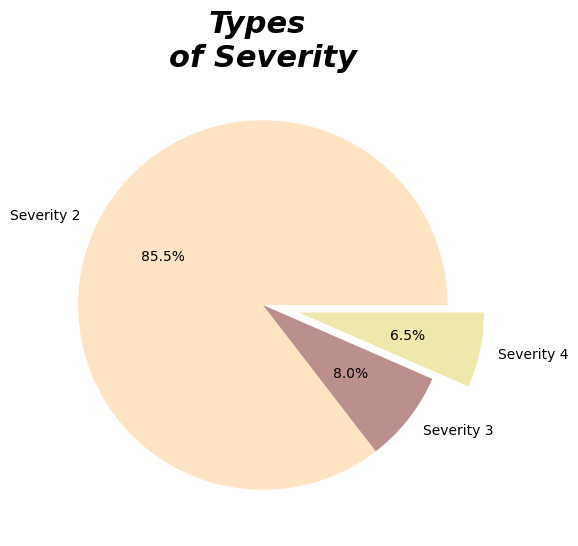

In [ ]:
data_sev = data.groupby('Severity').size()
data_sev =  data_sev[[2,3,4]]
cols = ['bisque', 'rosybrown', 'palegoldenrod']
cases = ['Severity 2','Severity 3','Severity 4']
plt.figure(figsize=(10,6))
plt.pie(data_sev,
        colors = cols,
        labels= cases,
        explode = (0,0,0.2), #moving slices apart
        autopct = ('%1.1f%%')) #to display %
plt.title('Types \nof Severity', weight='heavy', fontsize=22, style='italic');

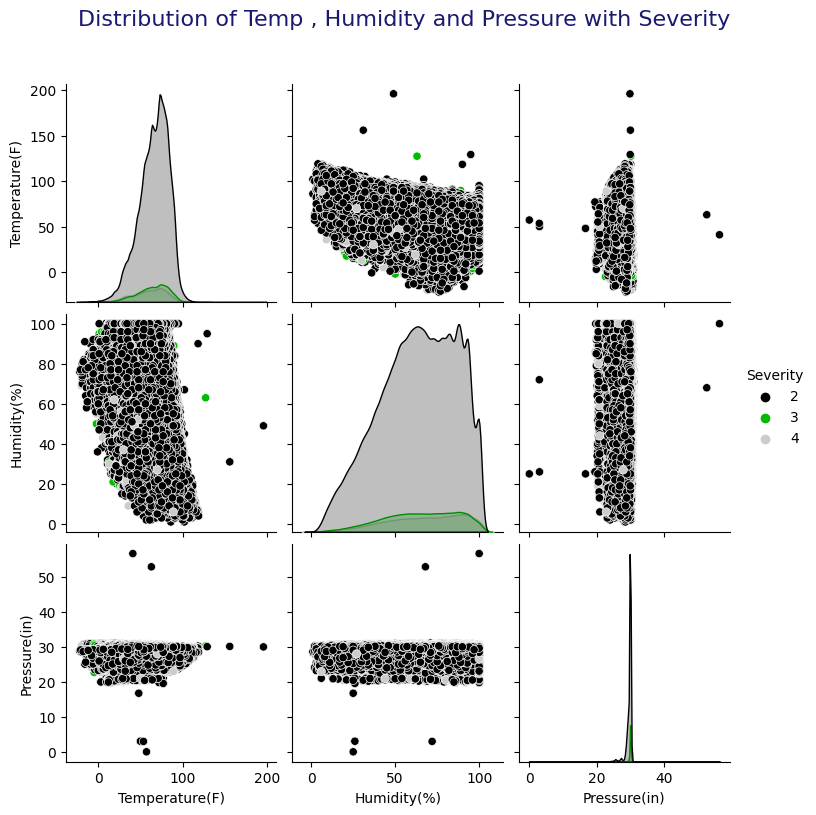

In [ ]:
pair = sns.pairplot(data[['Severity','Temperature(F)','Humidity(%)','Pressure(in)']].dropna(), hue='Severity', palette='nipy_spectral')
# pair = sns.pairplot(df[['Severity','Temperature(F)']].dropna(), hue='Severity', palette='nipy_spectral')

pair.fig.suptitle('Distribution of Temp , Humidity and Pressure with Severity', y =1.08 
                  , fontsize = 16 , color = 'MidnightBlue' , ha = 'center' , va='top')

plt.show()

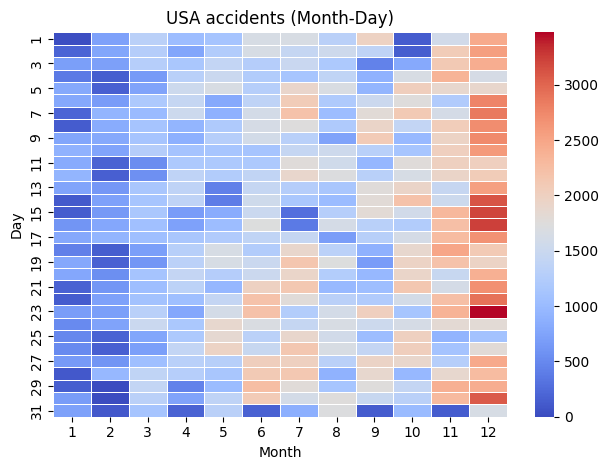

In [ ]:
data.Start_Time=pd.to_datetime(data.Start_Time)
data.End_Time=pd.to_datetime(data.End_Time)

Month_day=pd.crosstab(data['Start_Time'].dt.day, data['End_Time'].dt.month)

ax=sns.heatmap(Month_day,linewidths=.5, cmap='coolwarm')
ax.set_title("USA accidents (Month-Day)")
ax.set(xlabel='Month', ylabel='Day')
plt.tight_layout()

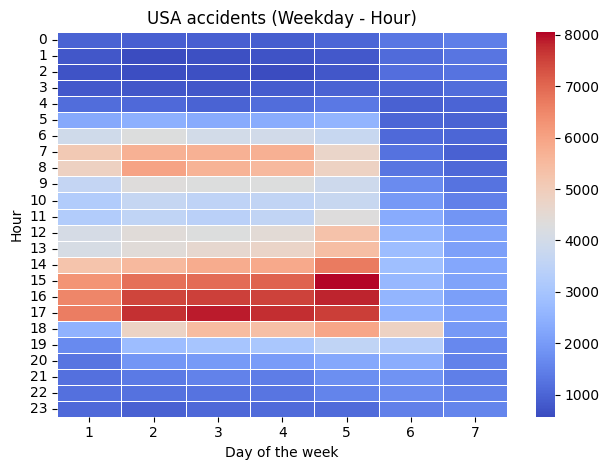

In [ ]:
Week_day=pd.crosstab(data['Start_Time'].dt.hour, data['End_Time'].dt.dayofweek+1)
ax1=sns.heatmap(Week_day,linewidths=.5, cmap='coolwarm',)
ax1.set_title("USA accidents (Weekday - Hour)")
ax1.set(xlabel='Day of the week', ylabel='Hour')
plt.tight_layout()

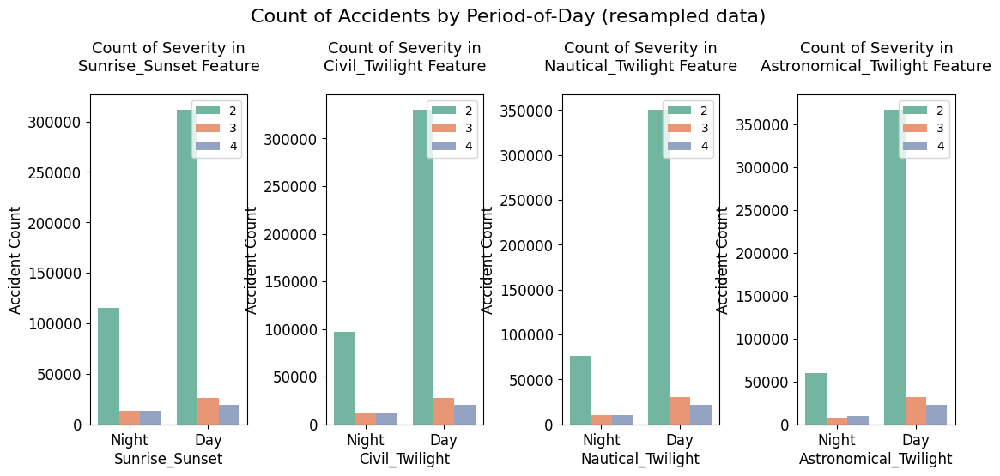

In [ ]:
period_features = ['Sunrise_Sunset','Civil_Twilight','Nautical_Twilight','Astronomical_Twilight']
fig, axs = plt.subplots(ncols=1, nrows=4, figsize=(13, 5))

plt.subplots_adjust(wspace = 0.5)
for i, feature in enumerate(period_features, 1):    
    plt.subplot(1, 4, i)
    sns.countplot(x=feature, hue='Severity', data=data ,palette="Set2")
    
    plt.xlabel('{}'.format(feature), size=12, labelpad=3)
    plt.ylabel('Accident Count', size=12, labelpad=3)    
    plt.tick_params(axis='x', labelsize=12)
    plt.tick_params(axis='y', labelsize=12)
    
    plt.legend(['2', '3','4'], loc='upper right', prop={'size': 10})
    plt.title('Count of Severity in\n{} Feature'.format(feature), size=13, y=1.05)
fig.suptitle('Count of Accidents by Period-of-Day (resampled data)',y=1.08, fontsize=16)
plt.show()

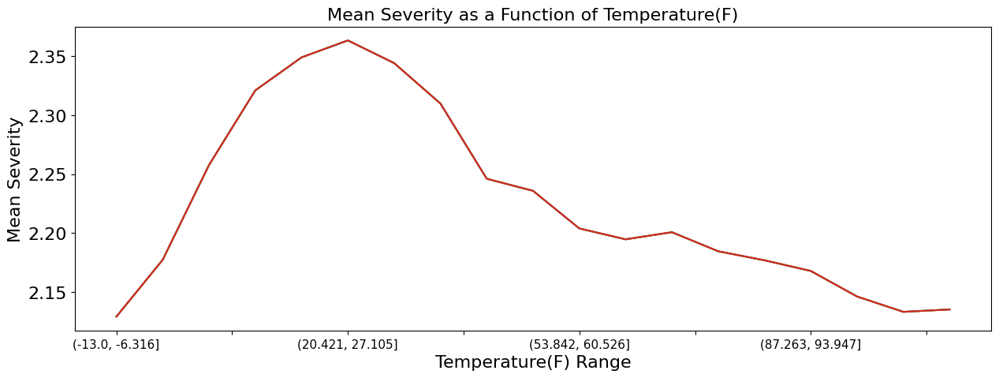

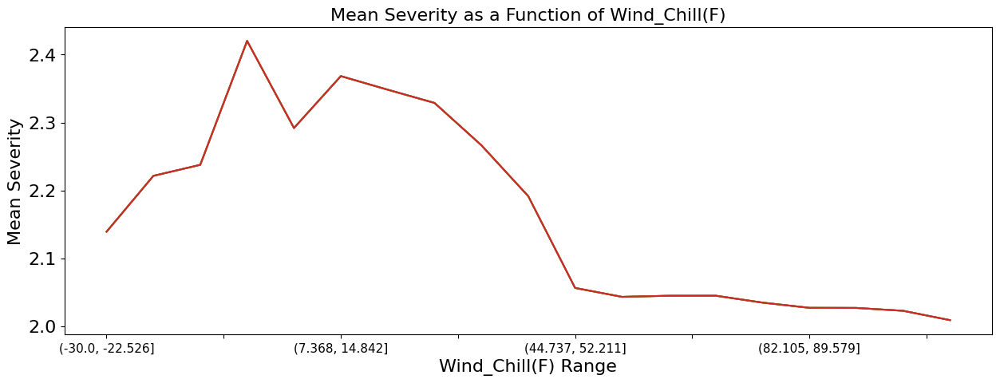

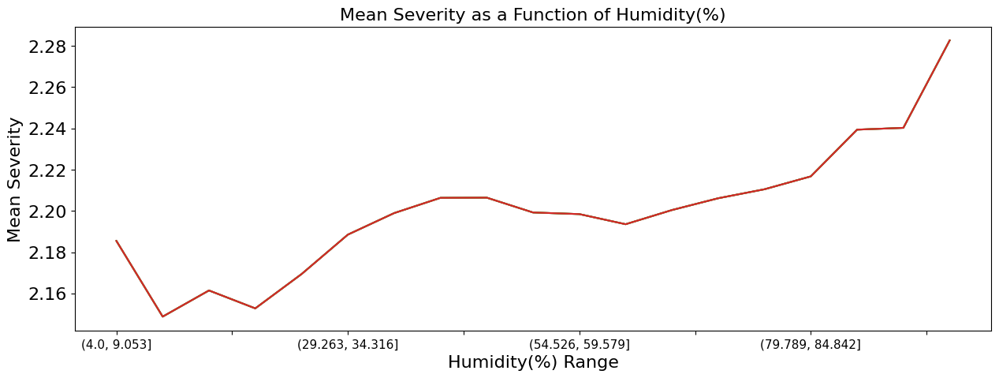

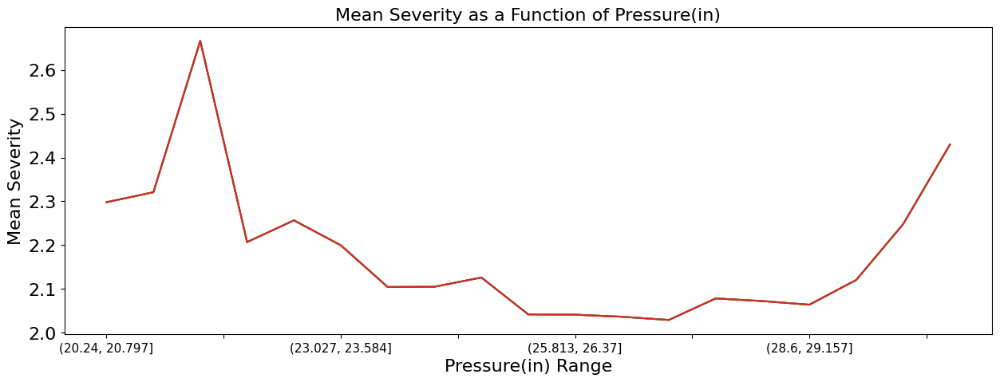

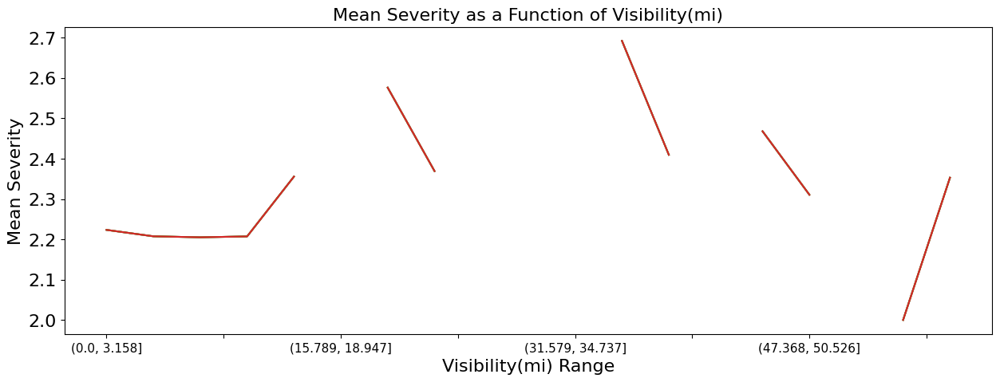

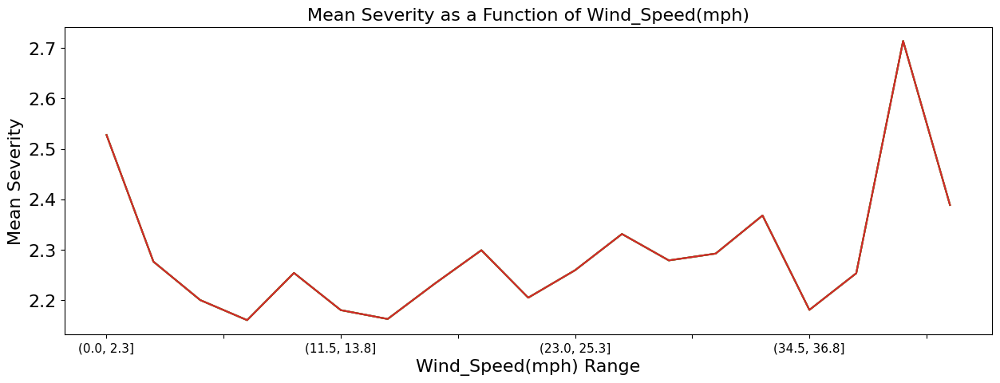

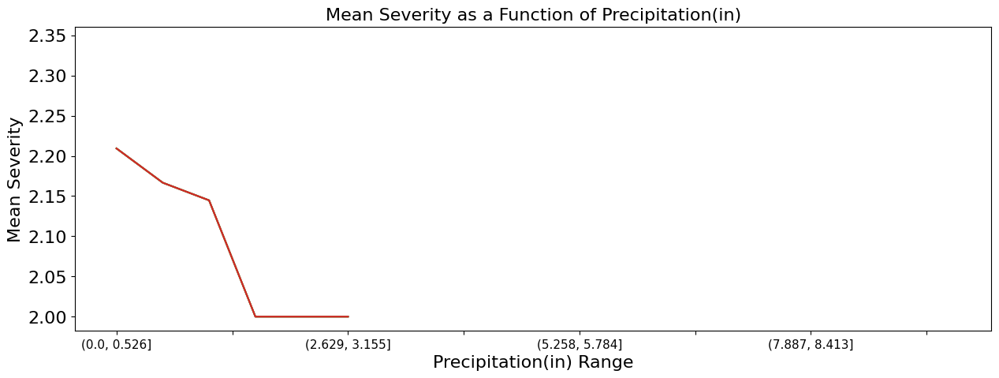

In [ ]:
factors = ['Temperature(F)','Wind_Chill(F)', 'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Speed(mph)', 'Precipitation(in)']

for factor in factors:
    # remove some of the extreme values
    factorMin = data[factor].quantile(q=0.0001)
    factorMax = data[factor].quantile(q=0.9999)
    # print df["Severity"].groupby(pd.cut(df[factor], np.linspace(factorMin,factorMax,num=20))).count()
    plt.subplots(figsize=(15,5))
    for s in np.arange(1,5):
        data["Severity"].groupby(pd.cut(data[factor], np.linspace(factorMin,factorMax,num=20))).mean().plot()
        plt.title("Mean Severity as a Function of " + factor, fontsize=16)
        plt.xlabel(factor + " Range", fontsize=16)
        plt.ylabel("Mean Severity", fontsize=16)
        plt.xticks(fontsize=11)
        plt.yticks(fontsize=16)

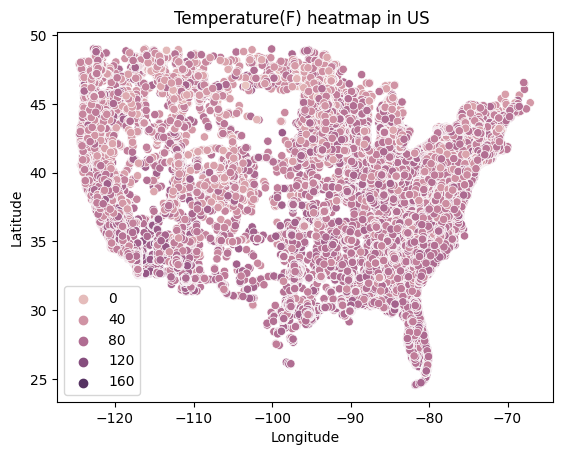

In [ ]:

sns.scatterplot(y=data.Start_Lat,x=data.Start_Lng,hue=data["Temperature(F)"])
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Temperature(F) heatmap in US ")
plt.legend()

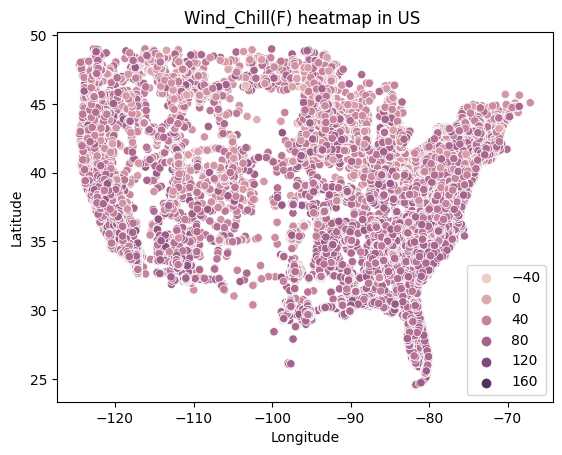

In [ ]:
sns.scatterplot(y=data.Start_Lat,x=data.Start_Lng,hue=data["Wind_Chill(F)"])
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Wind_Chill(F) heatmap in US ")
plt.legend()

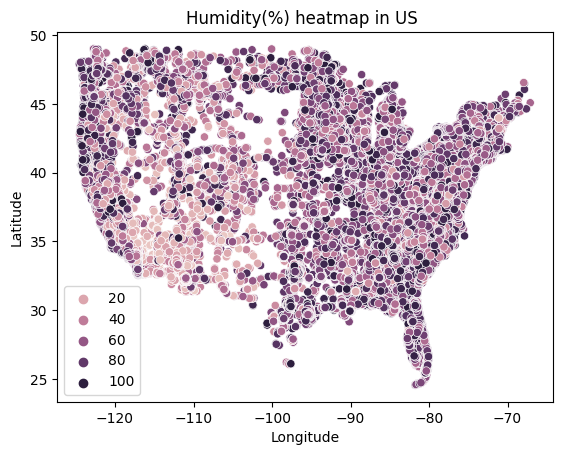

In [ ]:
sns.scatterplot(y=data.Start_Lat,x=data.Start_Lng,hue=data["Humidity(%)"])
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.title("Humidity(%) heatmap in US ")
plt.legend()